In [1]:
import ps_utils
import os
from skimage.io import imshow
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
path = r'C:\Users\tibor\Documents\semester 1\Vision and Image processing\assignments\assignment 3\DataAndCodeAssignment3'
filename ='face'

In [3]:
I_face, mask_face, S_face = ps_utils.read_data_file(os.path.join(path,filename))

In [4]:
mask_face.sum()

8064

In [5]:
S_face.shape

(27, 3)

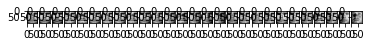

In [6]:
# show the 3 available images of the face
fig, axes = plt.subplots(1, S_face.shape[0])
ax = axes.ravel()

for i in range(S_face.shape[0]):
    ax[i].imshow(I_face[:,:,i],cmap = 'Greys_r')

# # images = data.stereo_motorcycle()
# ax[0].imshow(I_face[:,:,0],cmap = 'Greys_r')
# ax[1].imshow(I_face[:,:,1],cmap = 'Greys_r')
# ax[2].imshow(I_face[:,:,2],cmap = 'Greys_r')


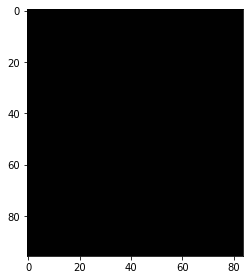

In [7]:
# show what is masked, which is nothing.
imshow(mask_face, cmap = 'Greys_r')

In [8]:
mask_face.sum() == mask_face.size #no part of the image is masked. so the masked image is identical to the unmasked image

True

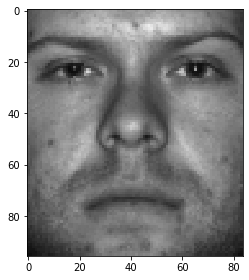

In [9]:
# show face clipped with the mask
imshow(mask_face * I_face[:,:,0])

In [10]:
mask_face_new = 1 - mask_face #take 1-mask so that the face is shown and not the background

In [11]:
mask_face.sum()

8064

In [12]:
# mask_face.count_nonzero()
np.count_nonzero(mask_face)

8064

In [13]:
for i in range(10):
    print(I_face.shape)

(96, 84, 27)
(96, 84, 27)
(96, 84, 27)
(96, 84, 27)
(96, 84, 27)
(96, 84, 27)
(96, 84, 27)
(96, 84, 27)
(96, 84, 27)
(96, 84, 27)


In [14]:
# I_face.shape[2]

In [15]:
# np.count_nonzero(mask_face), np.count_nonzero(mask_face_new)

In [16]:
# nr_of_cols = 433*650 -np.count_nonzero(mask_face_new) 

In [17]:
# mask_face_new.shape, mask_face.shape

In [18]:
nr_of_pictures = I_face.shape[2]

In [19]:
J = np.ndarray((nr_of_pictures,mask_face.size)) #create nd array with the the amount of non-zero cells
for i in range(nr_of_pictures):
    masked_I_face = np.ma.masked_array(I_face[:,:,i], mask=mask_face_new)
    compressed_I_face = masked_I_face.compressed()
    J[i] = compressed_I_face


In [20]:
J.shape

(27, 8064)

In [59]:
I_face.shape

(96, 84, 27)

In [21]:
S_face.shape

(27, 3)

In [22]:
I_face.shape

(96, 84, 27)

In [23]:
I_face[0,0,0]


79

In [71]:
# arr.reshape(-1, arr.shape[-1])

In [25]:
S_face.T.shape

(3, 27)

In [26]:
# try to implement ransac

In [27]:
# help(ps_utils.ransac_3dvector)

In [28]:
# I_face.shape[0], I_face.shape[1],3


In [74]:
help(ps_utils.ransac_3dvector)

Help on function ransac_3dvector in module ps_utils:

ransac_3dvector(data, threshold, max_data_tries=100, max_iters=1000, p=0.9, det_threshold=0.1, verbose=2)
    A RANSAC implementation for fitting a vector in a linear model I = s.m
    with I a scalar, s a 3D vector and m the vector to be fitted. 
    For us, s should represent a directional light source, I, observed 
    intensity and m = rho*n = albedo x normal
    Parameters:
    -----------
    data: tuple-like
        pair (I, S) with S the (3,K) matrix of 3D vectors and I the 
        K-vector of observations.
    threshold: float
        |I-s.m|^2 <= threshold: inlier, else outlier.
    max_data_tries: int (optional, default=100)
        maximum tries in sampling 3 vectors from S. If repeatably fail 
        to get a 3x3 submatrix with determinant large enough, then report
        an impossible match here - None instead of a (3D vector, inliers, best_fit)
    max_iters: int (optional, default=1000)
        maximum number of i

In [29]:
normal_field = np.zeros((I_face.shape[0], I_face.shape[1],3))
for i in range(I_face.shape[0]):
    for j in range(I_face.shape[1]):
        m, inliers, best_fit =ps_utils.ransac_3dvector(data =(I_face[i,j,:],S_face), threshold =10) 
        normal_field[i,j] = m

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [2, 11, 19]
ransac_3dvector(): estimated model [-110.86035702   -9.32353248   72.70085414]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [-110.21966415  -14.38166302   76.37236217]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [15, 16, 3]
ransac_3dvector(): estimated model [-116.10023023  -20.67274885   79.88835377]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-107.98008219  -27.07782034   83.64575869]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [17, 6, 0]
ransac_3dvector(): selected indices =  [4, 22, 20]
ransac_3dvector(): estimated model [-78.91482891 -31.27472755 

ransac_3dvector(), updating best model to [ -75.89994649 -124.78225771  167.55150064]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [8, 20, 13]
ransac_3dvector(): estimated model [ 20.31988476 -50.45638957 156.2245811 ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [5, 24, 8]
ransac_3dvector(): estimated model [-85.25782517 -93.19599623 153.40430245]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-77.62867277 -92.31118317 152.56813485]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [18, 9, 3]
ransac_3dvector(): estimated model [-108.77800135  -88.18179311  149.15510287]
ransac_3dvector(): number of inliers for thi

ransac_3dvector(): estimated model [  39.06083818 -160.28412369  170.41328517]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [  30.94999412 -157.1616279   171.3413054 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [4, 18, 25]
ransac_3dvector(): estimated model [ 55.09153888 -92.05696397 148.69242674]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [0, 13, 15]
ransac_3dvector(): estimated model [ 71.45131454   8.45139386 158.        ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [24, 6, 23]
ransac_3dvector(): estimated model [ 14.9966533  -92.48170147 156.30687773]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [

ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [6, 13, 18]
ransac_3dvector(): selected indices =  [19, 8, 10]
ransac_3dvector(): estimated model [ -3.06417777 -93.99047632 151.98197165]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [  4.1873847  -87.02629269 151.09515687]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [9, 17, 8]
ransac_3dvector(): estimated model [  32.47492838 -132.53563346  172.49418922]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [13, 8, 26]
ransac_3dvector(): estimated model [-9.87833207e-01  2.65380800e-02  1.17600803e+02]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [0, 3, 21]
ransac_3dvector(): estimated model

ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [10, 26, 7]
ransac_3dvector(): selected indices =  [14, 16, 6]
ransac_3dvector(): estimated model [ 19.42924511 -59.50166566 150.85719573]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [0, 22, 13]
ransac_3dvector(): selected indices =  [23, 24, 26]
ransac_3dvector(): estimated model [ 93.03151425 -85.46653768 150.81320619]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [26, 25, 10]
ransac_3dvector(): estimated model [ 115.86589678 -147.73472519  162.49175   ]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [4, 3, 0]
ransac_3dvector(): selected indices =  [15, 19, 4]
ransac_3dvector(): estimated model [ 46.74852204 -80.11629618 148.87690327]
ransac_3dvector(): number of inliers for this mo

ransac_3dvector(), updating best model to [126.04391464 -83.78412355 107.5378073 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [17, 21, 25]
ransac_3dvector(): selected indices =  [7, 15, 23]
ransac_3dvector(): estimated model [ 83.26538791 -49.56625564  95.9160634 ]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [21, 2, 19]
ransac_3dvector(): estimated model [250.58383756 -66.87743235  74.54392388]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [15, 12, 0]
ransac_3dvector(): estimated model [ 79.3415818  -69.44225413 102.        ]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [12, 6,

ransac_3dvector(), updating best model to [ -85.53019866 -100.45925474  158.39662259]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [6, 8, 3]
ransac_3dvector(): selected indices =  [4, 22, 24]
ransac_3dvector(): selected indices =  [2, 18, 22]
ransac_3dvector(): selected indices =  [22, 17, 19]
ransac_3dvector(): selected indices =  [24, 9, 23]
ransac_3dvector(): estimated model [-88.55178899 -60.91491674 150.52679133]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-84.79224529 -66.40542961 147.76091263]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [1, 20, 2]
ransac_3dvector(): estimated model [ -33.70020991 -141.41924911  118.79604637]
ransac_3dvector(): number of inliers for this model 6

ransac_3dvector(): estimated model [   0.67618495 -123.43720563  179.01386798]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [  -7.65611292 -122.15679243  180.63611552]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [13, 18, 11]
ransac_3dvector(): selected indices =  [6, 26, 2]
ransac_3dvector(): estimated model [  24.12237149 -168.49411491  187.88770281]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [26, 3, 24]
ransac_3dvector(): estimated model [  4.04618046 -87.20570098 165.82667875]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [10, 26, 25]
ransac_3dvector(): estimated model [  -9.31460703 -101.91614595  181.71823034]
ransac_3dvector(): number of inliers 

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [8, 24, 14]
ransac_3dvector(): estimated model [   2.26194632 -116.97322891  174.38232622]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [   1.88532431 -115.36444505  174.65246585]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [26, 25, 24]
ransac_3dvector(): selected indices =  [4, 7, 9]
ransac_3dvector(): selected indices =  [8, 5, 25]
ransac_3dvector(): estimated model [ 17.03261421 -99.28510887 170.44952856]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [  12.01990872 -100.3578363   168.38118953]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [4, 7, 25]
ransac_3dvector(): 

ransac_3dvector(): estimated model [  60.40166601 -117.0255243   167.04921368]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  15
ransac_3dvector(): selected indices =  [9, 11, 17]
ransac_3dvector(): estimated model [  98.96016671 -120.19381911  182.84047378]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): returning after 16 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [7, 5, 1]
ransac_3dvector(): selected indices =  [19, 23, 16]
ransac_3dvector(): selected indices =  [24, 2, 11]
ransac_3dvector(): estimated model [  57.0915161  -155.31918996  174.19257008]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [  60.15128336 -154.32317355  175.0633188 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [22, 2, 19]
ransac_3dvect

ransac_3dvector(): estimated model [ 135.93073508 -128.86019843  124.28402923]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [20, 10, 24]
ransac_3dvector(): estimated model [ 134.48808455 -149.01683302  118.24115495]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ 132.09978667 -136.1674428   119.80249738]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [13, 11, 5]
ransac_3dvector(): selected indices =  [19, 20, 21]
ransac_3dvector(): selected indices =  [3, 11, 18]
ransac_3dvector(): estimated model [105.67505316 -96.97801217 121.49550938]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [111.45939398 -92.75689584 121.13410222]
ransac_3dvect

ransac_3dvector(), updating best model to [-114.42195479  -56.84038045  122.09914371]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [18, 20, 14]
ransac_3dvector(): estimated model [-129.40837345 -101.60534008  126.39170218]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [26, 2, 20]
ransac_3dvector(): selected indices =  [15, 21, 8]
ransac_3dvector(): estimated model [-95.94822819 -46.49134554 128.8549826 ]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-103.26756411  -56.17107902  128.52876584]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [12, 14, 3]
ransac_3dvector(): estimated model [-131.74498141  -77.7076005

ransac_3dvector(): selected indices =  [9, 4, 2]
ransac_3dvector(): estimated model [ -86.63464255 -100.67706685  177.92300494]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [ -73.02214372 -100.54498255  176.75357343]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): returning after 11 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [14, 23, 17]
ransac_3dvector(): estimated model [-84.8667392  -55.3158521  180.30467249]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(), updating best model to [-85.39898205 -50.73917659 180.57226073]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [21, 1, 2]
ransac_3dvector(): estimated model [  80.18709484 -203.54457635  121.724543  ]
ransac_3dvector(): numb

ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [4, 20, 24]
ransac_3dvector(): estimated model [ -81.72968614 -155.14291961  201.41111055]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [26, 2, 19]
ransac_3dvector(): estimated model [  57.91527239 -185.85602921  171.94000207]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  13
ransac_3dvector(): selected indices =  [22, 17, 6]
ransac_3dvector(): selected indices =  [15, 20, 22]
ransac_3dvector(): estimated model [ -12.89250675 -170.52942234  177.16846023]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  14
ransac_3dvector(): selected indices =  [1, 21, 17]
ransac_3dvector(): estimated model [  22.9954106  -108.70074628  171.14336286]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating

ransac_3dvector(): estimated model [ 56.40926712 -44.20386236 209.9855183 ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [15, 0, 19]
ransac_3dvector(): estimated model [   3.13587747 -113.19148133  185.        ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [24, 15, 1]
ransac_3dvector(): estimated model [ -11.91633727 -167.62788711  198.64781514]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [18, 22, 8]
ransac_3dvector(): estimated model [ 1.68966698e-01 -1.24222085e+02  1.92901263e+02]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  13
ransac_3dvector(): selected indices =  [23, 1, 8]
ransac_3dvector(): estimated model [  79.4408459  -134.53787334  210.69159521]
ransac_3dvector(): number of inliers for this model 

ransac_3dvector(): estimated model [ 72.64775659 -92.44341754 188.07845248]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  18
ransac_3dvector(): selected indices =  [9, 7, 16]
ransac_3dvector(): estimated model [ -3.44216104  -8.85582664 172.01557816]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  19
ransac_3dvector(): selected indices =  [9, 5, 7]
ransac_3dvector(): selected indices =  [25, 2, 16]
ransac_3dvector(): estimated model [ 171.65584662 -190.893986    124.47563841]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): returning after 20 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [26, 22, 18]
ransac_3dvector(): selected indices =  [6, 4, 0]
ransac_3dvector(): selected indices =  [18, 20, 9]
ransac_3dvector(): estimated model [ 129.51751607 -150.52900752  161.97021081]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updati

ransac_3dvector(), updating best model to [117.00548495 -89.96731563 102.54156474]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [15, 9, 22]
ransac_3dvector(): estimated model [ 84.61289732 -49.8972908   93.1093235 ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [ 94.60351306 -52.41209479  91.25815671]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [16, 6, 0]
ransac_3dvector(): selected indices =  [17, 16, 7]
ransac_3dvector(): selected indices =  [26, 22, 13]
ransac_3dvector(): selected indices =  [7, 11, 3]
ransac_3dvector(): selected indices =  [19, 4, 0]
ransac_3dvector(): selected indices =  [14, 21, 1]
ransac_3dvector(): selected indices =  [12, 24, 5]
ransac_3dvector(): estimated mode

ransac_3dvector(): selected indices =  [9, 23, 17]
ransac_3dvector(): selected indices =  [20, 16, 10]
ransac_3dvector(): selected indices =  [10, 11, 16]
ransac_3dvector(): estimated model [-138.3625456   -86.38155725  134.42179939]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(), updating best model to [-153.329533    -92.77799624  133.33356633]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 361.42174407417605
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [9, 13, 20]
ransac_3dvector(): estimated model [ -82.23334354 -191.77294876  119.43700457]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [9, 7, 15]
ransac_3dvector(): estimated model [-63.27716378 -45.20975749 179.7427318 ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [14, 6, 13]
ransac_3dvector(

ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [11, 13, 2]
ransac_3dvector(): estimated model [251.54193319 -84.47301461 266.25194885]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [16, 13, 5]
ransac_3dvector(): selected indices =  [25, 11, 13]
ransac_3dvector(): estimated model [ 53.36030504  23.61185869 173.83833794]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  13
ransac_3dvector(): selected indices =  [24, 13, 5]
ransac_3dvector(): estimated model [  18.92961267 -275.44249295  157.78304241]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  14
ransac_3dvector(): selected indices =  [18, 16, 22]
ransac_3dvector(): selected indices =  [6, 23, 22]
ransac_3dvector(): estimated model [-15.02906624 -71.36754778 173.38677511]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  15
ransac_3

ransac_3dvector(), updating best model to [ 14.39877464 -83.74423439 169.61444835]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [17, 14, 8]
ransac_3dvector(): estimated model [  23.57126317 -144.9333404   192.79575098]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [7, 2, 11]
ransac_3dvector(): selected indices =  [7, 24, 23]
ransac_3dvector(): estimated model [-20.76500173 -83.40500487 186.22334636]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [22, 19, 8]
ransac_3dvector(): selected indices =  [26, 2, 17]
ransac_3dvector(): estimated model [  17.54378226 -148.31758229  193.92209981]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices

ransac_3dvector(), updating best model to [  53.6819207  -136.66727156  204.71553017]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  14
ransac_3dvector(): selected indices =  [17, 22, 20]
ransac_3dvector(): estimated model [ -20.71193372 -120.50983575  230.06135458]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  15
ransac_3dvector(): selected indices =  [12, 25, 15]
ransac_3dvector(): estimated model [ 50.44076902 -93.53627916 217.184659  ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  16
ransac_3dvector(): selected indices =  [1, 20, 4]
ransac_3dvector(): estimated model [137.32261587 -88.37172538 199.82607681]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  17
ransac_3dvector(): selected indices =  [5, 7, 2]
ransac_3dvector(): selected indices =  [15, 26, 2]
ransac_3dvector(): estimated model [

ransac_3dvector(): selected indices =  [0, 15, 11]
ransac_3dvector(): selected indices =  [4, 13, 26]
ransac_3dvector(): estimated model [110.94344919 -45.34951606 147.72765893]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  19
ransac_3dvector(): selected indices =  [15, 9, 1]
ransac_3dvector(): estimated model [ 68.88276265 -73.13143588 163.87015542]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): returning after 20 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [7, 13, 26]
ransac_3dvector(): selected indices =  [13, 3, 26]
ransac_3dvector(): estimated model [122.08154343 -63.33635834 151.81805965]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [117.01082476 -62.89955255 150.92739679]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selecte

ransac_3dvector(), updating best model to [104.56369927 -44.44621737  62.95936062]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [26, 9, 15]
ransac_3dvector(): estimated model [88.12852305  5.14061403 68.51799797]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [19, 14, 13]
ransac_3dvector(): selected indices =  [0, 8, 18]
ransac_3dvector(): selected indices =  [8, 23, 26]
ransac_3dvector(): estimated model [129.93524383 -40.06197936  59.32928695]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [124.07253722 -40.17783607  61.05282092]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selecte

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [14, 21, 10]
ransac_3dvector(): selected indices =  [23, 11, 22]
ransac_3dvector(): estimated model [-69.7693567  -38.0991189  162.21434333]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-79.37976118 -40.81764975 164.15279008]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [6, 24, 26]
ransac_3dvector(): estimated model [-90.09500243 -29.39623093 164.4869386 ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [24, 21, 3]
ransac_3dvector(): selected indices =  [18, 17, 10]
ransac_3dvector(): estimated model [-132.80254229   22.79458448  165.57639698]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  

ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [2, 11, 6]
ransac_3dvector(): estimated model [  17.98423629 -111.36254769  188.45072753]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [4, 0, 3]
ransac_3dvector(): selected indices =  [11, 17, 15]
ransac_3dvector(): selected indices =  [19, 15, 4]
ransac_3dvector(): estimated model [ -3.649276   -65.40696327 164.21358385]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [4, 15, 25]
ransac_3dvector(): estimated model [  4.68689866 -88.21847029 180.18637302]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [9, 4, 18]
ransac_3dvector(): estimated model [-58.74491223 -99.46027595 188.05797009]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  7
ransac_3dvector(

ransac_3dvector(), updating best model to [  13.51262651 -100.22533007  197.37678369]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [21, 13, 1]
ransac_3dvector(): estimated model [  73.25619921 -168.05980428  166.56527697]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [21, 3, 11]
ransac_3dvector(): estimated model [ 56.94064453 -88.23023366 187.4831336 ]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [11, 18, 2]
ransac_3dvector(): estimated model [  14.84823451 -141.66540678  182.189499  ]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [16, 17, 26]
ransac_3dvector(): estimated model [-33.82065562 -28.79385242 188.4725025 ]
ransac_3d

ransac_3dvector(): selected indices =  [20, 6, 1]
ransac_3dvector(): estimated model [188.76976546 -51.26173832 184.60020764]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [4, 21, 6]
ransac_3dvector(): estimated model [139.86451921 -75.31348345 184.57872443]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [17, 1, 23]
ransac_3dvector(): selected indices =  [2, 15, 26]
ransac_3dvector(): estimated model [ 86.27318572 -93.05762357 209.58407878]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [25, 6, 24]
ransac_3dvector(): selected indices =  [6, 11, 12]
ransac_3dvector(): estimated model [ 64.60111429 -63.2680853  175.86198797]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [18, 7, 0]


ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [0, 3, 17]
ransac_3dvector(): selected indices =  [5, 2, 3]
ransac_3dvector(): selected indices =  [25, 5, 6]
ransac_3dvector(): estimated model [136.85353764 -89.26094249 106.25888044]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [128.91470313 -93.13017066 108.08761421]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [26, 3, 14]
ransac_3dvector(): estimated model [122.77552093 -99.47964001 112.8284275 ]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [123.12223534 -91.32802498 110.89626777]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransa

ransac_3dvector(), updating best model to [-112.77373764  -65.80556194  169.34913151]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [14, 9, 24]
ransac_3dvector(): estimated model [-159.72815032   57.34898178  192.54389705]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(), updating best model to [-156.57433742   48.08199863  191.16118963]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 707.0009322972794
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [26, 5, 25]
ransac_3dvector(): estimated model [-102.53526778  -23.28574874  165.2861777 ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [-95.52793493 -32.43909626 163.04173582]
ransac_3dvector(): estimate of runs to select enough inliers wi

ransac_3dvector(): estimated model [  31.02398184 -132.45172111  179.97340816]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [  33.30069068 -124.94462126  182.5596559 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [18, 6, 16]
ransac_3dvector(): selected indices =  [13, 8, 0]
ransac_3dvector(): estimated model [ 50.3815705  -22.46263793 189.        ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [17, 24, 18]
ransac_3dvector(): selected indices =  [8, 7, 13]
ransac_3dvector(): selected indices =  [23, 14, 17]
ransac_3dvector(): estimated model [-58.90374118 -57.46649619 197.78067177]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(), updating best model to [-53.93175859 -60.98711582 197.61746569]
ransac_3dvector():

ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [22, 2, 10]
ransac_3dvector(): estimated model [  83.56667827 -139.05858726  166.41154221]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [12, 14, 8]
ransac_3dvector(): estimated model [-73.59996877 -65.34351477 134.36009169]
ransac_3dvector(): number of inliers for this model 3
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [4, 23, 22]
ransac_3dvector(): estimated model [ 59.19106476 -64.80464848 161.35028931]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  13
ransac_3dvector(): selected indices =  [5, 19, 4]
ransac_3dvector(): estimated model [-39.69936343 -98.55456179 184.98223302]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  14
ransac_3dvector(): selected indices =  [19, 10, 3]
ransac_3dvector(): selected indices =  [19, 21, 12]
ransac_3dv

ransac_3dvector(): selected indices =  [12, 2, 3]
ransac_3dvector(): estimated model [ -49.75297    -101.20762164  202.84829427]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [20, 17, 1]
ransac_3dvector(): estimated model [111.09394779 -38.01651178 219.21805347]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [12, 5, 19]
ransac_3dvector(): estimated model [ -41.68389739 -113.55416228  216.8100545 ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [11, 12, 17]
ransac_3dvector(): estimated model [112.67648559 -56.92618646 222.42662163]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [19, 20, 4]
ransac_3dvector(): selected indices =  [7, 21, 2]
ransac_3dvector(): estimated model [ 22.75466

ransac_3dvector(): estimated model [171.58300621 -96.80796339 181.52123835]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [25, 16, 5]
ransac_3dvector(): selected indices =  [25, 9, 15]
ransac_3dvector(): estimated model [150.19189347 -14.12792527 202.38137782]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  13
ransac_3dvector(): selected indices =  [14, 7, 3]
ransac_3dvector(): selected indices =  [3, 19, 22]
ransac_3dvector(): selected indices =  [22, 8, 24]
ransac_3dvector(): selected indices =  [22, 2, 23]
ransac_3dvector(): estimated model [-108.11719221  -51.45486656  218.65992385]
ransac_3dvector(): number of inliers for this model 3
ransac_3dvector(): at trial  14
ransac_3dvector(): selected indices =  [9, 7, 25]
ransac_3dvector(): estimated model [151.06416578 -31.11838442 196.21293243]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at tria

ransac_3dvector(), updating best model to [-131.20332208  -85.44547595  105.52871003]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [24, 0, 21]
ransac_3dvector(): selected indices =  [1, 11, 9]
ransac_3dvector(): estimated model [-133.4663274   -63.71864846   76.8410192 ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [1, 9, 11]
ransac_3dvector(): estimated model [-133.4663274   -63.71864846   76.8410192 ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [19, 2, 0]
ransac_3dvector(): estimated model [-40.80701283 -67.90663761  82.        ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [7, 23, 25]
ransac_3dvector(): estimated model [-140

ransac_3dvector(), updating best model to [-75.72420341 -42.90879118 176.74951998]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [3, 14, 19]
ransac_3dvector(): selected indices =  [22, 13, 14]
ransac_3dvector(): estimated model [  22.96460193 -294.41031761  192.76592638]
ransac_3dvector(): number of inliers for this model 3
ransac_3dvector(), updating best model to [  22.96460193 -294.41031761  192.76592638]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 1677.4329768527834
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [16, 2, 22]
ransac_3dvector(): estimated model [132.11566237 -99.84529885 116.52937619]
ransac_3dvector(): number of inliers for this model 3
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [21, 17, 20]
ransac_3dvector()

ransac_3dvector(): selected indices =  [24, 13, 5]
ransac_3dvector(): estimated model [  52.05643483 -337.47070997  172.12695536]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [14, 18, 25]
ransac_3dvector(): estimated model [ -1.80494894 -95.36797792 196.29559729]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ -0.60831878 -90.71313967 196.38976883]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [20, 21, 19]
ransac_3dvector(): selected indices =  [1, 7, 19]
ransac_3dvector(): estimated model [ -77.17239257 -116.15674848  206.7399998 ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [11, 17, 25]
ransac_3dvector(): estimated model [ 51.00305394  -8.66189804 187.68107

ransac_3dvector(), updating best model to [ 44.92916142 -83.25916251 209.22167837]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): returning after 14 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [12, 22, 9]
ransac_3dvector(): estimated model [ 23.79958153 -90.58228054 220.13132284]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ 22.7761207  -98.29142358 220.99460416]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [7, 12, 16]
ransac_3dvector(): estimated model [-144.59594332 -145.69345763  208.05195462]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [16, 15, 6]
ransac_3dvector(): estimated model [ 29.63854203 -48.69659511 209.97690

ransac_3dvector(): estimated model [ 97.08509158 -64.44407787 190.12447817]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [ 94.85972331 -63.66143429 187.04881842]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [6, 4, 22]
ransac_3dvector(): estimated model [ 77.03282507 -72.2375512  189.74958101]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ 72.22197737 -71.78838408 188.04609449]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [19, 11, 18]
ransac_3dvector(): estimated model [ 89.32706686 -93.0293435  189.36540361]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [20,

ransac_3dvector(), updating best model to [128.07679532 -83.84163351 105.81756544]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [17, 1, 3]
ransac_3dvector(): selected indices =  [9, 22, 4]
ransac_3dvector(): estimated model [ 77.55376925 -85.23412581 110.95411013]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [ 80.56342759 -79.78639788 109.82636641]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [16, 11, 1]
ransac_3dvector(): selected indices =  [24, 7, 26]
ransac_3dvector(): estimated model [108.60406238 -65.50657023 111.55364809]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [22, 2, 20]
ransac_3dvector(): sele

ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [24, 13, 22]
ransac_3dvector(): estimated model [-70.98604749  38.19628437 119.16481525]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [20, 3, 18]
ransac_3dvector(): selected indices =  [15, 9, 4]
ransac_3dvector(): estimated model [-118.88900349  -34.37335407  142.48361674]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-109.94600382  -35.31705548  142.71253985]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 11 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [9, 4, 1]
ransac_3dvector(): estimated model [-142.23304752  -35.72617135  143.4308696 ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [-131.42694996  -37.8556228

ransac_3dvector(), updating best model to [-90.47177933  25.44430412 204.83964255]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [16, 22, 7]
ransac_3dvector(): estimated model [-139.38367187  150.18916104  200.84760582]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [21, 24, 2]
ransac_3dvector(): selected indices =  [19, 21, 20]
ransac_3dvector(): selected indices =  [21, 13, 14]
ransac_3dvector(): estimated model [ -51.40832312 -264.90203275  159.18863978]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [6, 25, 3]
ransac_3dvector(): estimated model [-94.6800999  -33.39439902 199.44985519]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [-95.29740019 -35.80297486 

ransac_3dvector(), updating best model to [ 49.95515119 -57.06865684 198.47893312]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [2, 18, 23]
ransac_3dvector(): selected indices =  [5, 0, 11]
ransac_3dvector(): selected indices =  [19, 14, 8]
ransac_3dvector(): estimated model [-12.25671109 -20.98462065 189.29546655]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [1, 2, 4]
ransac_3dvector(): selected indices =  [13, 12, 24]
ransac_3dvector(): estimated model [ 75.71845066 -19.27842592 186.4708683 ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [21, 19, 6]
ransac_3dvector(): estimated model [  18.80652529 -115.8385705   218.87478279]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at tri

ransac_3dvector(): estimated model [  75.70717429 -160.25041904  232.68136563]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  22
ransac_3dvector(): selected indices =  [20, 25, 3]
ransac_3dvector(): estimated model [-43.57998596 -78.93260437 230.92289527]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  23
ransac_3dvector(): selected indices =  [24, 26, 6]
ransac_3dvector(): estimated model [  34.24037654 -113.07525851  214.63943526]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  24
ransac_3dvector(): selected indices =  [24, 26, 10]
ransac_3dvector(): estimated model [  81.11769885 -137.75220655  192.78018088]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  25
ransac_3dvector(): selected indices =  [23, 22, 16]
ransac_3dvector(): estimated model [ 281.01728186 -101.79876508  146.98653916]
ransac_3dvector(): number of inliers for this model 4
rans

ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [127.74430181 -60.77564592 182.55766124]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [3, 23, 10]
ransac_3dvector(): selected indices =  [22, 26, 9]
ransac_3dvector(): selected indices =  [4, 0, 11]
ransac_3dvector(): estimated model [  9.17040036 -61.93033913 163.        ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [12, 4, 22]
ransac_3dvector(): selected indices =  [23, 13, 9]
ransac_3dvector(): estimated model [123.45502159 -83.65400617 175.62945933]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [122.39887806 -83.26509267 176.14958542]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.33659427645179

ransac_3dvector(): estimated model [ 85.87700047 -46.90141278 123.14801886]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ 85.57960063 -44.52235135 123.08386816]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [22, 25, 1]
ransac_3dvector(): estimated model [ 90.04067591 -80.44359413 129.2834143 ]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [0, 7, 10]
ransac_3dvector(): selected indices =  [1, 12, 16]
ransac_3dvector(): estimated model [-170.69655001 -135.79232144  109.13812505]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [12, 22, 16]
ransac_3dvector(): estimated model [120.77422486 -12.80819509 105.40599096]
ransac_3dvector(): number of inliers for this model

ransac_3dvector(): selected indices =  [15, 10, 24]
ransac_3dvector(): estimated model [-109.00594234  -22.91940039  117.03298083]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [15, 25, 6]
ransac_3dvector(): selected indices =  [17, 5, 7]
ransac_3dvector(): selected indices =  [24, 7, 18]
ransac_3dvector(): selected indices =  [26, 13, 1]
ransac_3dvector(): estimated model [-64.7051442  -75.92940239 101.1294681 ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [23, 3, 0]
ransac_3dvector(): selected indices =  [25, 22, 14]
ransac_3dvector(): estimated model [-140.78601727  -30.98430182  140.26168599]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(), updating best model to [-139.9376201   -36.99304728  138.88425787]
ransac_3dvector(): estimate of runs to select en

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [20, 18, 3]
ransac_3dvector(): selected indices =  [21, 20, 17]
ransac_3dvector(): selected indices =  [15, 10, 3]
ransac_3dvector(): estimated model [-82.05033467  27.50130791 171.96474161]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [-75.94324515  31.56727982 170.33577028]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [6, 24, 16]
ransac_3dvector(): estimated model [-33.59802572  92.80964645 171.24330327]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [15, 2, 4]
ransac_3dvector(): estimated model [-107.56822898  -29.76278457  179.54082266]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [1, 2

ransac_3dvector(), updating best model to [ 28.61803635 -24.24822599 189.22828011]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [15, 11, 2]
ransac_3dvector(): estimated model [ 26.96574112 -24.14464366 189.40160426]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ 24.02831866 -26.23948052 189.59486818]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [9, 0, 14]
ransac_3dvector(): estimated model [ -3.50794066 -25.62897506 180.        ]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [19, 10, 5]
ransac_3dvector(): estimated model [ 30.32812793 -37.16354716 186.68550559]
ransac_3dvector(): number of inliers for this m

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [18, 11, 20]
ransac_3dvector(): estimated model [ 27.17339217 -55.59151325 193.21678712]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(), updating best model to [ 34.04603276 -41.21577074 196.14576587]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [1, 10, 25]
ransac_3dvector(): selected indices =  [6, 25, 21]
ransac_3dvector(): selected indices =  [23, 20, 18]
ransac_3dvector(): selected indices =  [21, 25, 6]
ransac_3dvector(): selected indices =  [13, 23, 17]
ransac_3dvector(): estimated model [ 189.29773787 -139.1141679   226.19322471]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [11, 25, 4]
ransac_3dvector(): estimated model [ 23.66405077 -32.58820388 187.6230755 ]
ransac_3dvector(): numbe

ransac_3dvector(): selected indices =  [18, 17, 1]
ransac_3dvector(): selected indices =  [9, 19, 14]
ransac_3dvector(): estimated model [ 62.38549601 -36.8091253  159.29004904]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [21, 10, 24]
ransac_3dvector(): estimated model [117.27189744 -85.62299854 167.09417785]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [18, 20, 14]
ransac_3dvector(): estimated model [  81.12707041 -129.56888573  142.07080685]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [16, 5, 7]
ransac_3dvector(): selected indices =  [1, 17, 5]
ransac_3dvector(): selected indices =  [8, 11, 13]
ransac_3dvector(): selected indices =  [24, 4, 22]
ransac_3dvector(): selected indices =  [2, 14, 23]
ransac_3dvector(): estimated model [ 65.34064662 -3

ransac_3dvector(): selected indices =  [16, 20, 10]
ransac_3dvector(): selected indices =  [18, 9, 22]
ransac_3dvector(): selected indices =  [13, 2, 17]
ransac_3dvector(): estimated model [155.4545134  -56.73275637 104.48758974]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(), updating best model to [141.92895618 -53.70447091 104.40227649]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [10, 9, 3]
ransac_3dvector(): selected indices =  [16, 17, 6]
ransac_3dvector(): selected indices =  [23, 5, 14]
ransac_3dvector(): estimated model [106.1536829  -81.53858049  85.57305112]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [113.3355884  -83.17710319  88.56284253]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  2
r

ransac_3dvector(), updating best model to [-52.33612245 -48.41776512 137.7845329 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [9, 18, 5]
ransac_3dvector(): selected indices =  [25, 23, 21]
ransac_3dvector(): estimated model [-95.61897036 -25.58088508 152.10954912]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [22, 8, 4]
ransac_3dvector(): estimated model [-66.06598307 -53.64902346 148.65593822]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [2, 17, 9]
ransac_3dvector(): estimated model [ -5.17892959 -56.25471316 145.97782626]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [26, 8, 11]
ransac_3dvector(): selected indices =  [24, 1

ransac_3dvector(), updating best model to [-52.34269248  -9.00539174 192.2069014 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [4, 23, 22]
ransac_3dvector(): estimated model [  2.82529558 -24.31926753 181.83310393]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [4, 17, 11]
ransac_3dvector(): estimated model [-29.42233265 -58.13811027 205.51331255]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [21, 23, 11]
ransac_3dvector(): estimated model [-44.32584804 -16.87327455 192.34580853]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [7, 11, 5]
ransac_3dvector(): selected indices =  [18, 9, 7]
ransac_3dvector(): estimated model [-129.5723

ransac_3dvector(): selected indices =  [23, 7, 10]
ransac_3dvector(): selected indices =  [25, 5, 20]
ransac_3dvector(): selected indices =  [5, 14, 22]
ransac_3dvector(): estimated model [ -8.55731002  95.87135735 209.88863415]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  20
ransac_3dvector(): selected indices =  [16, 2, 0]
ransac_3dvector(): selected indices =  [26, 11, 22]
ransac_3dvector(): estimated model [  81.64499189 -132.31674657  219.87563943]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  21
ransac_3dvector(): selected indices =  [18, 2, 25]
ransac_3dvector(): estimated model [ 23.42240453 -17.02056759 197.93989389]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ 26.22444316 -16.46242346 198.73588669]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): returning after 22 iterations.
r

ransac_3dvector(): estimated model [109.04791923 -43.60579555 199.        ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [14, 17, 0]
ransac_3dvector(): selected indices =  [22, 18, 0]
ransac_3dvector(): selected indices =  [26, 9, 18]
ransac_3dvector(): selected indices =  [4, 12, 14]
ransac_3dvector(): estimated model [ 29.90285581 -17.55472751 180.75884578]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [ 27.25441901  -9.22401162 180.34008393]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): returning after 11 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [2, 25, 1]
ransac_3dvector(): estimated model [ 23.64004562 -11.8836562  169.13567978]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [ 28.1296694  -

ransac_3dvector(), updating best model to [ 65.58218204 -41.53289594 134.98644083]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [1, 26, 20]
ransac_3dvector(): estimated model [110.46874287 -77.50462389 120.77551203]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [19, 4, 7]
ransac_3dvector(): estimated model [ 75.78276275 -56.82311472 136.22916578]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [1, 3, 17]
ransac_3dvector(): selected indices =  [3, 25, 15]
ransac_3dvector(): estimated model [ 61.3173123  -18.64627615 129.16713333]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [21, 2, 23]
ransac_3dvector(): estimated model [150.0772913

ransac_3dvector(), updating best model to [ 97.24929891 -54.58864947  53.85115467]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [14, 5, 20]
ransac_3dvector(): estimated model [ 104.1556249  -164.93540711   27.82613611]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [18, 13, 14]
ransac_3dvector(): estimated model [ 90.27716047 -57.86789283  53.13071047]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [10, 24, 15]
ransac_3dvector(): estimated model [97.67713179 23.61142102 66.99695315]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [13, 15, 17]
ransac_3dvector(): estimated model [75.51904687 35.38838327 46.24888908]
ransac_3dvector(): nu

ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [24, 20, 14]
ransac_3dvector(): estimated model [-78.6311782  -54.61708646 155.83113581]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-78.33827029 -54.5047774  155.57999517]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [0, 13, 9]
ransac_3dvector(): estimated model [ -13.58706304 -100.145877    136.        ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [18, 15, 23]
ransac_3dvector(): estimated model [-75.98000169 -15.90354143 147.43363706]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [15, 6, 16]
ransac_3dvector(): estimated model [-47.79478354  42.60162652 141.17379466]
ransac_3dvector(

ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [17, 16, 14]
ransac_3dvector(): estimated model [-88.03902832 149.72803256 176.90710944]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [24, 3, 15]
ransac_3dvector(): estimated model [-20.25917272  51.34337222 176.05707315]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [3, 21, 2]
ransac_3dvector(): estimated model [-24.87401404  17.3205329  188.44037395]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-24.92099346  19.83713751 186.03278634]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [15, 0, 19]
ransac_3dvector(): estimated model [-35.91453535  58.30914266 162.        ]
ransac_3dvector(): n

ransac_3dvector(): selected indices =  [7, 13, 3]
ransac_3dvector(): selected indices =  [24, 11, 17]
ransac_3dvector(): selected indices =  [3, 20, 18]
ransac_3dvector(): selected indices =  [20, 16, 10]
ransac_3dvector(): selected indices =  [18, 25, 22]
ransac_3dvector(): estimated model [ 72.84391938  91.38878271 181.1021345 ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(), updating best model to [ 79.59336109  92.64612077 176.83474388]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [5, 23, 22]
ransac_3dvector(): estimated model [103.19036307 -17.32331592 190.45602417]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [7, 6, 13]
ransac_3dvector(): selected indices =  [16, 1, 0]
ransac_3dvector(): selected indices =  [10, 16, 19]
ransac_3dvector(): estimated mode

ransac_3dvector(), updating best model to [ 48.98876437 -36.02745615 128.71868133]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [22, 17, 16]
ransac_3dvector(): selected indices =  [10, 1, 6]
ransac_3dvector(): estimated model [ 26.83007019 -55.26782952 116.09891002]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [2, 23, 11]
ransac_3dvector(): estimated model [ 45.23031361 -21.09310819 127.39931586]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [21, 1, 13]
ransac_3dvector(): estimated model [ 78.68978715 -21.81699625 128.27401764]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [20, 23, 24]
ransac_3dvector(): estimated model [-10.066

ransac_3dvector(), updating best model to [112.06728712 -55.54298866  53.8705948 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [2, 5, 23]
ransac_3dvector(): estimated model [148.27835504 -60.33797145  47.14225929]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [13, 14, 25]
ransac_3dvector(): estimated model [106.49198742 -76.69931456  59.58843054]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [26, 22, 4]
ransac_3dvector(): estimated model [131.47964617 -14.81664902  26.24479899]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [24, 5, 8]
ransac_3dvector(): estimated model [-85.7754193

ransac_3dvector(): estimated model [-43.89268913  39.69491611  72.21624811]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [2, 17, 15]
ransac_3dvector(): estimated model [-49.27228687 -25.5594833  115.86187293]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-50.32649098 -24.54878844 115.82232123]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [14, 18, 24]
ransac_3dvector(): selected indices =  [13, 2, 23]
ransac_3dvector(): estimated model [ 34.10916488 -32.83224625 108.58910999]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [23, 18, 24]
ransac_3dvector(): estimated model [-19.907006     5.10946994 115.20706957]
r

ransac_3dvector(): selected indices =  [10, 20, 3]
ransac_3dvector(): estimated model [ 80.19626077  17.7401682  198.92941691]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [22, 14, 21]
ransac_3dvector(): estimated model [ 33.07119702 -25.91446717 206.78344074]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [4, 12, 9]
ransac_3dvector(): estimated model [ 52.57958214  -6.61853418 188.97131043]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [18, 15, 6]
ransac_3dvector(): selected indices =  [5, 4, 0]
ransac_3dvector(): selected indices =  [8, 9, 7]
ransac_3dvector(): selected indices =  [12, 18, 6]
ransac_3dvector(): selected indices =  [17, 3, 20]
ransac_3dvector(): selected indices =  [14, 7, 22]
ransac_3dvector(): selected indices =  [17, 0, 24]
ransac_3d

ransac_3dvector(), updating best model to [-129.71865582  -16.64350236  100.21747205]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 208.66965671577267
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [0, 22, 4]
ransac_3dvector(): estimated model [ 48.6686555   13.61315929 104.        ]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ 48.03807036  12.93355698 106.95514453]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [3, 14, 21]
ransac_3dvector(): estimated model [ 2.85554889e+01 -7.40067305e-02  1.16022313e+02]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [ 29.39224972   2.17185628 114.70763569]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvect

ransac_3dvector(): selected indices =  [2, 11, 5]
ransac_3dvector(): estimated model [-21.27748645  14.86371293  62.94697405]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [ 7.62060436 23.39063472 70.56203607]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [20, 21, 25]
ransac_3dvector(): selected indices =  [7, 18, 6]
ransac_3dvector(): selected indices =  [16, 20, 12]
ransac_3dvector(): selected indices =  [7, 21, 18]
ransac_3dvector(): selected indices =  [17, 13, 22]
ransac_3dvector(): selected indices =  [22, 19, 13]
ransac_3dvector(): estimated model [83.80084241 32.9738003  85.41884717]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [82.16813825 34.41396064 84.88113523]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.41429

ransac_3dvector(), updating best model to [-53.77851493   9.83461105  73.84676106]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [25, 10, 22]
ransac_3dvector(): estimated model [-48.60047977  10.76781996  72.94012402]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [-50.70696522   5.47885653  71.72099515]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [1, 3, 26]
ransac_3dvector(): estimated model [-33.85041224  -5.8476088   69.17155521]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [20, 18, 2]
ransac_3dvector(): selected indices =  [15, 1, 18]
ransac_3dvector(): estim

ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [18, 24, 6]
ransac_3dvector(): selected indices =  [1, 8, 25]
ransac_3dvector(): estimated model [ 22.90713809  63.34522103 181.61826304]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [21, 18, 11]
ransac_3dvector(): selected indices =  [6, 18, 21]
ransac_3dvector(): selected indices =  [23, 20, 22]
ransac_3dvector(): selected indices =  [25, 4, 2]
ransac_3dvector(): estimated model [  0.99744943   5.50600965 178.04006426]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ 11.06247591  11.21185563 179.03826345]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [4, 9, 5]
ransac_3dvector(): estimated model [ -7.14560965  15.17984349 171.26637288]
ransac_3dvector(): number of 

ransac_3dvector(): estimated model [78.39988906  6.39672427 89.52060878]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [6, 5, 21]
ransac_3dvector(): estimated model [ 7.99190839 14.39692621 78.67606269]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [20, 8, 11]
ransac_3dvector(): estimated model [29.59120092 16.99535831 78.90048438]
ransac_3dvector(): number of inliers for this model 24
ransac_3dvector(), updating best model to [29.49923088 13.4792783  76.58621894]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 1.9001732777665916
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [6, 18, 19]
ransac_3dvector(): selected indices =  [19, 12, 1]
ransac_3dvector(): estimated model [33.58697635  6.63909388 71.58798776]
ransac_3dvector(

ransac_3dvector(): estimated model [ -3.50205776 -17.08441825  95.94284645]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [9, 6, 7]
ransac_3dvector(): selected indices =  [22, 10, 5]
ransac_3dvector(): selected indices =  [1, 0, 24]
ransac_3dvector(): estimated model [133.08243076  49.01206792 120.        ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [26, 11, 3]
ransac_3dvector(): selected indices =  [14, 2, 16]
ransac_3dvector(): estimated model [ 71.37255599  46.77197182 101.92630076]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [16, 4, 13]
ransac_3dvector(): estimated model [71.91469938 30.39647175 89.80664892]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best mo

ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [-42.97672164  21.57003148  92.39441223]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [16, 25, 17]
ransac_3dvector(): estimated model [ -2.54444374 123.81356539  75.14155516]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [26, 6, 18]
ransac_3dvector(): estimated model [-38.19366739  54.00181814  76.79901027]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-38.05092706  53.19049594  75.89320462]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [23, 5, 4]
ransac_3dvector(): estimated model [-44.47828092  45.56288828  75.52468

ransac_3dvector(): estimated model [  2.95783445  72.12466842 141.50825656]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [18, 8, 14]
ransac_3dvector(): estimated model [  7.35454462  26.70860976 179.44913227]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [  5.9370217   27.26736917 177.15298497]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [19, 8, 11]
ransac_3dvector(): selected indices =  [23, 5, 18]
ransac_3dvector(): estimated model [ 21.04567333  28.07766399 177.03501688]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [ 24.27305267  20.52566458 177.77331497]
ransac_3dvector(): estimate of runs to select enough inliers with probability 

ransac_3dvector(): estimated model [130.09148391 206.88923076 108.29103273]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [17, 20, 1]
ransac_3dvector(): estimated model [ 84.29944829 209.90109672 109.38726229]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [20, 19, 17]
ransac_3dvector(): selected indices =  [8, 26, 22]
ransac_3dvector(): estimated model [113.08499876 139.82434242  92.5313076 ]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [7, 19, 13]
ransac_3dvector(): selected indices =  [23, 19, 0]
ransac_3dvector(): selected indices =  [4, 11, 9]
ransac_3dvector(): estimated model [  8.08751178 121.01063174  76.40968917]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [4, 16

ransac_3dvector(), updating best model to [99.46018125 11.86907749 95.61861512]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [10, 9, 25]
ransac_3dvector(): estimated model [126.14984008  29.55345795 103.32882649]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [3, 16, 25]
ransac_3dvector(): estimated model [183.54939595  59.67753113  72.99097676]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [21, 22, 6]
ransac_3dvector(): estimated model [121.50746065 -34.5526229   96.25217697]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [7, 21, 19]
ransac_3dvector(): estimated model [136.26523582  

ransac_3dvector(): estimated model [-107.49426407  174.28428875  129.4133153 ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [3, 18, 24]
ransac_3dvector(): selected indices =  [10, 24, 1]
ransac_3dvector(): estimated model [-65.06480105 184.01323314 132.95436147]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [2, 3, 4]
ransac_3dvector(): selected indices =  [3, 25, 12]
ransac_3dvector(): selected indices =  [12, 15, 14]
ransac_3dvector(): estimated model [-79.03075619  81.9480006   95.32392345]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [4, 14, 11]
ransac_3dvector(): selected indices =  [5, 10, 23]
ransac_3dvector(): estimated model [-96.13470822 122.74247518 110.14879571]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at 

ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [18, 21, 11]
ransac_3dvector(): selected indices =  [21, 16, 23]
ransac_3dvector(): estimated model [136.41310823  22.83530944 148.06098376]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [2, 25, 1]
ransac_3dvector(): estimated model [ 49.24925558 -36.430669   143.17445342]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [18, 9, 11]
ransac_3dvector(): estimated model [ 41.81959433  16.96561174 178.44914717]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [ 40.39182572  23.28199489 179.19770362]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [1, 15, 24]
ransac_3dvector(): estimated model [ 27.92138

ransac_3dvector(): estimated model [-111.3370371   198.67758167   93.71876715]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [1, 26, 16]
ransac_3dvector(): selected indices =  [17, 1, 8]
ransac_3dvector(): estimated model [253.61655442 195.70774224 104.22130374]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [22, 15, 6]
ransac_3dvector(): selected indices =  [19, 11, 21]
ransac_3dvector(): estimated model [ 76.98544248  80.22284889 118.86538729]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ 77.61421188  84.40029085 119.10997412]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [25, 18, 0]
ransac_3dvector(): selected indices =  [18, 16, 21]
ransac_3dvector():

ransac_3dvector(), updating best model to [180.07597939  -2.86074     60.4749998 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [8, 18, 6]
ransac_3dvector(): selected indices =  [21, 18, 11]
ransac_3dvector(): selected indices =  [3, 17, 10]
ransac_3dvector(): selected indices =  [25, 14, 11]
ransac_3dvector(): estimated model [125.44395128  -4.69730211 102.73019174]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [8, 3, 20]
ransac_3dvector(): estimated model [ 23.04569306 -39.72730479  86.82364496]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [4, 8, 21]
ransac_3dvector(): estimated model [ 93.65262858 -15.85066481  90.44910325]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating

ransac_3dvector(), updating best model to [-22.39834424  93.33229409 108.23817191]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [24, 19, 3]
ransac_3dvector(): selected indices =  [0, 13, 5]
ransac_3dvector(): selected indices =  [1, 10, 20]
ransac_3dvector(): selected indices =  [6, 22, 25]
ransac_3dvector(): estimated model [-13.3518092  203.90631272  96.26934878]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [11, 5, 19]
ransac_3dvector(): estimated model [-76.1771149  137.12827642 103.22879405]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [7, 2, 21]
ransac_3dvector(): estimated model [-61.40717182  84.98788691 116.10058528]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at tria

ransac_3dvector(): selected indices =  [26, 4, 21]
ransac_3dvector(): estimated model [  1.88685128  27.25252685 176.24150947]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ -6.12569852  30.72403733 175.47001188]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [0, 19, 14]
ransac_3dvector(): estimated model [-36.44670035  43.94401363 162.        ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [-28.95786093  37.88863509 162.43160188]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [3, 15, 5]
ransac_3dvector(): estimated model [ -4.38217086  22.3467146  172.77668237]
ransac_3dvector(): number of inlier

ransac_3dvector(), updating best model to [62.50550797 98.1544018  68.33136703]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [14, 1, 10]
ransac_3dvector(): selected indices =  [3, 17, 14]
ransac_3dvector(): estimated model [64.12566537 67.54952579 93.53771602]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [62.10879104 64.43632787 92.95992424]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [6, 8, 9]
ransac_3dvector(): selected indices =  [4, 1, 0]
ransac_3dvector(): selected indices =  [10, 6, 21]
ransac_3dvector(): estimated model [74.2227199  94.54723071 81.49622135]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [74.93339708 90.70808845 

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [18, 15, 6]
ransac_3dvector(): selected indices =  [2, 26, 6]
ransac_3dvector(): estimated model [121.53322158  44.57720279 139.32951147]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [115.17462111  41.54916663 138.72521195]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [12, 13, 10]
ransac_3dvector(): selected indices =  [17, 18, 0]
ransac_3dvector(): selected indices =  [9, 0, 24]
ransac_3dvector(): estimated model [100.69313229   0.4052981  134.        ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [12, 18, 20]
ransac_3dvector(): selected indices =  [2, 18, 0]
ransac_3dvector(): estimated model [ 86.58749719  39.24769132 134.        ]
ransac_3dvector(): number of

ransac_3dvector(): estimated model [-84.04862113  62.00960387 153.93348543]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [11, 26, 25]
ransac_3dvector(): estimated model [-48.29784875  60.6418484  147.17887902]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [16, 12, 25]
ransac_3dvector(): estimated model [-35.37298415  61.00718203 138.24829406]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [10, 26, 9]
ransac_3dvector(): estimated model [-27.88779144  15.91008733 152.7630702 ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [18, 14, 21]
ransac_3dvector(): estimated model [-74.54005565 -47.25564005 152.25686878]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector

ransac_3dvector(), updating best model to [-19.66874504 111.10139787 100.69491981]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [20, 9, 16]
ransac_3dvector(): selected indices =  [19, 23, 10]
ransac_3dvector(): estimated model [-29.15407568  67.05286409 103.54667824]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [-34.48554068  67.53490392 104.6796445 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [12, 3, 9]
ransac_3dvector(): estimated model [-18.54329704  67.45062628 105.27966799]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [10, 21, 19]
ransac_3dvector(): esti

ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [16, 6, 5]
ransac_3dvector(): selected indices =  [19, 7, 24]
ransac_3dvector(): estimated model [ 69.44993198  69.37448217 119.88111768]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 66.25938521  69.1458404  121.05200615]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [3, 18, 1]
ransac_3dvector(): estimated model [ 45.28048821  67.2475012  113.86702165]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [ 54.21416105  67.28108505 115.0526337 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [21, 4, 16]
ransac_3dvector(): estima

ransac_3dvector(), updating best model to [101.98517724  46.29336123 126.84559411]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [11, 9, 7]
ransac_3dvector(): selected indices =  [8, 14, 9]
ransac_3dvector(): estimated model [166.84713797  50.72239341 166.27901109]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [14, 4, 13]
ransac_3dvector(): selected indices =  [19, 1, 18]
ransac_3dvector(): selected indices =  [18, 15, 23]
ransac_3dvector(): estimated model [ 34.59659649  60.78202165 140.12111871]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [ 37.88309385  61.3727161  139.81465323]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  3
ransac_3dvector(): sele

ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [8, 5, 19]
ransac_3dvector(): estimated model [104.18204426  33.74069777 113.95949043]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [108.88269305  32.91641855 113.88369156]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [9, 8, 14]
ransac_3dvector(): estimated model [104.39686554  33.06463658 114.24723134]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [15, 5, 24]
ransac_3dvector(): estimated model [132.93554549  64.66884646 104.62120286]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [128.02516318  61.61180823 105.470

ransac_3dvector(): selected indices =  [25, 24, 8]
ransac_3dvector(): selected indices =  [5, 8, 12]
ransac_3dvector(): selected indices =  [17, 21, 9]
ransac_3dvector(): estimated model [-45.57630312  57.75959569 152.77557006]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [20, 16, 24]
ransac_3dvector(): selected indices =  [6, 22, 21]
ransac_3dvector(): estimated model [-46.18089144  37.43200814 152.42307083]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [-39.81582059  43.28488459 149.38800634]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [4, 22, 0]
ransac_3dvector(): estimated model [  2.80636308  61.9102041  130.        ]
ransac_3dvector(): number of inliers for this model 12
ransac

ransac_3dvector(), updating best model to [-54.23123189 159.89159627  83.95646455]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [18, 6, 21]
ransac_3dvector(): selected indices =  [9, 13, 18]
ransac_3dvector(): estimated model [-26.7498352   94.45167216  75.79658051]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-31.81062265 101.3821112   76.95025407]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [5, 14, 2]
ransac_3dvector(): estimated model [-23.46717616  30.09622444  65.4515635 ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [20, 10, 2]
ransac_3dvector(): estimated model [-50.60570071  21.59756123  56.9529002

ransac_3dvector(), updating best model to [100.38117265  72.71673216 143.94512201]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [2, 21, 24]
ransac_3dvector(): selected indices =  [8, 12, 1]
ransac_3dvector(): selected indices =  [2, 19, 20]
ransac_3dvector(): estimated model [193.22618803  43.11913906 111.00139006]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [26, 3, 21]
ransac_3dvector(): estimated model [118.38285262  46.46069718 134.20293285]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [119.58548357  45.7312035  131.8694476 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [17, 16, 1]
ransac_3dvector(): sele

ransac_3dvector(): selected indices =  [12, 25, 18]
ransac_3dvector(): estimated model [-32.92410327   1.64050504 144.91885355]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  15
ransac_3dvector(): selected indices =  [13, 15, 26]
ransac_3dvector(): estimated model [ 23.19171659  49.29262837 147.633337  ]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  16
ransac_3dvector(): selected indices =  [21, 18, 1]
ransac_3dvector(): selected indices =  [6, 25, 26]
ransac_3dvector(): estimated model [  9.5063507   83.54056849 141.99869638]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  17
ransac_3dvector(): selected indices =  [4, 0, 5]
ransac_3dvector(): selected indices =  [16, 9, 18]
ransac_3dvector(): selected indices =  [2, 0, 15]
ransac_3dvector(): estimated model [-28.63788235  65.81623382 104.        ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial

ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [21, 15, 11]
ransac_3dvector(): selected indices =  [2, 0, 14]
ransac_3dvector(): estimated model [ 95.78361819  35.46089476 109.        ]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [100.97078957  39.27632623 111.64658832]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [17, 16, 20]
ransac_3dvector(): selected indices =  [15, 3, 25]
ransac_3dvector(): estimated model [ 99.41796365 -18.92946134 137.78362649]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [12, 3, 11]
ransac_3dvector(): estimated model [110.56513149  17.71311665 124.4468188 ]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [20, 

ransac_3dvector(): estimated model [-55.32612947  66.53381038 156.77447499]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): returning after 16 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [13, 21, 19]
ransac_3dvector(): estimated model [-10.61020556  21.63708082 147.31853271]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [-16.0680476   17.92181892 147.66415251]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [22, 6, 13]
ransac_3dvector(): selected indices =  [16, 18, 7]
ransac_3dvector(): selected indices =  [11, 25, 22]
ransac_3dvector(): estimated model [-10.39118079  96.66776974 133.68446258]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [11, 22, 20]
ransac_3dvector(): esti

ransac_3dvector(), updating best model to [-63.20639043 102.25046188  77.41710823]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [12, 7, 5]
ransac_3dvector(): selected indices =  [1, 5, 15]
ransac_3dvector(): selected indices =  [20, 11, 6]
ransac_3dvector(): estimated model [-44.49588405 121.28509916  92.8790125 ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-52.96274466 124.93098315  89.97513738]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [20, 15, 10]
ransac_3dvector(): estimated model [-25.71790978 156.14799049 100.98414557]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [26, 0, 24]
ransac_3dvector(): estim

ransac_3dvector(): estimated model [102.74319355  63.58212922 101.70394309]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [8, 19, 20]
ransac_3dvector(): estimated model [104.18204426  62.1342623  103.46565313]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [106.71045431  65.89646063 103.5578967 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [14, 6, 0]
ransac_3dvector(): estimated model [ 70.1352882   62.85007721 100.        ]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [11, 13, 3]
ransac_3dvector(): selected indices =  [10, 4, 17]
ransac_3dvector(): estimated model [150.56245463  39.82832316 117.38408395]
ran

ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [23, 10, 3]
ransac_3dvector(): selected indices =  [0, 10, 13]
ransac_3dvector(): selected indices =  [10, 23, 14]
ransac_3dvector(): estimated model [ 311.88342606 -294.96226805  204.04885203]
ransac_3dvector(): number of inliers for this model 3
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [24, 8, 14]
ransac_3dvector(): estimated model [ 27.6852886  -19.30202341  95.22117397]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [14, 0, 5]
ransac_3dvector(): selected indices =  [12, 1, 21]
ransac_3dvector(): estimated model [ 13.89484165 -30.78985384 104.78878688]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  13
ransac_3dvector(): selected indices =  [9, 19, 7]
ransac_3dvector(): selected indices =  [2, 7, 18]
ransac_3dvector(): estimated model [-80.62278676  79.35094961 107.63522

ransac_3dvector(), updating best model to [155.99250728  43.44968024 110.3810576 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [23, 2, 0]
ransac_3dvector(): estimated model [199.89237066  29.87510832 102.        ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [26, 0, 1]
ransac_3dvector(): estimated model [183.00442054  28.79551837 102.        ]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [2, 5, 7]
ransac_3dvector(): selected indices =  [24, 10, 18]
ransac_3dvector(): selected indices =  [18, 10, 20]
ransac_3dvector(): estimated model [130.14029121  38.05070777 117.18162782]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [125.55953108  38.16910137 117.050

ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [19, 12, 9]
ransac_3dvector(): estimated model [ 18.70407912 -49.13384071 113.19519288]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ 12.86336108 -49.5947496  115.20054623]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [4, 5, 11]
ransac_3dvector(): estimated model [-23.00671131 -36.47156486 109.77111127]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [14, 25, 23]
ransac_3dvector(): estimated model [  9.92721917 -34.09333525 117.12752392]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [  7.5493928  -37.47614828 116.52588434]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240

ransac_3dvector(): selected indices =  [20, 21, 9]
ransac_3dvector(): selected indices =  [9, 2, 15]
ransac_3dvector(): selected indices =  [7, 0, 24]
ransac_3dvector(): selected indices =  [0, 23, 5]
ransac_3dvector(): selected indices =  [5, 1, 2]
ransac_3dvector(): selected indices =  [12, 7, 16]
ransac_3dvector(): estimated model [-246.63729428  -37.21492441  124.05658153]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [1, 8, 25]
ransac_3dvector(): estimated model [-61.66811114  42.09804119 130.25363334]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-55.73793914  36.42879752 130.55128194]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [26, 2, 20]
ransac_3dvector(): selected indices =  [6, 14, 1]
ransac_3dvector(): estimated model [-123.

ransac_3dvector(), updating best model to [20.3246093  62.98514179 99.79467922]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [26, 16, 19]
ransac_3dvector(): estimated model [24.72254478 70.19290735 91.80566891]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [1, 8, 11]
ransac_3dvector(): estimated model [-7.63750994 67.26915397 88.33463608]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [8, 9, 18]
ransac_3dvector(): estimated model [23.0671211  50.45667154 92.39817231]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [18.91582818 51.41444975 94.03609763]
ransac_3dvector(): estimate of runs to select enough inliers 

ransac_3dvector(), updating best model to [ 95.40588091   2.65140797 103.61581796]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [14, 23, 13]
ransac_3dvector(): selected indices =  [6, 17, 3]
ransac_3dvector(): selected indices =  [0, 13, 14]
ransac_3dvector(): estimated model [33.50652287 27.80642632 73.        ]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [25, 6, 14]
ransac_3dvector(): estimated model [ 85.73507462   9.67846756 103.64106945]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [ 90.24442119  10.74318585 103.26687122]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected ind

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [6, 21, 15]
ransac_3dvector(): selected indices =  [3, 11, 7]
ransac_3dvector(): selected indices =  [8, 14, 2]
ransac_3dvector(): estimated model [-70.8522658   -9.85868849 108.93525075]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-64.01707886 -11.05370395 106.67887483]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [15, 2, 6]
ransac_3dvector(): estimated model [-69.56868398 -13.4364725  105.35746674]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-62.3170691  -11.71812368 106.32379444]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [20, 19, 18]
ransac_3dvector(): selec

ransac_3dvector(), updating best model to [-46.32478399  74.65874073  88.95855305]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [4, 10, 20]
ransac_3dvector(): estimated model [-69.26437735  85.49850085  80.52238291]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-63.67747888  80.30374727  83.12042272]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [6, 12, 9]
ransac_3dvector(): estimated model [-18.94634832  75.64393467  95.03837412]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [23, 6, 26]
ransac_3dvector(): estimated model [ -38.53401413 -110.44915961  129.32116621]


ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [3, 17, 0]
ransac_3dvector(): selected indices =  [21, 1, 10]
ransac_3dvector(): estimated model [126.17862382  69.20558962 150.76175182]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [10, 3, 6]
ransac_3dvector(): selected indices =  [9, 15, 12]
ransac_3dvector(): estimated model [ 93.78767887 -19.31205001 123.61828313]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [102.85967608  -9.93790498 124.27406479]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [15, 9, 10]
ransac_3dvector(): selected indices =  [25, 26, 6]
ransac_3dvector(): estimated model [163.24958207  16.60698089 117.35080265]
ransac_3dvector(): number 

ransac_3dvector(), updating best model to [ 88.30540193 -32.53090338 131.27328462]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [6, 7, 5]
ransac_3dvector(): selected indices =  [16, 21, 26]
ransac_3dvector(): estimated model [ 123.80555691 -187.38946206   73.22050316]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [22, 15, 2]
ransac_3dvector(): estimated model [ 53.08167898 -40.51761791 113.63166039]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ 48.11243929 -37.52909034 111.14690421]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [15, 6, 25]
ransac_3dvector(): selected indices =  [1, 22, 25]
ransac_3dvector(): 

ransac_3dvector(): selected indices =  [15, 3, 10]
ransac_3dvector(): estimated model [117.36067342  28.72285466 116.18289079]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [117.46134564  28.32538253 116.24237836]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [24, 17, 1]
ransac_3dvector(): estimated model [135.97862378  66.30669139 124.16637261]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [142.05696292  55.5225674  121.74569582]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [16, 1, 7]
ransac_3dvector(): selected indices =  [14, 19, 16]
ransac_3dvector(): estimated model [ 96.0915755   55.57

ransac_3dvector(): estimated model [-26.93935692  32.48568393  40.29006688]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  20
ransac_3dvector(): selected indices =  [16, 2, 14]
ransac_3dvector(): estimated model [ 27.34819813  65.39988145 104.99786119]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  21
ransac_3dvector(): selected indices =  [18, 10, 7]
ransac_3dvector(): selected indices =  [18, 20, 21]
ransac_3dvector(): selected indices =  [9, 14, 6]
ransac_3dvector(): estimated model [  93.9603601  -124.78991525   89.4280582 ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  22
ransac_3dvector(): selected indices =  [17, 22, 12]
ransac_3dvector(): estimated model [37.4724514  46.10837886 25.25537178]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  23
ransac_3dvector(): selected indices =  [4, 3, 19]
ransac_3dvector(): selected indices =  [2, 25,

ransac_3dvector(): estimated model [-34.32592707  -4.66983319  78.07198466]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  21
ransac_3dvector(): selected indices =  [21, 12, 18]
ransac_3dvector(): selected indices =  [4, 23, 11]
ransac_3dvector(): selected indices =  [1, 17, 10]
ransac_3dvector(): estimated model [ 46.47167383 103.00166149 118.36704957]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  22
ransac_3dvector(): selected indices =  [12, 16, 24]
ransac_3dvector(): estimated model [ 51.01816329  37.57378244 103.09830043]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ 56.54952935  38.79037885 102.60102369]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): returning after 23 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [14, 6, 0]
ransac_3dvector(): esti

ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [ 94.76868116 -36.1782018  130.4973224 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [24, 25, 22]
ransac_3dvector(): selected indices =  [8, 4, 2]
ransac_3dvector(): estimated model [ 45.69244284 -34.51065787 126.70968824]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [18, 20, 25]
ransac_3dvector(): estimated model [120.73170821 -94.48744062 125.94860114]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [12, 18, 22]
ransac_3dvector(): estimated model [ 97.95215406 -41.83541205 129.96525114]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [ 97.06867057 -36.40864678 12

ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [18, 22, 24]
ransac_3dvector(): selected indices =  [22, 23, 3]
ransac_3dvector(): estimated model [-23.55324093  36.97621939  58.90584529]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [25, 24, 14]
ransac_3dvector(): estimated model [-22.56186174  75.61982567  82.24033364]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [0, 13, 11]
ransac_3dvector(): selected indices =  [26, 5, 12]
ransac_3dvector(): estimated model [ -1.97110061 -29.98945564  91.35341254]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [26, 9, 19]
ransac_3dvector(): estimated model [ 39.93883563 -78.52380149  83.57281224]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  12
ransac_3dvec

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [7, 8, 10]
ransac_3dvector(): selected indices =  [8, 4, 14]
ransac_3dvector(): selected indices =  [22, 24, 4]
ransac_3dvector(): selected indices =  [12, 22, 13]
ransac_3dvector(): estimated model [ 50.31446228 -33.87394603  87.45793838]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(), updating best model to [ 54.17178519 -39.91744967  88.14372713]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [18, 9, 10]
ransac_3dvector(): selected indices =  [22, 23, 5]
ransac_3dvector(): estimated model [ 67.47509001 -68.07640381  87.62984114]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [ 66.54998691 -70.02608299  90.51616472]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ra

ransac_3dvector(), updating best model to [-51.19890815  38.91000981  81.4934546 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [1, 26, 3]
ransac_3dvector(): estimated model [-69.80259098  59.9379902   84.60213291]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-71.51334191  63.16139376  81.71585043]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [9, 16, 4]
ransac_3dvector(): estimated model [-98.21339619  46.43732822  74.91239653]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [15, 23, 1]
ransac_3dvector(): estimated model [-41.43781983  47.14926594  79.94741795]
ransac_3dvector(): number of inliers for this model 2

ransac_3dvector(): selected indices =  [25, 12, 3]
ransac_3dvector(): selected indices =  [14, 6, 9]
ransac_3dvector(): estimated model [43.01271992 -7.86772459 85.68084148]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [24, 19, 12]
ransac_3dvector(): selected indices =  [1, 3, 2]
ransac_3dvector(): selected indices =  [21, 17, 6]
ransac_3dvector(): selected indices =  [10, 14, 0]
ransac_3dvector(): selected indices =  [21, 1, 17]
ransac_3dvector(): estimated model [49.47490216 -4.05482975 68.75989565]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [7, 1, 25]
ransac_3dvector(): estimated model [-6.98734831 31.87674548 86.09463059]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [-6.2986212  24.80257995 83.35295729]
ransac_3dvector(): e

ransac_3dvector(), updating best model to [-71.21146465 -52.498228   163.85301783]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [25, 12, 13]
ransac_3dvector(): estimated model [-18.24752817  -6.67821066 138.2403011 ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [12, 0, 1]
ransac_3dvector(): selected indices =  [8, 13, 15]
ransac_3dvector(): estimated model [-20.55731725  36.67544642 145.99025211]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [-22.61736048  25.9534221  150.96638229]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [12, 2, 18]
ransac_3dvector(): estimate

ransac_3dvector(), updating best model to [ 73.85802091  30.41316828 118.74845941]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  15
ransac_3dvector(): selected indices =  [24, 3, 13]
ransac_3dvector(): estimated model [ 82.81705541 112.46043914 105.92428022]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  16
ransac_3dvector(): selected indices =  [5, 4, 12]
ransac_3dvector(): estimated model [352.37861264 -20.58200134 153.57997561]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  17
ransac_3dvector(): selected indices =  [6, 15, 12]
ransac_3dvector(): estimated model [ 153.80554589 -131.64556996  180.47963424]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  18
ransac_3dvector(): selected indices =  [10, 19, 5]
ransac_3dvector(): estimated model [165.65207486 -42.32572866 133.39486931]
ransac_3dvector

ransac_3dvector(): selected indices =  [20, 8, 3]
ransac_3dvector(): estimated model [90.40931248 16.71486992 17.32819587]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [26, 2, 4]
ransac_3dvector(): estimated model [4.36620811 0.26292008 5.91977432]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [26, 17, 6]
ransac_3dvector(): selected indices =  [24, 12, 16]
ransac_3dvector(): estimated model [ 41.64905989 -23.65231801  39.05775412]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  13
ransac_3dvector(): selected indices =  [20, 16, 19]
ransac_3dvector(): selected indices =  [16, 7, 11]
ransac_3dvector(): selected indices =  [10, 20, 17]
ransac_3dvector(): estimated model [-156.99318443  -59.59962907   54.86345059]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  14

ransac_3dvector(): estimated model [135.08535021  17.35885444 126.98533415]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [130.6874328   24.17702724 126.15008198]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [6, 1, 23]
ransac_3dvector(): estimated model [116.70702615  46.87746691 117.09471322]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [115.08232841  39.33104587 117.10162205]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [8, 6, 13]
ransac_3dvector(): selected indices =  [12, 11, 10]
ransac_3dvector(): selected indices =  [13, 26, 8]
ransac_3dvector(): estimated model [157.68600095  16.21

ransac_3dvector(), updating best model to [-74.41380249  28.15472701  44.2893437 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [13, 14, 4]
ransac_3dvector(): selected indices =  [25, 23, 13]
ransac_3dvector(): estimated model [22.65842605  0.52584559 26.01308846]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [19, 0, 26]
ransac_3dvector(): estimated model [178.16904496 -95.4792046   19.        ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [6, 14, 15]
ransac_3dvector(): estimated model [28.37307552  8.06251089 59.15566029]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [0, 2, 7]
ransac_3dvector(): estimated model [-226.25433345    

ransac_3dvector(): estimated model [-68.33663714 -14.15399642  69.72826579]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [19, 0, 23]
ransac_3dvector(): selected indices =  [4, 11, 16]
ransac_3dvector(): estimated model [12.07459465 25.87448989 69.77825752]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [21, 9, 16]
ransac_3dvector(): selected indices =  [13, 23, 0]
ransac_3dvector(): estimated model [ 17.75745074 -89.04994864  80.        ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [ 24.5008795  -95.88695601  82.06562706]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [9, 18, 1]
ransac_3dvector(): selected ind

ransac_3dvector(): estimated model [ 72.3513423  -29.96774755 139.22296656]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [ 52.68589882 -42.25089216 142.98147068]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [24, 2, 4]
ransac_3dvector(): estimated model [ -34.85555622 -117.12066765  178.44996688]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [ -29.94444338 -118.98318667  177.08820972]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [14, 19, 24]
ransac_3dvector(): estimated model [  -4.74738586 -109.2723798   164.41029647]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [  -3.90409559 -107.179

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [1, 12, 9]
ransac_3dvector(): estimated model [-37.82467965 -86.11757706  68.68847592]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(), updating best model to [-56.93861481 -90.25525675  65.55046569]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [24, 9, 14]
ransac_3dvector(): estimated model [  60.78826545 -159.00287874   67.64784524]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [23, 8, 22]
ransac_3dvector(): estimated model [-46.24673867  11.14574305 115.2362948 ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [20, 4, 23]
ransac_3dvector(): estimated model [42.50132891  0.56227785 92.38515756]
ransac_3dvector(): numb

ransac_3dvector(): estimated model [161.89195282   7.6036285   16.08890988]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [10, 13, 8]
ransac_3dvector(): selected indices =  [21, 25, 26]
ransac_3dvector(): estimated model [ 84.06726308 122.1656246    6.37330142]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [5, 24, 18]
ransac_3dvector(): selected indices =  [16, 5, 24]
ransac_3dvector(): selected indices =  [12, 25, 15]
ransac_3dvector(): estimated model [ -7.24233636 -12.23262776  26.34655497]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [12, 6, 2]
ransac_3dvector(): estimated model [211.7247373   45.76749386  54.25277523]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [2, 18,

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [19, 24, 2]
ransac_3dvector(): estimated model [-35.25169959  55.80166127  92.57121389]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [-45.02708537  55.85929853  95.94585005]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [13, 7, 15]
ransac_3dvector(): selected indices =  [8, 19, 10]
ransac_3dvector(): estimated model [-119.50293313   77.08727673   99.56013401]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [-103.01935694   65.36699708  103.18648858]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [23, 7, 5]
ransac_3dvector(): estimated model [-143.70662612   86.37855995  101

ransac_3dvector(): estimated model [-23.72050825   8.02792358  18.78470008]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [25, 7, 0]
ransac_3dvector(): selected indices =  [22, 14, 4]
ransac_3dvector(): estimated model [-71.97056903 104.87810502  20.56320361]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(), updating best model to [-74.59100304 101.63905741  21.18808015]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [9, 17, 1]
ransac_3dvector(): estimated model [-0.54723192 76.76069333 35.38785194]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [22, 1, 12]
ransac_3dvector(): estimated model [ 1.38013412 11.05149816 11.47166078]
ransac_3dve

ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [3, 1, 13]
ransac_3dvector(): estimated model [228.0220703   42.3951638  153.77368812]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [23, 25, 9]
ransac_3dvector(): estimated model [ 138.77149767 -122.96841206  106.52839802]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [17, 23, 25]
ransac_3dvector(): estimated model [-102.03559441 -189.33280697  253.43517624]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [15, 19, 12]
ransac_3dvector(): estimated model [  67.26910246 -136.74304521  210.49134345]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [5, 21, 26]
ransac_3dvector(): estimated model [ 241.43005606 -374.85005

ransac_3dvector(): estimated model [-72.03760794 119.23527197 136.20583472]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  22
ransac_3dvector(): selected indices =  [21, 9, 2]
ransac_3dvector(): estimated model [  0.15608567 110.7290309  127.69959365]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  23
ransac_3dvector(): selected indices =  [25, 23, 4]
ransac_3dvector(): estimated model [-173.3930218   -78.14303921  142.61211551]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  24
ransac_3dvector(): selected indices =  [16, 17, 20]
ransac_3dvector(): selected indices =  [10, 16, 5]
ransac_3dvector(): selected indices =  [22, 6, 12]
ransac_3dvector(): estimated model [-75.41320999 -79.16212154 146.03946703]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  25
ransac_3dvector(): selected indices =  [7, 14, 1]
ransac_3dvector(): estimated model [-98.7834

ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [12, 2, 14]
ransac_3dvector(): estimated model [112.63307567 -87.72320305 151.27888899]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [2, 11, 10]
ransac_3dvector(): selected indices =  [6, 4, 13]
ransac_3dvector(): estimated model [ 63.19974877 -67.70195736 113.32724869]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [1, 3, 15]
ransac_3dvector(): estimated model [ 58.2365698  -92.09983861 127.16924381]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [ 57.32856249 -86.1867737  126.19229503]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [20, 6, 5]
ransac_3dvector(): estimated model [ 143.7360474

ransac_3dvector(), updating best model to [ 13.7230455  -50.75266683  86.41817024]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [18, 21, 7]
ransac_3dvector(): selected indices =  [22, 18, 10]
ransac_3dvector(): selected indices =  [14, 0, 13]
ransac_3dvector(): estimated model [120.62134321  58.55155141 139.        ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [23, 25, 21]
ransac_3dvector(): estimated model [-157.10061552  -36.29238947  156.26817993]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [7, 15, 16]
ransac_3dvector(): selected indices =  [25, 11, 20]
ransac_3dvector(): estimated model [-105.68430708 -127.80178536   90.33286051]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector()

ransac_3dvector(): selected indices =  [14, 16, 23]
ransac_3dvector(): estimated model [-134.55038827   21.399343     90.98792638]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  16
ransac_3dvector(): selected indices =  [6, 26, 4]
ransac_3dvector(): estimated model [  3.59555479 -97.46905561 131.7288461 ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  17
ransac_3dvector(): selected indices =  [9, 21, 10]
ransac_3dvector(): estimated model [  90.55171827 -170.62553854   67.93825358]
ransac_3dvector(): number of inliers for this model 3
ransac_3dvector(): at trial  18
ransac_3dvector(): selected indices =  [0, 23, 22]
ransac_3dvector(): estimated model [ -88.03793442 -114.04056183  195.        ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  19
ransac_3dvector(): selected indices =  [23, 4, 18]
ransac_3dvector(): estimated model [ 33.9168603  -76.27150657 116.88616247]
ransac_3dvec

ransac_3dvector(): selected indices =  [0, 21, 16]
ransac_3dvector(): selected indices =  [15, 12, 7]
ransac_3dvector(): estimated model [ 32.62599726 -56.47661684 101.20294511]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  21
ransac_3dvector(): selected indices =  [1, 15, 19]
ransac_3dvector(): estimated model [91.95336636 99.47371003 73.45169158]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [99.54265804 96.71864146 74.2494402 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  22
ransac_3dvector(): selected indices =  [0, 9, 24]
ransac_3dvector(): estimated model [118.07963341  18.90307902  63.        ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  23
ransac_3dvector(): selected indices =  [9, 19, 20]
ransac_3dvector(): estimated model [82.23334354 87.9661025  79.4186337 ]
ransac

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [17, 25, 6]
ransac_3dvector(): selected indices =  [19, 13, 7]
ransac_3dvector(): selected indices =  [14, 26, 19]
ransac_3dvector(): estimated model [  4.63092966 -80.39245154  81.84441839]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [  8.74708067 -94.48721751  84.27337053]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [2, 5, 25]
ransac_3dvector(): estimated model [-49.99436939  15.80539448  66.71708273]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-52.58469863  13.49226736  65.57029835]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [1, 21, 19]
ransac_3dvector(): est

ransac_3dvector(): estimated model [  6.15516393 -54.12670251  52.87207868]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [5, 23, 19]
ransac_3dvector(): selected indices =  [8, 24, 5]
ransac_3dvector(): estimated model [ 31.6968195  -24.60324107  51.42220547]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [15, 21, 18]
ransac_3dvector(): selected indices =  [8, 12, 23]
ransac_3dvector(): estimated model [  7.63351115 -40.91969071  53.20951101]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [20, 19, 1]
ransac_3dvector(): estimated model [ 65.92732834 -39.90502051  32.29958233]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(), updating best model to [ 39.1614263  -41.29309184  37.4004952

ransac_3dvector(): selected indices =  [14, 15, 3]
ransac_3dvector(): estimated model [-121.45586881  -54.44286454  114.52740391]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [-122.83867169  -49.46569399  114.11521085]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [19, 4, 2]
ransac_3dvector(): estimated model [-106.34511092   -7.85038819   89.73034761]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [10, 22, 24]
ransac_3dvector(): estimated model [-159.68722342   76.51392433  105.35795692]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [16, 4, 10]
ransac_3dvector(): estimated model [-153.96781432   -9.96663329   91.21215839]
ransac_3dvector(): number of inlier

ransac_3dvector(), updating best model to [117.09465134 -56.15418321 107.40518228]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): returning after 13 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [25, 21, 12]
ransac_3dvector(): estimated model [   6.14016729 -172.72236008  171.74851239]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(), updating best model to [  46.73747771 -140.47244804  159.22649023]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 208.66965671577267
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [1, 2, 14]
ransac_3dvector(): estimated model [ 77.33280355  85.35584968 197.07872111]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [0, 16, 8]
ransac_3dvector(): selected indices =  [18, 9, 23]
ransac_3dvector(): est

ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [3, 1, 16]
ransac_3dvector(): selected indices =  [11, 4, 3]
ransac_3dvector(): selected indices =  [23, 2, 1]
ransac_3dvector(): estimated model [155.40847356 -75.15662889  57.77944598]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [6, 23, 1]
ransac_3dvector(): estimated model [-31.23801035 -21.1088866   77.4512154 ]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [4, 7, 5]
ransac_3dvector(): selected indices =  [19, 5, 18]
ransac_3dvector(): selected indices =  [13, 25, 16]
ransac_3dvector(): selected indices =  [20, 10, 4]
ransac_3dvector(): estimated model [ -9.23139093 -27.89971374  75.69122096]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): returning after 10 iterations.
ransac_

ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [17, 16, 18]
ransac_3dvector(): selected indices =  [16, 19, 22]
ransac_3dvector(): selected indices =  [6, 16, 19]
ransac_3dvector(): estimated model [-32.16450759  53.20681926  53.00387958]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [21, 12, 10]
ransac_3dvector(): estimated model [93.52062707 10.71053092 61.98274973]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [23, 1, 3]
ransac_3dvector(): estimated model [ 3.82713069 14.619022   56.40142194]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [24, 26, 22]
ransac_3dvector(): selected indices =  [18, 2, 25]
ransac_3dvector(): estimated model [ 94.39000745 -20.0443371   67.63690376]
ransac_3dvector(): number of inliers for this model 11

ransac_3dvector(), updating best model to [-24.3546729  -47.72818807  80.24329572]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [24, 7, 13]
ransac_3dvector(): selected indices =  [26, 16, 24]
ransac_3dvector(): selected indices =  [21, 17, 25]
ransac_3dvector(): selected indices =  [0, 7, 3]
ransac_3dvector(): selected indices =  [1, 10, 21]
ransac_3dvector(): estimated model [17.81345278 91.19698011 94.91529702]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [5, 16, 14]
ransac_3dvector(): selected indices =  [15, 8, 21]
ransac_3dvector(): estimated model [-80.43921167 -83.81279997  97.83693778]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(), updating best model to [-64.25976037 -64.29227616  94.46056791]
ransac_3dvector(): estimate of runs to select enough in

ransac_3dvector(), updating best model to [-37.97665786 -70.76465062 112.54524383]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [23, 5, 17]
ransac_3dvector(): selected indices =  [7, 25, 13]
ransac_3dvector(): selected indices =  [8, 7, 10]
ransac_3dvector(): selected indices =  [20, 10, 9]
ransac_3dvector(): selected indices =  [16, 1, 8]
ransac_3dvector(): selected indices =  [14, 7, 20]
ransac_3dvector(): estimated model [-33.79940819 -57.01047925 121.9840055 ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [16, 24, 2]
ransac_3dvector(): estimated model [-49.68207204  35.86237409 113.64412002]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [14, 7, 1]
ransac_3dvector(): estimated model [-49.39411045 -32.03456266

ransac_3dvector(), updating best model to [ 98.73922525 -79.36547122  98.25215308]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [18, 22, 5]
ransac_3dvector(): selected indices =  [14, 18, 7]
ransac_3dvector(): selected indices =  [21, 20, 22]
ransac_3dvector(): selected indices =  [24, 23, 21]
ransac_3dvector(): selected indices =  [0, 20, 17]
ransac_3dvector(): selected indices =  [4, 6, 0]
ransac_3dvector(): selected indices =  [10, 18, 13]
ransac_3dvector(): selected indices =  [19, 7, 1]
ransac_3dvector(): estimated model [142.27117877 -86.10654081  92.10440378]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [144.80482567 -81.45176177  93.60280662]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indic

ransac_3dvector(), updating best model to [13.1057325 -3.9218196 80.2015027]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [9, 12, 22]
ransac_3dvector(): estimated model [-25.78168103  -9.1138874   93.21910064]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [-24.07624135  -9.42243083  95.94089867]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [2, 24, 17]
ransac_3dvector(): estimated model [-32.16754617  -7.52015786  99.96007288]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [1, 0, 15]
ransac_3dvector(): estimated model [-59.88730845 -50.42610012  87.        ]
rans

ransac_3dvector(), updating best model to [ 64.14549359 -32.22535925  98.92207234]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [15, 1, 4]
ransac_3dvector(): estimated model [40.85689087  1.82917236 71.96567505]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [19, 5, 0]
ransac_3dvector(): selected indices =  [2, 1, 23]
ransac_3dvector(): estimated model [233.19029668 -47.99062462  53.83275187]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [25, 14, 24]
ransac_3dvector(): estimated model [  85.73507462 -112.49008305   90.21967257]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [16, 13, 5]
ransac_3dvector(): selected indices =  [14, 13, 8

ransac_3dvector(), updating best model to [-74.36735367 -14.59170086  73.43657895]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [16, 8, 2]
ransac_3dvector(): estimated model [-251.99901328  -39.48163387   60.92752906]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [4, 7, 13]
ransac_3dvector(): estimated model [-35.07245999 -11.87933733  73.01905475]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [13, 7, 12]
ransac_3dvector(): estimated model [-35.07245999  -5.83641293  73.01905475]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [5, 26, 11]
ransac_3dvector(): estimated model [-62.06183522  29.39989956  68.06755075]
ransac_3dvector(): 

ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [14, 10, 1]
ransac_3dvector(): selected indices =  [14, 15, 23]
ransac_3dvector(): estimated model [-77.96183272 -45.12433723  79.7830999 ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [22, 5, 21]
ransac_3dvector(): estimated model [  8.702976   -74.86401628 120.0201408 ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [8, 7, 0]
ransac_3dvector(): selected indices =  [12, 26, 25]
ransac_3dvector(): estimated model [-139.63589815 -147.12721459  172.24034659]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [13, 22, 19]
ransac_3dvector(): estimated model [ 22.6591103  -41.9623704  108.76675145]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): returning after 9 iteratio

ransac_3dvector(), updating best model to [ 65.09448071 -65.83194694 100.94177882]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [4, 18, 12]
ransac_3dvector(): estimated model [   1.96804545 -104.3907636   113.38076102]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [8, 23, 7]
ransac_3dvector(): estimated model [ 75.72598191 -43.38572193  83.41696997]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [ 77.76421513 -46.61890901  85.29907183]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [24, 5, 0]
ransac_3dvector(): selected indices =  [4, 22, 21]
ransac_3dvector(): selected indices =  [9, 19, 22]
ransac_3dvector(): es

ransac_3dvector(), updating best model to [  3.85820387  14.81478885 107.84341609]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [4, 22, 0]
ransac_3dvector(): estimated model [  2.73459884  11.68415273 120.        ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [  5.52953624  21.406166   118.87970646]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [10, 19, 15]
ransac_3dvector(): estimated model [ 31.78662325  19.59920352 113.58113615]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [ 35.85608721  17.04755818 113.29686065]
ransac_3dvector(): estimate of runs to select enough inliers with probab

ransac_3dvector(), updating best model to [108.51400602  -9.96686301 113.62511198]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [2, 9, 11]
ransac_3dvector(): selected indices =  [19, 16, 26]
ransac_3dvector(): estimated model [147.33148436  -6.8729823  105.15237295]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [17, 4, 11]
ransac_3dvector(): estimated model [135.29934451 -54.12872441 140.44640632]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [21, 5, 14]
ransac_3dvector(): selected indices =  [15, 6, 24]
ransac_3dvector(): selected indices =  [2, 23, 15]
ransac_3dvector(): estimated model [100.08420148 -28.10308124 134.53147843]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at tr

ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [21, 25, 24]
ransac_3dvector(): selected indices =  [20, 21, 1]
ransac_3dvector(): selected indices =  [14, 19, 3]
ransac_3dvector(): selected indices =  [24, 26, 15]
ransac_3dvector(): estimated model [ -56.58778849 -187.6581218   155.48253565]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [18, 5, 0]
ransac_3dvector(): selected indices =  [1, 20, 15]
ransac_3dvector(): estimated model [ 83.9022623   73.98148845 137.60154802]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [24, 1, 11]
ransac_3dvector(): estimated model [ 22.88689856   6.56180884 117.31950253]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [ 22.92818072   4.88305269 119.71770755]
ransac_3dvector(): esti

ransac_3dvector(), updating best model to [  -9.27765763 -130.03950215  120.68242237]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [13, 15, 24]
ransac_3dvector(): estimated model [ 11.83100792 -56.01597643 105.92428022]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [17, 10, 4]
ransac_3dvector(): estimated model [ -31.93517434 -112.24247038  116.43703612]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [6, 24, 16]
ransac_3dvector(): estimated model [ 29.13924622 -48.94338943  97.85331615]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [0, 12, 4]
ransac_3dvector(): estimated model [ -8.1775

ransac_3dvector(): estimated model [-51.82893435 100.4570266  122.86662004]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): returning after 10 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [17, 16, 4]
ransac_3dvector(): selected indices =  [21, 19, 8]
ransac_3dvector(): estimated model [ 18.38506663   0.37336658 116.56620772]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [  9.14142184   7.64561905 117.77298825]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [23, 4, 0]
ransac_3dvector(): estimated model [-16.5910275   40.08016001 105.        ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [24, 0, 19]
ransac_3dvector(): estimated model [ 20.91173799  30.46302263 105.        ]
ra

ransac_3dvector(), updating best model to [136.96883721 -43.97517783  99.90222963]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [3, 9, 7]
ransac_3dvector(): selected indices =  [10, 26, 2]
ransac_3dvector(): estimated model [135.35781556 -53.69906667 101.86442519]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [131.25859288 -46.57537811 101.64476239]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [20, 17, 23]
ransac_3dvector(): estimated model [ 84.72924556 -42.76970684 114.31961412]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [21, 22, 18]
ransac_3dvector(): selec

ransac_3dvector(), updating best model to [-37.8427828   47.77844101 130.33936829]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [1, 14, 6]
ransac_3dvector(): estimated model [ -6.1968099   50.4172819  132.21741156]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [ -7.98252295  43.98784988 131.19561843]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [15, 23, 10]
ransac_3dvector(): estimated model [-12.50157035  38.26281031 130.13970146]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [25, 23, 13]
ransac_3dvector(): estimated model [  3.81694271  48.08692322 115.4277952

ransac_3dvector(), updating best model to [-45.79219982 -50.80216445  86.47571894]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [8, 19, 21]
ransac_3dvector(): estimated model [ -67.41191099 -129.35825759  118.04751757]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ -58.44371238 -129.44288954  116.96658701]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [26, 21, 7]
ransac_3dvector(): estimated model [ -54.23355652 -102.01954481  118.38091382]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [4, 0, 10]
ransac_3dvector(): estimated model [-78.99750438 -83.37065677  95.        ]
ransac_3dvector(): number of inliers fo

ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [19, 6, 14]
ransac_3dvector(): selected indices =  [12, 13, 14]
ransac_3dvector(): selected indices =  [1, 10, 26]
ransac_3dvector(): estimated model [ 15.19728468  11.06260702 122.15019241]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [2, 23, 8]
ransac_3dvector(): estimated model [ 41.52993907  -2.4910081  116.30293114]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [23, 26, 5]
ransac_3dvector(): estimated model [  6.92675842   9.29768914 137.81932374]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [  2.48928236  12.79559616 135.00351426]
ransac_3dvector(): estimate of runs to select enough inliers with probab

ransac_3dvector(): estimated model [ 57.73999425 -23.28893403 103.96914841]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [14, 17, 12]
ransac_3dvector(): estimated model [154.61321768 -30.41045274 122.32685041]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [148.60934529 -31.04278773 119.99029127]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [17, 22, 25]
ransac_3dvector(): estimated model [  23.25899025 -171.71028477  158.82900012]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [10, 14, 25]
ransac_3dvector(): estimated model [148.00581302 -48.62359599 111.74267535]
ransac_3dvector(): number of inliers for this 

ransac_3dvector(): estimated model [-36.8105532   49.40337862 135.44987341]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-35.83342808  42.32623164 136.15392566]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [19, 17, 2]
ransac_3dvector(): selected indices =  [6, 0, 2]
ransac_3dvector(): selected indices =  [22, 8, 2]
ransac_3dvector(): estimated model [-28.33995444  52.44354512 134.46793174]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [13, 8, 21]
ransac_3dvector(): estimated model [ 17.32269822  78.85174918 132.75941168]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [4, 21, 19]
ransac_3dvector(): selected indices =  [16, 3, 22]
ransac_3dvector(): estimated

ransac_3dvector(): estimated model [-95.02776404 -24.34903271  73.        ]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [20, 15, 5]
ransac_3dvector(): selected indices =  [6, 21, 3]
ransac_3dvector(): selected indices =  [13, 18, 10]
ransac_3dvector(): selected indices =  [8, 16, 1]
ransac_3dvector(): selected indices =  [25, 4, 14]
ransac_3dvector(): estimated model [-129.05384916  -84.04707841   88.148988  ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [19, 17, 5]
ransac_3dvector(): selected indices =  [20, 16, 21]
ransac_3dvector(): selected indices =  [10, 20, 12]
ransac_3dvector(): estimated model [-124.54359208  -57.15008859   77.93972036]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-123.9333592   -59.50417808   77.13768603]
ransac_3dvector(): estimate of runs to selec

ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [1, 25, 19]
ransac_3dvector(): estimated model [ 11.02202561 -55.58327182 124.49752059]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [17, 26, 2]
ransac_3dvector(): estimated model [ -7.75867559 -50.2502321  142.08281238]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [5, 19, 6]
ransac_3dvector(): selected indices =  [5, 6, 22]
ransac_3dvector(): estimated model [-11.27785902 -48.94954911 129.99405608]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [ -2.99998861 -48.86624204 128.09165841]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [22, 10, 

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [21, 3, 10]
ransac_3dvector(): estimated model [121.72526063 -21.02350482 128.96819604]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [118.2791613  -15.97216995 129.28513233]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [5, 4, 2]
ransac_3dvector(): selected indices =  [14, 19, 23]
ransac_3dvector(): estimated model [ 67.50424742  26.79132276 115.43099979]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [18, 11, 4]
ransac_3dvector(): estimated model [ 91.46311598 -15.22899244 129.07859041]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [11, 19, 24]
ransac_3dvector(): estimated model [ 93.1902

ransac_3dvector(): estimated model [-142.35727732  -23.43540749  129.29965724]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-136.39143354  -26.77229439  128.32677623]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [11, 0, 1]
ransac_3dvector(): estimated model [-115.25908299  -56.42121747  121.        ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [14, 20, 22]
ransac_3dvector(): estimated model [-121.75412862  -35.31811321  147.11498865]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [2, 9, 24]
ransac_3dvector(): estimated model [-118.99453863  -13.39027825  139.34478648]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  6
ra

ransac_3dvector(), updating best model to [ -36.17495088 -132.93142023  146.77740846]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [23, 0, 14]
ransac_3dvector(): estimated model [ -28.8843556  -123.35707115  129.        ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [1, 4, 3]
ransac_3dvector(): selected indices =  [18, 10, 21]
ransac_3dvector(): estimated model [  28.20463356 -193.72929583  121.95508861]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [0, 11, 5]
ransac_3dvector(): selected indices =  [17, 15, 13]
ransac_3dvector(): estimated model [ 24.36732189  28.36440821 116.18357111]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =

ransac_3dvector(), updating best model to [130.76080678 -75.63729323  79.98619993]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 8 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [11, 17, 7]
ransac_3dvector(): selected indices =  [20, 18, 17]
ransac_3dvector(): selected indices =  [10, 25, 3]
ransac_3dvector(): estimated model [141.01985054 -76.96574738  83.35048527]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [135.31894826 -79.73894593  84.36391983]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [10, 22, 21]
ransac_3dvector(): estimated model [ 142.5076222  -129.57233587   74.02071845]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): 

ransac_3dvector(): estimated model [ 54.70831959 -26.7220319  185.31535667]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ 55.45684839 -23.34680994 182.88644318]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [18, 7, 24]
ransac_3dvector(): selected indices =  [25, 22, 11]
ransac_3dvector(): estimated model [ 89.06726388   0.75525801 164.10863428]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [9, 1, 22]
ransac_3dvector(): estimated model [ 38.51686022  35.94907823 175.90359361]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [14, 0, 21]
ransac_3dvector(): estimated model [  83.75578737 -198.8448506   144.        ]
ransac_3dvector(): number of inliers for this m

ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [132.58553377 -85.29819411 125.08578241]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [10, 4, 2]
ransac_3dvector(): estimated model [189.24388667 -95.94159825 141.64628023]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [7, 26, 2]
ransac_3dvector(): estimated model [ 123.2110906  -100.10380513  137.48407335]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [5, 24, 14]
ransac_3dvector(): selected indices =  [19, 21, 25]
ransac_3dvector(): estimated model [176.20612761 -89.98444379 111.32704918]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices

ransac_3dvector(): estimated model [-104.12569069   58.42845444  182.54054466]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): returning after 10 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [18, 6, 16]
ransac_3dvector(): selected indices =  [24, 13, 1]
ransac_3dvector(): estimated model [  20.11271346 -156.9875094   143.99081842]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(), updating best model to [  22.72963515 -154.10020045  145.18417919]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 361.42174407417605
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [6, 9, 21]
ransac_3dvector(): estimated model [ -18.11982747 -110.21380116  172.85703799]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ -19.00823287 -104.44383474  172.93105039]
ransac_3dvector(): estimate of runs to select enough inliers w

ransac_3dvector(): estimated model [-100.73584583  -39.56859153   84.79564026]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [16, 0, 6]
ransac_3dvector(): selected indices =  [4, 20, 17]
ransac_3dvector(): selected indices =  [4, 20, 5]
ransac_3dvector(): estimated model [-110.7970408   -71.27563877   75.54400592]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [-102.92532848  -69.26464773   75.4124428 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [13, 3, 5]
ransac_3dvector(): estimated model [   3.93795827 -113.3937686    93.41666737]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(), updating best model to [  -5.4784162  -113.4282267    92.86029623]
ransac_3dvect

ransac_3dvector(): selected indices =  [1, 8, 15]
ransac_3dvector(): estimated model [195.49924838 -23.17061962 157.57831666]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [4, 11, 0]
ransac_3dvector(): estimated model [ 24.57387832 -49.83734367 135.        ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [14, 21, 0]
ransac_3dvector(): estimated model [  14.82236253 -132.8907304   135.        ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [7, 14, 0]
ransac_3dvector(): selected indices =  [7, 16, 2]
ransac_3dvector(): estimated model [-148.77171315  -75.4974565   135.2203643 ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [1, 13, 14]
ransac_3dvector(): estimated model [ -11.3058

ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [0, 12, 5]
ransac_3dvector(): estimated model [ 37.7923212  -50.89901621 137.        ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [22, 25, 23]
ransac_3dvector(): estimated model [237.99977256 -20.37854508  85.7717946 ]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [20, 15, 3]
ransac_3dvector(): estimated model [ 68.35035672 -63.30827034 153.936192  ]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [20, 11, 5]
ransac_3dvector(): selected indices =  [5, 10, 18]
ransac_3dvector(): selected indices =  [0, 19, 20]
ransac_3dvector(): estimated model [149.77543092 -50.35321453 137.        ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  8
ransac_3dvector(

ransac_3dvector(), updating best model to [-110.8310968   -87.79433514  164.87171783]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [3, 26, 22]
ransac_3dvector(): estimated model [-62.30287061 -60.10799751 149.57885463]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [-72.48678151 -56.73161572 151.29246743]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [25, 1, 23]
ransac_3dvector(): estimated model [-69.11014175 -47.37430118 146.64054146]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [18, 2, 20]
ransac_3dvector(): selected indices =  [8, 6, 11]
ransac_3dvector(): selected indices =  [7, 3, 13]
ransac_3dvector(): s

ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [20, 25, 3]
ransac_3dvector(): estimated model [-149.46422106 -148.5678234   164.74875383]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [18, 8, 0]
ransac_3dvector(): selected indices =  [26, 22, 19]
ransac_3dvector(): selected indices =  [9, 22, 20]
ransac_3dvector(): estimated model [ -37.00500459 -126.19337023  143.04630889]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [9, 0, 14]
ransac_3dvector(): estimated model [-133.21663805  -81.78495936  134.        ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [18, 1, 23]
ransac_3dvector(): selected indices =  [14, 19, 3]
ransac_3dvector(): selected indices =  [26, 21, 8]
ransac_3dvector(): estimated model [-109.79466984 -160.75708269  159

ransac_3dvector(), updating best model to [123.51949637 -84.33197349  90.67646176]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [0, 14, 23]
ransac_3dvector(): estimated model [ 90.07728897 -54.99130641  83.        ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [20, 6, 26]
ransac_3dvector(): estimated model [124.44040804 -91.38937202  96.37585707]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [127.30486391 -91.11475599  95.79904419]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [3, 5, 16]
ransac_3dvector(): selected indices =  [21, 18, 19]
ransac_3dvector(): selec

ransac_3dvector(), updating best model to [ 75.43937877 -22.20019918 167.7105842 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [6, 10, 3]
ransac_3dvector(): selected indices =  [26, 5, 20]
ransac_3dvector(): estimated model [ 121.0748738  -141.71982359  173.06038556]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [3, 13, 15]
ransac_3dvector(): estimated model [ 63.38480675  29.63821865 152.0317698 ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [14, 22, 10]
ransac_3dvector(): selected indices =  [1, 24, 16]
ransac_3dvector(): selected indices =  [3, 10, 19]
ransac_3dvector(): selected indices =  [9, 0, 1]
ransac_3dvector(): selected indices =  [5, 11, 13]
ransac_3dvector(): selected indices =  [20, 6, 16]
ra

ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [26, 6, 14]
ransac_3dvector(): estimated model [ 154.05699023 -173.6473916   142.06723514]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [22, 24, 17]
ransac_3dvector(): selected indices =  [14, 21, 26]
ransac_3dvector(): estimated model [112.06593489 -97.41906609 137.59949116]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ 118.14857788 -100.99608849  135.22482419]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [20, 5, 11]
ransac_3dvector(): selected indices =  [19, 1, 4]
ransac_3dvector(): estimated model [ 90.39473072 -86.20089775 125.05957161]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 86.59625833 -82.11490776

ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [17, 1, 2]
ransac_3dvector(): selected indices =  [10, 9, 11]
ransac_3dvector(): selected indices =  [9, 11, 21]
ransac_3dvector(): estimated model [-57.60015826 -91.57090525 159.38767842]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [15, 3, 4]
ransac_3dvector(): estimated model [-58.39350171 -66.99471189 161.66301363]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [-61.23564421 -66.78296413 161.8467034 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [18, 2, 17]
ransac_3dvector(): selected indices =  [15, 4, 23]
ransac_3dvector(): selected indices =  [11, 2, 7]
ransac_3dvector(): selected indices =  [2, 6, 0]
ransac_3

ransac_3dvector(): estimated model [-98.12839546 -92.43706574 137.1230239 ]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-98.2254997  -94.44623769 138.91883854]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [1, 18, 14]
ransac_3dvector(): estimated model [ -84.42762911 -141.5607547   134.70720913]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [7, 10, 4]
ransac_3dvector(): selected indices =  [6, 18, 26]
ransac_3dvector(): estimated model [-108.32434792 -118.55798859  138.92084541]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [8, 16, 26]
ransac_3dvector(): estimated model [-124.156128    -67.54376268  127.33944996]
ransac_3dvector(): number of inliers for 

ransac_3dvector(): estimated model [ 108.13442606 -101.27179011   76.71362317]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [106.68373963 -89.26359539  75.50011383]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [18, 6, 14]
ransac_3dvector(): estimated model [ 96.64828104 -90.12889068  72.31584226]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [ 98.80240145 -87.24387799  74.27580236]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [19, 9, 2]
ransac_3dvector(): estimated model [114.06032339 -95.98924841  73.71637908]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [5,

ransac_3dvector(): selected indices =  [26, 22, 21]
ransac_3dvector(): selected indices =  [21, 25, 6]
ransac_3dvector(): selected indices =  [1, 24, 22]
ransac_3dvector(): selected indices =  [8, 18, 16]
ransac_3dvector(): selected indices =  [8, 0, 22]
ransac_3dvector(): estimated model [ -6.04479998 -29.82919378 158.        ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [16, 23, 11]
ransac_3dvector(): estimated model [  7.40825063 -38.5251571  152.56383329]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [ 14.58717398 -49.27391049 156.12195066]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [2, 25, 11]
ransac_3dvector(): estimated model [ 28.56489032 -64.04899982 165.05359729]
ransac_3dvector(): number of inliers for this model 15
ra

ransac_3dvector(): selected indices =  [11, 19, 5]
ransac_3dvector(): estimated model [ 91.57550041 -75.94940258 137.27148703]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 87.60389526 -68.89149062 136.08324606]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [21, 10, 25]
ransac_3dvector(): selected indices =  [0, 4, 16]
ransac_3dvector(): selected indices =  [0, 26, 1]
ransac_3dvector(): estimated model [141.89945673 -78.29846411 129.        ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [20, 15, 4]
ransac_3dvector(): estimated model [  76.30246505 -105.31985971  146.99223502]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [  77.3487747

ransac_3dvector(): selected indices =  [0, 23, 1]
ransac_3dvector(): selected indices =  [3, 17, 20]
ransac_3dvector(): selected indices =  [0, 14, 7]
ransac_3dvector(): selected indices =  [25, 11, 9]
ransac_3dvector(): estimated model [-88.91667186 -96.52403638 138.11287697]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [20, 8, 14]
ransac_3dvector(): estimated model [-119.13617499 -105.53295183  156.31256753]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [22, 25, 17]
ransac_3dvector(): estimated model [-90.04440695 -59.68686373 150.95216976]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [24, 23, 8]
ransac_3dvector(): estimated model [-87.72455191 -64.89177027 146.83091059]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updat

ransac_3dvector(): selected indices =  [19, 24, 7]
ransac_3dvector(): estimated model [ -64.02494755 -130.78899983  163.36405155]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [11, 6, 0]
ransac_3dvector(): selected indices =  [24, 21, 8]
ransac_3dvector(): estimated model [ -87.3473442  -162.26257982  174.23946371]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [17, 6, 12]
ransac_3dvector(): selected indices =  [25, 16, 7]
ransac_3dvector(): selected indices =  [26, 14, 23]
ransac_3dvector(): estimated model [-120.36905967  -82.61621855  130.08567318]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [15, 12, 21]
ransac_3dvector(): estimated model [-19.52593722 -84.44892189 164.15569827]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector():

ransac_3dvector(), updating best model to [ -42.32107375 -103.6471495   110.13521559]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [10, 23, 24]
ransac_3dvector(): estimated model [-39.77783337 -85.06240763 105.71556392]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [26, 2, 10]
ransac_3dvector(): estimated model [  -6.8031932  -150.54213186  105.43052293]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [23, 22, 0]
ransac_3dvector(): estimated model [-11.81359118 -85.58045147  96.        ]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [16, 20, 17]
ransac_3dvector(): selected indices = 

ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [6, 19, 14]
ransac_3dvector(): selected indices =  [24, 5, 26]
ransac_3dvector(): estimated model [-21.57898243 -50.3257834  177.77588845]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [2, 23, 24]
ransac_3dvector(): estimated model [-59.41233273 -88.83905661 195.41786943]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [15, 14, 21]
ransac_3dvector(): estimated model [  45.58934879 -220.71368998  142.98196312]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [13, 8, 4]
ransac_3dvector(): selected indices =  [14, 13, 23]
ransac_3dvector(): selected indices =  [9, 6, 1]
ransac_3dvector(): estimated model [  27.86596243 -101.52991108  163.1115557 ]
ransac_3dvector(): number of inliers for this mo

ransac_3dvector(), updating best model to [ 98.06735015 -77.84058506 153.39021521]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [17, 25, 26]
ransac_3dvector(): estimated model [ 112.06549965 -110.91451987  170.87771653]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [17, 26, 16]
ransac_3dvector(): estimated model [ 48.59917126  34.5526229  150.6825407 ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [14, 13, 8]
ransac_3dvector(): selected indices =  [1, 14, 5]
ransac_3dvector(): selected indices =  [9, 17, 4]
ransac_3dvector(): estimated model [168.68618505 -99.94605495 163.98262443]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at tr

ransac_3dvector(): estimated model [-90.91152904 -63.70808078 134.83506902]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [14, 8, 25]
ransac_3dvector(): estimated model [-125.44395128 -122.79444025  155.09635807]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [6, 11, 18]
ransac_3dvector(): selected indices =  [17, 0, 22]
ransac_3dvector(): selected indices =  [16, 3, 23]
ransac_3dvector(): estimated model [-110.71567618  -56.71611831  127.06075612]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [26, 6, 19]
ransac_3dvector(): selected indices =  [14, 11, 15]
ransac_3dvector(): estimated model [-171.16798348 -146.37083829  115.36807504]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices

ransac_3dvector(): estimated model [-227.55755198    1.16424501  167.91405768]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [13, 10, 11]
ransac_3dvector(): selected indices =  [10, 1, 8]
ransac_3dvector(): estimated model [  3.37458067 -98.09792016 164.36069824]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [15, 24, 19]
ransac_3dvector(): estimated model [ -30.47667404 -128.72012077  163.16752556]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [23, 13, 2]
ransac_3dvector(): estimated model [  60.42726972 -100.59565983  153.96278139]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [25, 22, 1]
ransac_3dvector(): estimated model [-66.74015867 -79.65988968 171.07159252]
ransac_3dvec

ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [7, 9, 11]
ransac_3dvector(): selected indices =  [13, 20, 15]
ransac_3dvector(): estimated model [ 39.23047385  65.10669243 107.66708182]
ransac_3dvector(): number of inliers for this model 3
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [6, 0, 18]
ransac_3dvector(): selected indices =  [25, 10, 5]
ransac_3dvector(): selected indices =  [25, 20, 13]
ransac_3dvector(): estimated model [ -87.54360112 -181.92710099   48.55135981]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [25, 18, 13]
ransac_3dvector(): estimated model [-41.10759038 -16.32823031  70.20482723]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [20, 23, 16]
ransac_3dvector(): estimated model [  7.38972921 -58.9929928   69.43681675]
ransac_3dvector(): number of inliers for this m

ransac_3dvector(), updating best model to [  90.41599168 -143.58972337  165.74467083]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [2, 19, 20]
ransac_3dvector(): estimated model [  26.52611594 -141.67115838  170.87003891]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [17, 13, 1]
ransac_3dvector(): estimated model [137.65391852 -83.80044246 154.66606574]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [131.24612844 -97.08201792 154.75603862]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [6, 9, 26]
ransac_3dvector(): estimated model [ 70.40730262 -91.87244801 153.91170556]
ransac_3dvector(): number of inliers for this

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [10, 12, 21]
ransac_3dvector(): estimated model [129.14753262 -48.15203552 181.68951228]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(), updating best model to [127.03964634 -46.96433949 181.48275387]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [22, 25, 12]
ransac_3dvector(): selected indices =  [10, 14, 9]
ransac_3dvector(): selected indices =  [17, 4, 6]
ransac_3dvector(): selected indices =  [15, 17, 16]
ransac_3dvector(): estimated model [128.68641725  60.46709007 164.5715748 ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [6, 24, 21]
ransac_3dvector(): estimated model [  46.02818996 -192.43702848  184.86837338]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at 

ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [22, 21, 5]
ransac_3dvector(): estimated model [ 135.10435911 -149.72803256  109.67341597]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [13, 26, 17]
ransac_3dvector(): selected indices =  [21, 4, 0]
ransac_3dvector(): estimated model [172.65324632 -75.15428135 110.        ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [17, 24, 10]
ransac_3dvector(): estimated model [ 90.72926138 -26.32071927 122.09556053]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [12, 4, 20]
ransac_3dvector(): estimated model [  44.57513152 -112.60443621  136.22288074]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [12, 24, 9]
ransac_3d

ransac_3dvector(), updating best model to [-50.35161094 -79.86899016 161.29336248]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [8, 6, 1]
ransac_3dvector(): selected indices =  [17, 1, 15]
ransac_3dvector(): estimated model [ 21.91895454 -40.75426632 172.4619481 ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [17, 11, 7]
ransac_3dvector(): selected indices =  [20, 19, 22]
ransac_3dvector(): selected indices =  [18, 2, 22]
ransac_3dvector(): selected indices =  [22, 18, 14]
ransac_3dvector(): selected indices =  [11, 1, 19]
ransac_3dvector(): estimated model [-17.47351606 -78.77345802 158.62409399]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-15.22547271 -79.72385913 163.09974147]
ransac_3dvector(): estimate of runs to select enough

ransac_3dvector(), updating best model to [-154.75360984  -64.13864202  103.68034134]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [11, 12, 22]
ransac_3dvector(): estimated model [-149.92989419  -49.69730291   80.10429877]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [2, 1, 23]
ransac_3dvector(): estimated model [-49.76352333 -87.65970779 107.50176381]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [16, 8, 2]
ransac_3dvector(): estimated model [-268.87195828  -95.8462746    99.31519701]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [9, 24, 18]
ransac_3dvector(): selected indices =  [14, 25, 22]
ransac_3dvector(): estimated model [

ransac_3dvector(): estimated model [ 85.61579293 -88.05506926  83.12995726]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [6, 15, 1]
ransac_3dvector(): estimated model [  12.25984686 -114.62476331   76.40373079]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [6, 19, 14]
ransac_3dvector(): selected indices =  [0, 2, 25]
ransac_3dvector(): estimated model [ 81.05222998 -95.4629868   70.        ]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [ 77.79876233 -88.37411781  70.78076939]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [5, 15, 0]
ransac_3dvector(): estimated model [ 48.53173424 -48.89968121  70.        ]
r

ransac_3dvector(): selected indices =  [19, 9, 25]
ransac_3dvector(): estimated model [  56.410838   -127.0126782   166.66656737]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [  55.7893174  -126.68383827  165.91535925]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): returning after 13 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [7, 25, 9]
ransac_3dvector(): estimated model [ 31.42849799 -85.04022452 180.1950694 ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [ 32.84894351 -91.13741028 175.55718002]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [9, 3, 5]
ransac_3dvector(): selected indices =  [10, 19, 6]
ransac_3dvector(): selected indices =  [8, 0, 6]
ra

ransac_3dvector(): estimated model [ 110.32281775 -151.8424057   179.89029403]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [4, 3, 19]
ransac_3dvector(): selected indices =  [10, 24, 8]
ransac_3dvector(): estimated model [ 95.44138109 -65.10623308 166.24013561]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [ 92.86562495 -68.49308369 166.94640644]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [13, 1, 20]
ransac_3dvector(): selected indices =  [6, 23, 21]
ransac_3dvector(): estimated model [ 135.15330153 -111.72707982  178.3801073 ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [7, 11, 24]
ransac_3dvector(): selected indices =  [21, 5, 11]
ransac_3dvector(): e

ransac_3dvector(), updating best model to [-87.58071368 -89.88445982 140.00303793]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [8, 6, 11]
ransac_3dvector(): selected indices =  [21, 12, 25]
ransac_3dvector(): estimated model [-149.13589644 -143.18831082  162.48701039]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [2, 26, 17]
ransac_3dvector(): estimated model [ -77.12015307 -114.89267017  145.3226253 ]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [15, 8, 6]
ransac_3dvector(): selected indices =  [20, 18, 12]
ransac_3dvector(): selected indices =  [14, 25, 21]
ransac_3dvector(): estimated model [-118.22415553  -68.6615064   165.22050887]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvecto

ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [8, 19, 17]
ransac_3dvector(): selected indices =  [0, 22, 23]
ransac_3dvector(): estimated model [  9.47972577 -66.98929871 155.        ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [9, 6, 17]
ransac_3dvector(): selected indices =  [1, 25, 6]
ransac_3dvector(): estimated model [ -50.91174128 -109.61298875  172.9396893 ]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [ -39.92629173 -102.66079997  173.14046454]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [4, 21, 2]
ransac_3dvector(): estimated model [-15.29216218 -96.25520285 180.93065538]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  

ransac_3dvector(), updating best model to [-105.69492342  -56.36041558   70.78882892]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [26, 4, 19]
ransac_3dvector(): estimated model [-18.2310873   -4.93555069  26.65062698]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [26, 9, 4]
ransac_3dvector(): estimated model [-46.90795294 -83.40829739  81.59783577]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [5, 19, 20]
ransac_3dvector(): estimated model [-101.00659766  -64.62671675   63.3071461 ]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [23, 24, 6]
ransac_3dvector(): estimated model [-81.0077692  -15.32834056  59.84210153]
ransac_3dvecto

ransac_3dvector(), updating best model to [135.19378336 -93.15231687  86.2266839 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [23, 26, 14]
ransac_3dvector(): estimated model [128.80975056 -67.65500802  99.65920003]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [23, 2, 0]
ransac_3dvector(): estimated model [229.99609249 -91.36248173  84.        ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [22, 15, 23]
ransac_3dvector(): estimated model [ 83.91490238 -41.81734945  92.92782084]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [21, 9, 6]
ransac_3dvector(): estimated model [139.7445358  -69.72941232  94.90027597]
ransac_3dvector(): n

ransac_3dvector(), updating best model to [ 64.00150451 -97.01298468 183.44764579]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [20, 9, 17]
ransac_3dvector(): estimated model [  98.68001224 -112.35426726  183.51599011]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [1, 21, 26]
ransac_3dvector(): estimated model [ 159.89482222 -201.21334344  138.53570897]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [6, 10, 19]
ransac_3dvector(): selected indices =  [16, 23, 3]
ransac_3dvector(): estimated model [-12.93573603 -43.48620018 161.6200373 ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [9, 8, 23]
ransac_3dvector(): estimated model [ -2

ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [25, 18, 7]
ransac_3dvector(): selected indices =  [18, 7, 26]
ransac_3dvector(): estimated model [ 83.50217201 -42.23545629 130.48231963]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [12, 9, 8]
ransac_3dvector(): estimated model [ 65.97947933 -82.83131103 134.09770413]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [24, 6, 21]
ransac_3dvector(): estimated model [  89.80275425 -178.42791791  142.38840044]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [26, 23, 14]
ransac_3dvector(): estimated model [ 98.87317755 -91.58245439 141.64556086]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector

ransac_3dvector(), updating best model to [-162.2656147   -71.84305751  145.5507582 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [3, 7, 26]
ransac_3dvector(): estimated model [ -19.59454112 -145.55337474  173.22918419]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [17, 4, 20]
ransac_3dvector(): selected indices =  [7, 1, 12]
ransac_3dvector(): selected indices =  [26, 10, 3]
ransac_3dvector(): estimated model [ -23.0445205  -115.49065083  162.28724753]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(), updating best model to [ -25.41596333 -113.95641494  160.69093975]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [3, 23, 26]
ransac_3dvect

ransac_3dvector(): estimated model [-171.20144477  -55.92850653  110.42888842]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [5, 26, 18]
ransac_3dvector(): selected indices =  [13, 23, 5]
ransac_3dvector(): estimated model [-42.07599298 -97.3499083  110.57823669]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [7, 11, 15]
ransac_3dvector(): selected indices =  [11, 26, 4]
ransac_3dvector(): estimated model [-104.52533449  -54.09351149  105.01928689]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 10 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [25, 22, 18]
ransac_3dvector(): estimated model [-202.7218115  -128.96932451  109.87146761]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(), updating best model to [-198.99269084 -121.1208804

ransac_3dvector(): selected indices =  [11, 15, 9]
ransac_3dvector(): estimated model [ -64.21567881 -103.37113444   16.5555945 ]
ransac_3dvector(): number of inliers for this model 3
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [16, 15, 6]
ransac_3dvector(): estimated model [ 35.64580795 -65.88299169  69.8224183 ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [16, 26, 4]
ransac_3dvector(): estimated model [143.17049342 -59.89931026  61.474342  ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [0, 16, 18]
ransac_3dvector(): selected indices =  [15, 26, 0]
ransac_3dvector(): estimated model [99.26054702 15.28904946 77.        ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(), updating best model to [98.57665308 14.73496193 77.25796194]
ra

ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [3, 20, 14]
ransac_3dvector(): estimated model [  75.84859761 -139.72386715  188.13426131]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [20, 1, 15]
ransac_3dvector(): estimated model [180.52620255 -75.07432654 184.44655651]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [20, 19, 14]
ransac_3dvector(): estimated model [  74.97415194 -156.75665985  181.95044658]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [6, 11, 26]
ransac_3dvector(): selected indices =  [9, 14, 0]
ransac_3dvector(): estimated model [  22.41706745 -114.41430423  159.        ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  13
ransac_3dvector(): selected indices =  [10, 23, 0]
ransac

ransac_3dvector(), updating best model to [121.89923126 -79.9917653  141.94089566]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [11, 1, 20]
ransac_3dvector(): estimated model [198.88180362  -7.01518657 167.7151245 ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [16, 22, 3]
ransac_3dvector(): estimated model [109.22604903 -29.82051975 126.84915876]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [25, 6, 22]
ransac_3dvector(): estimated model [  96.75283041 -181.35240997  159.82297596]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [5, 25, 6]
ransac_3dvector(): estimated model [157.53182716 -86.38155725 148.33055873]
ransac_3dvector():

ransac_3dvector(), updating best model to [-51.9840761  -75.09274417 145.86237031]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [5, 2, 9]
ransac_3dvector(): estimated model [-107.08145596 -107.53953416  135.70519857]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [18, 15, 7]
ransac_3dvector(): estimated model [-115.17540966 -184.77053619  148.25228534]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [3, 18, 15]
ransac_3dvector(): estimated model [-50.57352965 -57.32846184 136.86123088]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [10, 21, 6]
ransac_3dvector(): estimated model [-47.50254073 -87.42959008 148.92537504]
ransac_3dvector(): n

ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [8, 24, 5]
ransac_3dvector(): estimated model [-128.42671937  -93.31359113  140.43295084]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [-126.45972847  -92.38440816  140.84977079]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [3, 4, 24]
ransac_3dvector(): estimated model [-134.66716365  -72.21294586  143.34291779]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [22, 25, 6]
ransac_3dvector(): estimated model [-58.64147002 123.19179874 111.6900548 ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [8, 9, 23]
ransac_3dvector(): estimated model [-134.67414225  -82.7795365   135.4381324 ]
ransac_3dv

ransac_3dvector(), updating best model to [  15.13858015 -105.5415491   128.92056172]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [13, 23, 22]
ransac_3dvector(): estimated model [ 34.14901077 -86.67948804 110.81444627]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [15, 1, 14]
ransac_3dvector(): estimated model [  12.47535278 -110.8476446   120.34560047]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [  23.08413251 -104.65919581  123.04958868]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [16, 21, 14]
ransac_3dvector(): selected indices =  [16, 13, 15]
ransac_3dvector(

ransac_3dvector(): selected indices =  [23, 22, 14]
ransac_3dvector(): estimated model [ 27.67538965 -72.68012764 154.84813776]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [26, 7, 13]
ransac_3dvector(): selected indices =  [18, 8, 10]
ransac_3dvector(): estimated model [ 55.97605728 -88.66191402 148.53646228]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [10, 11, 18]
ransac_3dvector(): estimated model [  60.18409769 -100.77848346  147.79447122]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [0, 23, 25]
ransac_3dvector(): estimated model [ 94.60621606 -86.69286556 143.        ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [22, 16, 8]
ransac_3dvector(): estimated model [ 64.2

ransac_3dvector(), updating best model to [  14.06678512 -147.58878906  171.96336908]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [3, 10, 14]
ransac_3dvector(): selected indices =  [19, 6, 20]
ransac_3dvector(): estimated model [  79.19758803 -130.74911792  156.46541984]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(), updating best model to [  80.55061667 -122.64185263  156.94051908]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [13, 25, 2]
ransac_3dvector(): estimated model [ 106.53110486 -103.231438    145.67014898]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ 102.5259033  -100.06077245  148.00030439]
ransac_3dvector(): estimate of runs to select enough inli

ransac_3dvector(): selected indices =  [1, 9, 5]
ransac_3dvector(): selected indices =  [21, 0, 26]
ransac_3dvector(): estimated model [-34.46565724 -94.32458231 131.        ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [-30.84901226 -96.58244302 131.07956426]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [12, 17, 16]
ransac_3dvector(): estimated model [ 60.42590665   8.63815572 122.63624295]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [9, 10, 16]
ransac_3dvector(): selected indices =  [6, 23, 26]
ransac_3dvector(): estimated model [-73.28101295 -63.46430775 144.46679425]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [-72.18097138 -68.15726612 143.78799844]
ransac_3dvector(): estimat

ransac_3dvector(): selected indices =  [5, 0, 18]
ransac_3dvector(): selected indices =  [8, 9, 10]
ransac_3dvector(): selected indices =  [24, 9, 4]
ransac_3dvector(): estimated model [-76.67298833 -95.71768773 154.91801688]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [7, 8, 22]
ransac_3dvector(): estimated model [ -55.46231092 -111.24865939  157.76588913]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [25, 1, 5]
ransac_3dvector(): selected indices =  [8, 5, 12]
ransac_3dvector(): selected indices =  [10, 17, 12]
ransac_3dvector(): estimated model [-31.67780539 -83.72318596 152.13880611]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [1, 21, 14]
ransac_3dvector(): selected indices =  [25, 18, 6]
ransac_3dvector(): selected indices =  [4, 23, 8]
ransac_

ransac_3dvector(), updating best model to [-60.70095616 -82.19908289 114.80822794]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [21, 2, 15]
ransac_3dvector(): estimated model [ -61.56294336 -118.36663956  127.70652029]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ -60.53512956 -112.53327572  129.64923395]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [14, 23, 11]
ransac_3dvector(): selected indices =  [9, 19, 7]
ransac_3dvector(): selected indices =  [0, 10, 24]
ransac_3dvector(): selected indices =  [0, 24, 12]
ransac_3dvector(): estimated model [-18.42691027 -54.90327794 109.        ]
ransac_3dvector(): number of inliers for this model 

ransac_3dvector(), updating best model to [123.92849303 -49.11377496 100.42870729]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): returning after 14 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [5, 7, 23]
ransac_3dvector(): estimated model [ 64.13261331 -56.91008119 137.22120994]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [ 75.93368412 -67.37410569 137.54524371]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [10, 8, 2]
ransac_3dvector(): estimated model [ 162.25812271 -105.05944444  126.87157979]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [0, 4, 18]
ransac_3dvector(): selected indices =  [9, 1, 3]
ransac_3dvector(): estima

ransac_3dvector(): estimated model [ 41.98431134 -79.00011865 173.34297006]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ 38.03787589 -84.99769198 173.8050759 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): returning after 17 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [17, 19, 22]
ransac_3dvector(): selected indices =  [16, 7, 19]
ransac_3dvector(): estimated model [-54.79638793 -50.99902202 170.06842867]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [-37.77199251 -58.39915242 172.20799705]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [0, 19, 23]
ransac_3dvector(): selected indices =  [16, 0, 8]
ransac_3dvector(): selected indices =  [23, 1, 3]
ran

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [18, 21, 24]
ransac_3dvector(): selected indices =  [5, 22, 10]
ransac_3dvector(): selected indices =  [23, 14, 18]
ransac_3dvector(): estimated model [ 93.81630132 -60.14440929 130.69451357]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [ 96.78367075 -60.54566776 129.22330334]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [12, 24, 16]
ransac_3dvector(): estimated model [135.09328975 -18.28276935 111.33867562]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [4, 12, 17]
ransac_3dvector(): estimated model [ 53.05922588 -98.98302755 153.54210867]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [17,

ransac_3dvector(): estimated model [ -80.2507549  -106.87311375  146.45073063]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [12, 21, 7]
ransac_3dvector(): estimated model [-50.33342229 -89.48887675 165.77823686]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [6, 11, 16]
ransac_3dvector(): selected indices =  [9, 14, 3]
ransac_3dvector(): estimated model [-76.77222265 -76.62162304 158.7818561 ]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [1, 7, 22]
ransac_3dvector(): estimated model [-69.6787162  -60.38782509 167.44427266]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [-67.17905021 -61.22170023 168.25236908]
ransac_3dvector(): estimate of runs to select e

ransac_3dvector(): selected indices =  [24, 19, 0]
ransac_3dvector(): estimated model [-285.59037005  -49.14238418  142.        ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  15
ransac_3dvector(): selected indices =  [13, 4, 0]
ransac_3dvector(): estimated model [ 11.1109864  -68.55161369 142.        ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  16
ransac_3dvector(): selected indices =  [17, 19, 2]
ransac_3dvector(): selected indices =  [5, 9, 15]
ransac_3dvector(): estimated model [ -89.74172729 -112.17245816  136.40219829]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [ -87.6833494  -112.35521679  137.37148182]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  17
ransac_3dvector(): selected indices =  [7, 2, 4]
ransac_3dvector(): estimated model [-115.51989196  -80.29441363  150.2

ransac_3dvector(), updating best model to [  3.89184441 -63.48359993 136.36926852]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [9, 0, 5]
ransac_3dvector(): selected indices =  [21, 13, 2]
ransac_3dvector(): estimated model [   7.7682752  -175.89176951  133.82100065]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [7, 21, 19]
ransac_3dvector(): estimated model [ -49.0933546  -130.94651894  162.95061442]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ -45.4957633  -120.13380344  160.01848348]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [26, 8, 25]
ransac_3dvector(): estimated model [-20.44055243 -81.62438916 151

ransac_3dvector(), updating best model to [142.90051604 -94.5348018   83.33034205]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [14, 4, 6]
ransac_3dvector(): estimated model [ 213.90281092 -113.10823495  130.47177147]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [15, 26, 23]
ransac_3dvector(): estimated model [110.39257098 -49.89074139 108.55929289]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [107.92464272 -56.56561839 110.18130425]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [4, 0, 2]
ransac_3dvector(): selected indices =  [24, 23, 7]
ransac_3dvector(): estimated model [ 88.68484589 -46.14834996 113.11848

ransac_3dvector(): estimated model [  39.86742325 -101.1064568   159.9120482 ]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [  37.77508422 -101.60860632  159.49185401]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 11 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [13, 9, 24]
ransac_3dvector(): estimated model [  79.26775304 -156.6591922   145.09419634]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(), updating best model to [  77.61874316 -146.56002078  148.40840036]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [20, 22, 18]
ransac_3dvector(): selected indices =  [11, 6, 10]
ransac_3dvector(): selected indices =  [14, 17, 15]
ransac_3dvector(): estimated model [ 40.3

ransac_3dvector(): estimated model [ 90.45952145 -25.09265178 123.        ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [ 92.46637512 -32.68944301 125.5094334 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [5, 24, 10]
ransac_3dvector(): selected indices =  [6, 7, 14]
ransac_3dvector(): selected indices =  [10, 14, 2]
ransac_3dvector(): estimated model [ 92.54456752 -92.88834836 117.82947243]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [7, 23, 24]
ransac_3dvector(): estimated model [122.19047425 -56.91309852 138.31953776]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [121.82341518 -57.28436401 137.84566734]
ransac_3dvector(): estimate of runs to select enough inliers with probabili

ransac_3dvector(), updating best model to [-75.24358055 -98.27241543 158.09475895]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [2, 22, 16]
ransac_3dvector(): estimated model [ 185.82776588 -185.358623     94.65566235]
ransac_3dvector(): number of inliers for this model 3
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [3, 7, 5]
ransac_3dvector(): selected indices =  [2, 0, 23]
ransac_3dvector(): estimated model [ 130.99064294 -132.01428535  148.        ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [12, 7, 14]
ransac_3dvector(): estimated model [ -66.04228808 -102.12425426  163.00833999]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ -60.77951526 -100.83243069  161.30796645]
ransac_3dvector(): estimate of runs

ransac_3dvector(): selected indices =  [6, 19, 23]
ransac_3dvector(): selected indices =  [0, 20, 1]
ransac_3dvector(): selected indices =  [11, 16, 21]
ransac_3dvector(): selected indices =  [12, 18, 21]
ransac_3dvector(): selected indices =  [7, 4, 15]
ransac_3dvector(): estimated model [-147.47309386 -102.56999784  106.00197417]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [18, 15, 24]
ransac_3dvector(): selected indices =  [2, 20, 25]
ransac_3dvector(): estimated model [-263.65812493   48.36223958  206.75415857]
ransac_3dvector(): number of inliers for this model 3
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [24, 7, 9]
ransac_3dvector(): estimated model [-195.1111634   -26.18594799   97.6020972 ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [10, 25, 20]
ransac_3dvector(): selected indices =  [19, 21, 

ransac_3dvector(): estimated model [ 93.31052391 -65.85029318 148.47634602]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [22, 19, 0]
ransac_3dvector(): selected indices =  [24, 6, 16]
ransac_3dvector(): estimated model [116.62157185   5.81533356 137.60622584]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [22, 18, 26]
ransac_3dvector(): selected indices =  [10, 3, 11]
ransac_3dvector(): estimated model [ 41.65073908 -66.22586056 148.61304136]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [20, 19, 18]
ransac_3dvector(): selected indices =  [12, 26, 16]
ransac_3dvector(): estimated model [ 85.34263751 -29.764038   134.04521069]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [8,

ransac_3dvector(): estimated model [  32.02690446 -119.53218467  153.41103287]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [9, 16, 5]
ransac_3dvector(): selected indices =  [3, 2, 16]
ransac_3dvector(): selected indices =  [7, 8, 1]
ransac_3dvector(): selected indices =  [7, 22, 10]
ransac_3dvector(): selected indices =  [24, 10, 18]
ransac_3dvector(): selected indices =  [14, 8, 2]
ransac_3dvector(): estimated model [  79.39671425 -107.01169136  165.93152618]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [0, 3, 11]
ransac_3dvector(): estimated model [ 55.93348786 -82.6133506  145.        ]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [21, 10, 7]
ransac_3dvector(): estimated model [ 92.03617267 -39.77816456 166.511599  ]
ransac_3dvector(): number of 

ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [13, 20, 3]
ransac_3dvector(): estimated model [ 127.19924086 -105.51715792  159.72137075]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [14, 18, 5]
ransac_3dvector(): selected indices =  [10, 0, 14]
ransac_3dvector(): selected indices =  [13, 9, 18]
ransac_3dvector(): estimated model [ 101.31285053 -124.61851907  147.6503487 ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [17, 26, 2]
ransac_3dvector(): estimated model [ 56.25726591 -81.61476048 164.45839937]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [ 59.91007089 -84.2126322  161.62098593]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): a

ransac_3dvector(): selected indices =  [13, 24, 3]
ransac_3dvector(): estimated model [-29.57751979 -30.69034323 119.71650421]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [1, 18, 24]
ransac_3dvector(): selected indices =  [1, 11, 25]
ransac_3dvector(): estimated model [-61.50884681 -63.6657373  132.19752146]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [-62.65914019 -60.94087596 135.11517225]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [12, 2, 3]
ransac_3dvector(): estimated model [-97.40243072 -88.38643343 140.71616367]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-85.1852695  -86.22620457 142.56996446]
ransac_3dvector(): estima

ransac_3dvector(): estimated model [-215.78085986   14.86033038  153.58240755]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(), updating best model to [-211.08108599    4.51957456  155.18426829]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [9, 13, 18]
ransac_3dvector(): estimated model [  16.97032012 -180.54113728  151.3525197 ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [10, 4, 19]
ransac_3dvector(): estimated model [-63.87330647 -64.11746741 155.98602159]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [-48.69224305 -65.15502042 157.02977561]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices = 

ransac_3dvector(), updating best model to [-61.17956863 -37.98776361 142.54591465]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [20, 13, 10]
ransac_3dvector(): selected indices =  [17, 12, 7]
ransac_3dvector(): estimated model [-97.22653949 -70.08419104 160.55599493]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [25, 22, 16]
ransac_3dvector(): estimated model [-30.61353174  -0.22955948 130.0508769 ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [17, 4, 19]
ransac_3dvector(): selected indices =  [16, 8, 6]
ransac_3dvector(): selected indices =  [15, 18, 21]
ransac_3dvector(): selected indices =  [18, 5, 9]
ransac_3dvector(): selected indices =  [15, 13, 19]
ransac_3dvector(): estimated model [-76.94221449  

ransac_3dvector(): estimated model [173.65013349 -72.05024571  83.18216457]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(), updating best model to [167.31728033 -71.80195558  78.90977714]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [19, 14, 9]
ransac_3dvector(): estimated model [ 85.79921323 -25.03457014  70.84589146]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(), updating best model to [ 87.80638901 -28.77204649  71.09549575]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [24, 6, 3]
ransac_3dvector(): selected indices =  [19, 26, 9]
ransac_3dvector(): estimated model [136.70278492 -55.33387657  73.0683894 ]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updatin

ransac_3dvector(): estimated model [  62.34237521 -141.93778431  162.7868517 ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  13
ransac_3dvector(): selected indices =  [21, 25, 6]
ransac_3dvector(): selected indices =  [16, 4, 2]
ransac_3dvector(): selected indices =  [18, 14, 2]
ransac_3dvector(): estimated model [  54.39722285 -136.60151503  158.96911951]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  14
ransac_3dvector(): selected indices =  [25, 17, 4]
ransac_3dvector(): estimated model [  56.66250425 -105.0637688   173.66995918]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  15
ransac_3dvector(): selected indices =  [3, 15, 8]
ransac_3dvector(): selected indices =  [23, 18, 7]
ransac_3dvector(): estimated model [  8.63815572 -78.57132701 167.03767766]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): returning after 16 iterations.
ransac_3dvector()

ransac_3dvector(): estimated model [  43.13181221 -173.53407383  167.06642818]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [0, 21, 8]
ransac_3dvector(): selected indices =  [23, 20, 4]
ransac_3dvector(): estimated model [110.74380601 -78.72616665 146.6827495 ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [26, 18, 3]
ransac_3dvector(): estimated model [113.67682973 -33.95571476 125.16171334]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [107.61567442 -41.23330234 128.32726336]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [12, 9, 26]
ransac_3dvector(): estimated model [101.38433627 -52.23721014 141.89194657]

ransac_3dvector(): estimated model [  23.95070108 -108.4842952   170.11577659]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [6, 11, 9]
ransac_3dvector(): estimated model [ -20.16176232 -123.67744593  162.82979946]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ -21.00098346 -116.49883413  162.66324251]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [18, 17, 9]
ransac_3dvector(): selected indices =  [21, 20, 13]
ransac_3dvector(): estimated model [  10.46589239 -145.70777403  143.90594356]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [20, 4, 13]
ransac_3dvector(): estimated model [ 40.26852178 -87.63393997 157

ransac_3dvector(), updating best model to [-310.71879448 -223.87325517  149.86364051]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 208.66965671577267
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [3, 6, 4]
ransac_3dvector(): selected indices =  [9, 26, 12]
ransac_3dvector(): estimated model [-140.00814542  -52.41909764  127.82151244]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [-133.67476547  -50.88804237  129.56813029]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [16, 22, 18]
ransac_3dvector(): selected indices =  [22, 11, 6]
ransac_3dvector(): selected indices =  [9, 14, 1]
ransac_3dvector(): selected indices =  [16, 12, 7]
ransac_3dvector(): estimated model [-258.55145057  -95.3060371   122.97122094]
ransac_3dvector(): number of inliers for this m

ransac_3dvector(): estimated model [-50.97914425  48.6029586  136.21783288]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [19, 14, 17]
ransac_3dvector(): selected indices =  [20, 19, 6]
ransac_3dvector(): estimated model [-111.87217464  -49.7999875   175.36690684]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [10, 1, 5]
ransac_3dvector(): selected indices =  [3, 16, 24]
ransac_3dvector(): estimated model [-10.75521515  25.27883159 144.04085698]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [9, 5, 16]
ransac_3dvector(): selected indices =  [14, 24, 12]
ransac_3dvector(): estimated model [-93.33022028 -65.11945993 182.54621424]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [4

ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [23, 10, 7]
ransac_3dvector(): selected indices =  [17, 7, 10]
ransac_3dvector(): selected indices =  [21, 14, 0]
ransac_3dvector(): estimated model [129.99991229 -94.8924753   84.        ]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [3, 7, 16]
ransac_3dvector(): estimated model [ 75.16086322 -38.75417372  61.99336545]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ 82.03709341 -43.49957829  65.22400465]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [9, 1, 12]
ransac_3dvector(): estimated model [ 84.4532534  -34.5060737   76.83174916]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial

ransac_3dvector(), updating best model to [  56.04617691 -131.66773307  167.39612919]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [24, 6, 1]
ransac_3dvector(): estimated model [  44.15799545 -106.26604237  159.25938935]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ 38.83122194 -95.74455365 159.57564017]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [16, 10, 8]
ransac_3dvector(): estimated model [-7.00651986e-02 -6.00925673e+01  1.44304131e+02]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [5, 17, 19]
ransac_3dvector(): selected indices =  [0, 26, 17]
ransac_3dvector(): selected indices =  [21, 13, 5]
ransac_3dv

ransac_3dvector(), updating best model to [ 94.07146469 -52.05518111 126.15768881]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [26, 14, 17]
ransac_3dvector(): selected indices =  [9, 16, 6]
ransac_3dvector(): estimated model [ 22.92769608 -37.61673791 119.76838175]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [13, 19, 1]
ransac_3dvector(): estimated model [107.74916419 -59.72843994 120.86044724]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [17, 25, 4]
ransac_3dvector(): estimated model [110.91629981 -76.4869251  147.55636487]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [123.19261756 -71.28201275 141.8442235

ransac_3dvector(), updating best model to [-75.14691244 -93.00046558 157.27602408]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [12, 25, 13]
ransac_3dvector(): estimated model [  8.25899898 -42.47547324 139.5667185 ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [16, 22, 1]
ransac_3dvector(): selected indices =  [4, 21, 19]
ransac_3dvector(): selected indices =  [1, 3, 8]
ransac_3dvector(): estimated model [-69.02762007 -96.48554521 158.5624881 ]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [20, 1, 10]
ransac_3dvector(): selected indices =  [12, 2, 8]
ransac_3dvector(): selected indices =  [22, 18, 9]
ransac_3dvector(): selected indices =  [1, 15, 10]
ransac_3dvector(): estimated model [-14.08621357 -73.4

ransac_3dvector(): at trial  18
ransac_3dvector(): selected indices =  [3, 5, 24]
ransac_3dvector(): estimated model [-110.73830667  -59.13057114   72.60230091]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  19
ransac_3dvector(): selected indices =  [17, 4, 13]
ransac_3dvector(): estimated model [-127.01164073  -25.31763441   66.55858201]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 20 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [3, 12, 11]
ransac_3dvector(): estimated model [-79.70510346  -1.32898563  74.97615529]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-85.97148368  -8.18662934  76.18768487]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [23, 5, 8]
ransac_3dvector(): estimated model [-59

ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [99.92907129 16.86539919 93.85911022]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [7, 2, 9]
ransac_3dvector(): selected indices =  [7, 17, 0]
ransac_3dvector(): selected indices =  [23, 21, 11]
ransac_3dvector(): estimated model [133.15545886  16.41230067  99.41468756]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [135.85951227  23.77284464  96.22835873]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [24, 22, 10]
ransac_3dvector(): estimated model [143.51464139 -24.98838963  86.4475544 ]
ransac_3dvector(): number of inliers for this model 10
rans

ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [5, 17, 24]
ransac_3dvector(): estimated model [ 28.82468619 -60.31776752 176.33983015]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [ 28.4690673  -58.2330656  174.52606167]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [3, 1, 19]
ransac_3dvector(): estimated model [ 14.43104112 -84.7903276  164.94755473]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [ 26.53611818 -85.85152562 166.13051349]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [1, 21, 2]
ransac_3dvector(): estimated model [ 166.31204566 -179.08605251  130.62671765]
ransac_3dvector(): number of inliers for this 

ransac_3dvector(), updating best model to [ 71.93696046 -57.08121332 135.98936092]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [17, 19, 2]
ransac_3dvector(): selected indices =  [21, 17, 25]
ransac_3dvector(): selected indices =  [26, 13, 11]
ransac_3dvector(): estimated model [ 73.1418265   31.50462721 117.96331567]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [3, 21, 0]
ransac_3dvector(): estimated model [168.02948861 -47.07247113 131.        ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [4, 13, 5]
ransac_3dvector(): estimated model [134.72145318 -58.97216524 138.95472175]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating

ransac_3dvector(), updating best model to [-40.29610644 -86.02684946 165.07259758]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [15, 23, 13]
ransac_3dvector(): estimated model [-60.47801455  -3.96436649 107.5141227 ]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(), updating best model to [-61.00548893  -5.9324332  107.10004778]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 707.0009322972794
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [26, 0, 5]
ransac_3dvector(): selected indices =  [22, 4, 3]
ransac_3dvector(): selected indices =  [20, 24, 15]
ransac_3dvector(): estimated model [ -52.54858498 -115.05334486  162.42604747]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ -51.77610

ransac_3dvector(): selected indices =  [26, 8, 25]
ransac_3dvector(): estimated model [-168.54866188    1.95845748  126.24269906]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  33
ransac_3dvector(): selected indices =  [12, 5, 14]
ransac_3dvector(): estimated model [-111.04211156  -34.73502885  115.62734944]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  34
ransac_3dvector(): selected indices =  [14, 23, 25]
ransac_3dvector(): estimated model [-140.78601727  -24.51952061   98.14199204]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  35
ransac_3dvector(): selected indices =  [9, 6, 4]
ransac_3dvector(): selected indices =  [15, 20, 11]
ransac_3dvector(): selected indices =  [23, 22, 0]
ransac_3dvector(): estimated model [-374.30413646   17.06801247  146.        ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  36
ransac_3dvector(): selected indice

ransac_3dvector(): estimated model [ 88.35230514  57.80550764 155.38624344]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [13, 22, 3]
ransac_3dvector(): estimated model [ 74.93247156  43.95817873 128.72870845]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [1, 17, 9]
ransac_3dvector(): estimated model [ 26.06981412  46.04204331 145.52344376]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [11, 24, 4]
ransac_3dvector(): estimated model [ 61.64018195   5.44647694 150.00393398]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ 66.40885172   3.08641013 147.59680118]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  9
ransac_3dvector()

ransac_3dvector(), updating best model to [ 50.5888186  -48.51713889 172.01673961]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [18, 7, 4]
ransac_3dvector(): estimated model [  8.63815572 -74.91532383 184.29993006]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [3, 0, 23]
ransac_3dvector(): selected indices =  [26, 6, 1]
ransac_3dvector(): estimated model [ 63.168037  -75.9237829 183.0732019]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [ 54.82825242 -71.23041448 182.55416269]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [12, 21, 15]
ransac_3dvector(): estimated model [228.59209445  38.55109019 158.52212512]


ransac_3dvector(), updating best model to [ 104.04359551 -117.08962606  141.94463282]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [6, 11, 17]
ransac_3dvector(): selected indices =  [15, 16, 24]
ransac_3dvector(): estimated model [ 84.91010164   0.30455805 142.46312598]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [25, 1, 24]
ransac_3dvector(): estimated model [ 128.90865153 -123.99268075  121.94626522]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [18, 20, 25]
ransac_3dvector(): estimated model [ 108.57647978 -114.5810908   139.2615886 ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [15, 5, 3]
ransac_3dvector(): estimated model 

ransac_3dvector(), updating best model to [-34.50766876 -74.68975326 159.94196323]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [11, 9, 4]
ransac_3dvector(): estimated model [-13.56414924 -93.61441513 169.3153592 ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [4, 26, 9]
ransac_3dvector(): estimated model [-40.77862883 -86.84377351 164.5745049 ]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-43.80591105 -86.53941737 163.3061087 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [10, 19, 12]
ransac_3dvector(): estimated model [-65.22775656 -74.43955767 152.47557704]
ransac_3dvector(): number of inliers for this model

ransac_3dvector(): estimated model [-217.59518362  -80.88718098  112.50007969]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [18, 6, 16]
ransac_3dvector(): selected indices =  [22, 3, 9]
ransac_3dvector(): estimated model [-255.41683618    2.29366544  110.90384016]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [18, 23, 22]
ransac_3dvector(): selected indices =  [6, 0, 5]
ransac_3dvector(): selected indices =  [20, 18, 3]
ransac_3dvector(): selected indices =  [21, 3, 26]
ransac_3dvector(): estimated model [-151.71700407   76.99315906   83.71544797]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [14, 15, 6]
ransac_3dvector(): estimated model [-100.53236374  -61.45344287  119.30196758]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): a

ransac_3dvector(), updating best model to [ 80.27134367  34.3787936  160.88761431]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [4, 2, 14]
ransac_3dvector(): estimated model [ 37.47046307  51.74486038 149.32559619]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 40.29400419  53.55496623 150.54428286]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [20, 0, 11]
ransac_3dvector(): selected indices =  [6, 14, 21]
ransac_3dvector(): estimated model [ 61.45198913   1.83712554 149.7925437 ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [7, 8, 14]
ransac_3dvector(): estimated model [ 16.7847356   80.06173392 144.1039008 ]


ransac_3dvector(): estimated model [152.52281257   8.97745571 132.03303713]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  17
ransac_3dvector(): selected indices =  [18, 21, 23]
ransac_3dvector(): estimated model [123.50557564 -49.87035416 131.55205314]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  18
ransac_3dvector(): selected indices =  [5, 22, 4]
ransac_3dvector(): estimated model [ 60.14284091 -45.50806198 136.85170268]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  19
ransac_3dvector(): selected indices =  [10, 20, 4]
ransac_3dvector(): estimated model [260.92383957  -3.32153732 107.3123801 ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): returning after 20 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [22, 20, 3]
ransac_3dvector(): estimated model [ 38.79596617 -84.20643302 157.28579008]
ransac_3dvector(): nu

ransac_3dvector(), updating best model to [  55.64427958 -119.04082011  146.46220558]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [14, 23, 17]
ransac_3dvector(): estimated model [ 54.48336801 -85.19047474 163.20788786]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ 52.15665774 -82.89765914 159.45119028]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [3, 25, 5]
ransac_3dvector(): estimated model [ 73.82002205 -87.02334873 156.182708  ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [21, 7, 15]
ransac_3dvector(): selected indices =  [5, 6, 22]
ransac_3dvector(): estimated model [ 36.77919842 -83.50217201 153.565

ransac_3dvector(): estimated model [-118.22415553  -61.48745013  132.17969471]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-112.14020744  -54.60027234  131.60745936]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [1, 19, 3]
ransac_3dvector(): estimated model [-123.93071353  -38.0094572   124.50879938]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [23, 18, 5]
ransac_3dvector(): estimated model [-131.72458529  -19.0207583   128.83096605]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [21, 19, 4]
ransac_3dvector(): selected indices =  [19, 1, 11]
ransac_3dvector(): estimated model [-86.14174873 -47.09290886 121.20269335]
ransac_3dvector(): number of inliers for t

ransac_3dvector(): estimated model [-24.46209784 -90.81173642 192.67943485]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [7, 24, 5]
ransac_3dvector(): selected indices =  [14, 1, 15]
ransac_3dvector(): estimated model [-20.68802823 -73.01304389 177.74755763]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-14.55217874 -66.38331391 180.97013086]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [20, 25, 9]
ransac_3dvector(): selected indices =  [25, 26, 24]
ransac_3dvector(): selected indices =  [2, 18, 12]
ransac_3dvector(): estimated model [-40.40628115 -69.55313235 180.76266819]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [21, 2, 17]
ransac_3dvector(): esti

ransac_3dvector(): at trial  24
ransac_3dvector(): selected indices =  [11, 19, 16]
ransac_3dvector(): estimated model [-55.83377764 153.92638982  72.90208886]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  25
ransac_3dvector(): selected indices =  [14, 12, 8]
ransac_3dvector(): estimated model [169.5258476  -12.38971135 172.78712013]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): returning after 26 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [3, 20, 7]
ransac_3dvector(): estimated model [ 6.30299378 99.45945423 46.8055854 ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [ 5.5492446  99.29427908 49.10225293]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [0, 22, 18]
ransac_3dvector(): selected indices =  [11, 24, 17

ransac_3dvector(): selected indices =  [23, 1, 14]
ransac_3dvector(): estimated model [38.25662488 64.54431218 61.80260823]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [36.33776754 68.65710605 63.66894762]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  15
ransac_3dvector(): selected indices =  [4, 0, 2]
ransac_3dvector(): selected indices =  [22, 1, 6]
ransac_3dvector(): estimated model [ -0.6140515  128.80963873  85.19327419]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): returning after 16 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [25, 15, 2]
ransac_3dvector(): estimated model [ 28.23670848  82.77768114 133.68936939]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [ 31.67717936  83.08490021 129.65106401]
ransac_3dvector(): estimate of r

ransac_3dvector(), updating best model to [  72.20796442 -105.78267813  185.20290563]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [6, 11, 4]
ransac_3dvector(): estimated model [ 79.56302132 -84.34976594 198.23064508]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ 85.04433406 -85.66933528 198.35149505]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [1, 19, 26]
ransac_3dvector(): estimated model [ 56.61182294 -85.59855142 188.06529632]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [14, 15, 18]
ransac_3dvector(): estimated model [149.19081405  55.6272647  170.68639692]
ransac_3dvector(): number of inliers for th

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [6, 14, 8]
ransac_3dvector(): estimated model [ 49.91564448 -67.20158054 140.61702374]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ 57.66838165 -63.97936568 142.39748919]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [0, 3, 2]
ransac_3dvector(): selected indices =  [15, 5, 13]
ransac_3dvector(): selected indices =  [21, 16, 9]
ransac_3dvector(): selected indices =  [6, 4, 26]
ransac_3dvector(): estimated model [ 88.78090032 -65.86419913 143.78057583]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [23, 10, 1]
ransac_3dvector(): estimated model [ 82.6403771  -65.96779623 144.1297738 ]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  3


ransac_3dvector(), updating best model to [-42.33510541 -57.8625821  149.44319902]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 8 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [21, 19, 4]
ransac_3dvector(): selected indices =  [4, 8, 2]
ransac_3dvector(): estimated model [-30.51048601 -79.99612096 164.66282533]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-35.52558082 -75.48096511 161.37821008]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [7, 11, 2]
ransac_3dvector(): selected indices =  [3, 13, 2]
ransac_3dvector(): estimated model [ 45.01059292 -85.74792225 158.91102404]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  2
ransac_3dvector(): selected 

ransac_3dvector(): selected indices =  [4, 24, 20]
ransac_3dvector(): estimated model [-130.13073279   51.0040601    71.71473645]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  23
ransac_3dvector(): selected indices =  [5, 3, 0]
ransac_3dvector(): selected indices =  [13, 1, 17]
ransac_3dvector(): estimated model [-53.49258751 -84.95464901 106.35796915]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  24
ransac_3dvector(): selected indices =  [10, 2, 26]
ransac_3dvector(): estimated model [-115.03938591  -43.92018519  113.05752024]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  25
ransac_3dvector(): selected indices =  [1, 11, 6]
ransac_3dvector(): estimated model [-60.20233521 -26.08916824 127.78325197]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): returning after 26 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [13,

ransac_3dvector(): at trial  14
ransac_3dvector(): selected indices =  [8, 22, 24]
ransac_3dvector(): selected indices =  [23, 13, 24]
ransac_3dvector(): estimated model [-33.12682216  66.10645908  79.44321017]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-41.49271686  64.56476522  81.43209186]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): returning after 15 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [1, 20, 14]
ransac_3dvector(): selected indices =  [19, 0, 7]
ransac_3dvector(): selected indices =  [0, 25, 9]
ransac_3dvector(): estimated model [-43.09750251  63.74786939  94.        ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [-39.07959066  61.72935393  95.46042013]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
rans

ransac_3dvector(): selected indices =  [21, 15, 25]
ransac_3dvector(): selected indices =  [7, 8, 5]
ransac_3dvector(): selected indices =  [9, 1, 17]
ransac_3dvector(): estimated model [  6.3307745 178.9483957  76.837845 ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  28
ransac_3dvector(): selected indices =  [11, 17, 9]
ransac_3dvector(): estimated model [ 51.24549349 150.12193059  78.01061561]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  29
ransac_3dvector(): selected indices =  [26, 22, 1]
ransac_3dvector(): selected indices =  [25, 20, 4]
ransac_3dvector(): estimated model [ 3.38161167 83.4185087  51.45944437]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  30
ransac_3dvector(): selected indices =  [8, 3, 20]
ransac_3dvector(): estimated model [ 87.34304462 145.55531358  52.37579789]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  31
ran

ransac_3dvector(), updating best model to [ 19.52505889 -82.67997394 189.28640752]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [17, 24, 25]
ransac_3dvector(): selected indices =  [1, 6, 2]
ransac_3dvector(): selected indices =  [5, 19, 17]
ransac_3dvector(): selected indices =  [2, 9, 4]
ransac_3dvector(): estimated model [ 43.76734721 -82.49914329 193.27250138]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [ 40.68812186 -77.85417625 193.24183938]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): returning after 8 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [7, 21, 1]
ransac_3dvector(): estimated model [ 75.01050944 -20.33419367 199.04944663]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvec

ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [24, 1, 11]
ransac_3dvector(): estimated model [111.99518459 -12.76273712 118.79936519]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [19, 3, 12]
ransac_3dvector(): selected indices =  [1, 3, 7]
ransac_3dvector(): estimated model [ 90.44166925 -32.1618484  104.2894217 ]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 94.27156222 -31.37720537 105.8036149 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [19, 22, 15]
ransac_3dvector(): selected indices =  [14, 15, 5]
ransac_3dvector(): estimated model [ 88.33549875 -21.83858849 102.73553471]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): at trial

ransac_3dvector(): estimated model [-186.81215859 -138.22495124   99.49535826]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [18, 5, 24]
ransac_3dvector(): selected indices =  [22, 17, 2]
ransac_3dvector(): estimated model [-42.08424205 -40.53009151 205.54306834]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(), updating best model to [-36.38665392 -45.40921634 205.40179398]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [16, 15, 3]
ransac_3dvector(): estimated model [  7.13700347   5.25366762 171.54879828]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [  7.94315806   0.84147822 173.80829484]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at t

ransac_3dvector(): selected indices =  [25, 21, 4]
ransac_3dvector(): estimated model [-65.51272361  98.9239801   84.55028161]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  25
ransac_3dvector(): selected indices =  [7, 4, 25]
ransac_3dvector(): estimated model [-137.53611406   49.83347327  118.92382455]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): returning after 26 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [24, 5, 26]
ransac_3dvector(): estimated model [-169.76954401  145.03976752  145.36751363]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(), updating best model to [-160.15967128  135.12221878  142.06198791]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 208.66965671577267
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [25, 26, 17]
ransac_3dvector(): estimated model [-175.35947583  112.9679078   163

ransac_3dvector(): estimated model [155.77305214  80.41432973  53.56299313]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): returning after 16 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [21, 26, 25]
ransac_3dvector(): estimated model [154.19449254   0.26147716  85.48472918]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [149.92915415   8.73304679  86.58772322]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [4, 24, 0]
ransac_3dvector(): estimated model [174.27582712  36.33378838  71.        ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [14, 0, 1]
ransac_3dvector(): estimated model [ 12.75733208 139.51861318  71.        ]
ransac_3dvector(): number of inliers for this model 

ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [296.17247055 -55.43211017  83.09691943]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [2, 9, 16]
ransac_3dvector(): estimated model [276.71955907 -64.2566531   78.5789167 ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(), updating best model to [286.18271115 -66.05860091  78.33150475]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [2, 19, 12]
ransac_3dvector(): estimated model [ 75.71725285 -25.67200038 117.16356942]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ 84.59511791 -27.12468852 116.71351908]
ransac_3dvector(): estimate of runs to select enough inliers with prob

ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [5, 6, 24]
ransac_3dvector(): estimated model [ 60.46586178 -89.26094249 163.79206349]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [6, 13, 14]
ransac_3dvector(): selected indices =  [0, 13, 3]
ransac_3dvector(): estimated model [ 92.37617917 -43.89858548 149.        ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [14, 16, 8]
ransac_3dvector(): estimated model [  9.73969455 -62.70508478 148.07999858]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 13 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [6, 17, 3]
ransac_3dvector(): selected indices =  [18, 7, 22]
ransac_3dvector(): selected indices =  [15, 3, 17]
ransac_3dvector(): selected indices =  [1, 0, 15]
ransac_3dvector(): estimat

ransac_3dvector(), updating best model to [-92.36544231 -39.53957952 116.65071093]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [15, 7, 24]
ransac_3dvector(): estimated model [-65.02038394 -26.15576133  92.10866643]
ransac_3dvector(): number of inliers for this model 23
ransac_3dvector(), updating best model to [-64.27550389 -23.87588871  91.99953969]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.391746440560643
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [18, 22, 3]
ransac_3dvector(): selected indices =  [18, 20, 21]
ransac_3dvector(): selected indices =  [1, 26, 13]
ransac_3dvector(): estimated model [-35.48587425 -29.59957913  86.06681155]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  2
ransac_3dvector(): sele

ransac_3dvector(): at trial  18
ransac_3dvector(): selected indices =  [14, 23, 6]
ransac_3dvector(): estimated model [-163.57599052   40.16749337  122.30134604]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  19
ransac_3dvector(): selected indices =  [19, 10, 0]
ransac_3dvector(): selected indices =  [10, 22, 1]
ransac_3dvector(): estimated model [-105.24419101  -20.45066816  140.47727589]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  20
ransac_3dvector(): selected indices =  [17, 10, 25]
ransac_3dvector(): estimated model [-155.90662242   83.55476794  141.55357728]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  21
ransac_3dvector(): selected indices =  [23, 7, 24]
ransac_3dvector(): estimated model [-238.12220218   64.63139857  127.58887524]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  22
ransac_3dvector(): selected indices =  [6, 17, 12]


ransac_3dvector(), updating best model to [-130.69582792   84.80219523   90.21784828]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [14, 21, 10]
ransac_3dvector(): selected indices =  [22, 24, 3]
ransac_3dvector(): selected indices =  [5, 19, 24]
ransac_3dvector(): estimated model [-121.06198734   81.57770716   88.45009146]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [12, 19, 13]
ransac_3dvector(): estimated model [-68.80104984  72.28683111  82.66884714]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [2, 22, 14]
ransac_3dvector(): estimated model [-116.90830747   85.57750593  105.3764958 ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indic

ransac_3dvector(), updating best model to [-46.93635702  73.96023586 125.29043713]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [22, 6, 15]
ransac_3dvector(): selected indices =  [21, 8, 14]
ransac_3dvector(): estimated model [ 50.1071311  176.57389807 106.74592303]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [7, 1, 15]
ransac_3dvector(): selected indices =  [25, 11, 8]
ransac_3dvector(): estimated model [-28.73880878 112.78862071 116.41734218]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [15, 10, 6]
ransac_3dvector(): estimated model [ 18.62332662 169.78799674 114.27951877]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [8,

ransac_3dvector(), updating best model to [ 52.27998773 -83.39714345 181.1815277 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [24, 23, 21]
ransac_3dvector(): selected indices =  [2, 0, 24]
ransac_3dvector(): estimated model [  96.03316883 -118.0437226   145.        ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [13, 9, 3]
ransac_3dvector(): estimated model [ 131.34914928 -100.00028964  170.48352818]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [21, 1, 4]
ransac_3dvector(): estimated model [119.53434289 -65.16762997 160.38367709]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [18, 12, 10]
ransac_3dvector(): estimated model [ 61.055

ransac_3dvector(): estimated model [-116.15409968  -21.68850218  106.28438285]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-122.02779032  -16.05455872  106.97061775]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [4, 10, 0]
ransac_3dvector(): estimated model [-126.13976501    3.17108543   93.        ]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [2, 0, 11]
ransac_3dvector(): estimated model [-122.22924224  -24.37972568   93.        ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [23, 12, 19]
ransac_3dvector(): estimated model [-99.23564499  -0.1224927   93.18480323]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  5
rans

ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [10, 8, 4]
ransac_3dvector(): selected indices =  [22, 5, 10]
ransac_3dvector(): selected indices =  [6, 2, 22]
ransac_3dvector(): estimated model [ -5.40847616 -30.89780613 192.54793673]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [25, 20, 26]
ransac_3dvector(): estimated model [-483.44643309  209.36982992  422.16493956]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [3, 13, 18]
ransac_3dvector(): estimated model [ 74.53820135  22.61241871 172.67997398]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [6, 15, 18]
ransac_3dvector(): selected indices =  [20, 19, 13]
ransac_3dvector(): estimated model [ 81.01692632 -43.32106865 175.70105305]
ransac_3dvector(): number of inliers for this mod

ransac_3dvector(): estimated model [-149.9684735   -11.05206035  111.50457602]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): returning after 13 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [25, 17, 12]
ransac_3dvector(): estimated model [-329.59234146 -170.41814908  186.41286673]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(), updating best model to [-330.49261215 -170.92800406  186.99193269]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 707.0009322972794
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [16, 18, 23]
ransac_3dvector(): selected indices =  [25, 1, 12]
ransac_3dvector(): estimated model [-86.26430307  41.8213977   85.4574769 ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(), updating best model to [-87.78676846  42.0561849   83.38850388]
ransac_3dvector(): estimate of runs to select enough inliers with p

ransac_3dvector(): selected indices =  [14, 18, 6]
ransac_3dvector(): estimated model [ 91.60165017 104.69507545 109.76105747]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [24, 6, 10]
ransac_3dvector(): estimated model [ 87.34496739 136.19648439 103.81288019]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [8, 11, 23]
ransac_3dvector(): selected indices =  [12, 9, 13]
ransac_3dvector(): estimated model [-4.03624294 27.31154886 47.76987536]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [20, 4, 22]
ransac_3dvector(): estimated model [ 90.1670631   34.2606002  106.63335047]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [3, 4, 2]
ransac_3dvector(): selected indices =  [15, 17, 19]
r

ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [16, 12, 3]
ransac_3dvector(): selected indices =  [26, 19, 24]
ransac_3dvector(): estimated model [ 50.40936247 -53.65764742 179.51526533]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [18, 13, 16]
ransac_3dvector(): selected indices =  [16, 23, 8]
ransac_3dvector(): estimated model [ 14.02676297 -35.74932817 181.01666221]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [5, 10, 23]
ransac_3dvector(): estimated model [106.21514092 -98.85278677 203.81114428]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [13, 18, 12]
ransac_3dvector(): estimated model [ 96.65959305 -19.29635625 182.99534834]
ransac_3dvector(): number of inliers for thi

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [12, 16, 11]
ransac_3dvector(): estimated model [ 42.96800755 -31.08676151  90.63034036]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [ 61.63701171 -26.54513744  95.38074168]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [12, 4, 26]
ransac_3dvector(): selected indices =  [12, 22, 13]
ransac_3dvector(): estimated model [118.01464091 -14.99929536 103.57975927]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [114.02630887 -14.65735134 106.0017541 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [5, 8, 18]
ransac_3dvector(): estimated model [119.06389911   4.0791248  105.934148

ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [3, 2, 9]
ransac_3dvector(): estimated model [ 46.77804422 -62.31079468 195.07607368]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [ 35.21264965 -57.90032302 195.42693485]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [26, 19, 2]
ransac_3dvector(): estimated model [ 36.22624807 -67.14443776 190.2424306 ]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ 27.23193651 -61.96030418 191.1407719 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [13, 18, 19]
ransac_3dvector(): estimated model [ 68.70301901 -51.64085523 178.78600713]
ransac_3dvector(): number of inliers for this m

ransac_3dvector(): estimated model [-140.78601727   -0.41738139  119.9281633 ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [5, 25, 20]
ransac_3dvector(): selected indices =  [3, 26, 14]
ransac_3dvector(): estimated model [-59.11755888 -71.69724162 153.79699452]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [9, 25, 11]
ransac_3dvector(): estimated model [-122.15345712  -25.57007786   98.65391723]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  12
ransac_3dvector(): selected indices =  [4, 22, 17]
ransac_3dvector(): estimated model [-79.45491307 -35.94349353 144.80381482]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  13
ransac_3dvector(): selected indices =  [17, 0, 23]
ransac_3dvector(): selected indices =  [23, 7, 5]
ransac_3dvector(): estimated model [-181

ransac_3dvector(): selected indices =  [15, 24, 25]
ransac_3dvector(): estimated model [ 80.46732447 -36.590711    95.98619856]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [2, 6, 12]
ransac_3dvector(): estimated model [351.0371449   70.95404804  93.58146504]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [20, 17, 10]
ransac_3dvector(): estimated model [117.38183914  32.27321776  93.0837187 ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [110.62386023  18.78267625  91.55236417]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [16, 12, 1]
ransac_3dvector(): estimated model [ 24.63048736 -35.69690815  70.01325423]
r

ransac_3dvector(), updating best model to [ 26.40196245 -56.4153276  171.47055343]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [17, 6, 13]
ransac_3dvector(): selected indices =  [18, 7, 13]
ransac_3dvector(): selected indices =  [11, 7, 6]
ransac_3dvector(): selected indices =  [4, 3, 22]
ransac_3dvector(): selected indices =  [7, 10, 22]
ransac_3dvector(): selected indices =  [5, 18, 10]
ransac_3dvector(): selected indices =  [8, 6, 11]
ransac_3dvector(): selected indices =  [26, 17, 3]
ransac_3dvector(): selected indices =  [2, 5, 26]
ransac_3dvector(): estimated model [ 35.52682031 -65.68975338 171.8981251 ]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [ 30.7645663  -62.3006524  173.08417303]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvecto

ransac_3dvector(), updating best model to [-97.45803347  -7.5000435   89.97862965]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 1.9001732777665916
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [19, 25, 3]
ransac_3dvector(): selected indices =  [8, 2, 20]
ransac_3dvector(): estimated model [-105.29362199  -21.33556102  101.7010189 ]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-105.76191572  -21.24536685  102.72513219]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [6, 13, 10]
ransac_3dvector(): selected indices =  [18, 21, 14]
ransac_3dvector(): estimated model [-108.88250174  -61.10760117   98.40219851]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  2
ransac_3dvector

ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [25, 5, 24]
ransac_3dvector(): estimated model [-174.73574273  362.13824902  254.71094826]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [3, 18, 11]
ransac_3dvector(): estimated model [-18.61783405 -55.48293701 183.01333677]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-19.31706849 -54.18221385 184.36381903]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [7, 16, 25]
ransac_3dvector(): selected indices =  [20, 25, 21]
ransac_3dvector(): selected indices =  [22, 13, 21]
ransac_3dvector(): estimated model [ 33.90136033 -86.38155725 170.2813726 ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [

ransac_3dvector(), updating best model to [ 19.66519987  44.62425171 156.2088825 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [10, 14, 9]
ransac_3dvector(): selected indices =  [24, 26, 5]
ransac_3dvector(): estimated model [ 20.77583275  71.96602231 161.33564752]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [8, 13, 25]
ransac_3dvector(): estimated model [ 67.9899384   91.91106914 153.07580004]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [7, 15, 1]
ransac_3dvector(): selected indices =  [13, 8, 6]
ransac_3dvector(): selected indices =  [1, 24, 25]
ransac_3dvector(): estimated model [ 94.15705308  68.56702557 127.11742252]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [24, 21, 18]
ransac_3dvector(): selected indices =  [23, 21, 22]
ransac_3dvector(): selected indices =  [3, 15, 13]
ransac_3dvector(): estimated model [ 53.98324094  11.35229787 128.89032305]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [ 57.73239235   5.51692185 132.35610797]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [2, 8, 13]
ransac_3dvector(): estimated model [187.49380754 -97.35224403 191.1473227 ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [13, 17, 1]
ransac_3dvector(): estimated model [133.39621116 -70.42004377 165.92119922]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(), updating best model to [137.0604402  -78.22515061 168.291

ransac_3dvector(), updating best model to [ 93.04540997 -95.44305339 155.73163335]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [6, 21, 18]
ransac_3dvector(): selected indices =  [4, 16, 9]
ransac_3dvector(): estimated model [  1.38143829 -34.02131683 126.36704796]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [ 21.62081774 -36.95931054 128.84019526]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [20, 5, 8]
ransac_3dvector(): estimated model [172.40167651 -18.35231064 147.4024388 ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [18, 2, 11]
ransac_3dvector(): estimated model [ 74.9963489  -65.97085453 139.09011202]


ransac_3dvector(), updating best model to [ -7.18102508 -29.85040562 172.71346689]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [3, 12, 6]
ransac_3dvector(): selected indices =  [11, 22, 24]
ransac_3dvector(): estimated model [ -1.4844544   -7.74776967 168.40565614]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [6, 26, 2]
ransac_3dvector(): estimated model [-29.41994273 -39.36136678 193.98387101]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [4, 2, 14]
ransac_3dvector(): estimated model [-38.65997934 -48.92929922 184.41593857]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [10, 0, 16]
ransac_3dvector(): selected indices =  [2, 26, 22

ransac_3dvector(), updating best model to [-62.55372771 -47.61206071 151.17909542]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [19, 14, 0]
ransac_3dvector(): estimated model [-116.95050348   11.70428151  133.        ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [12, 10, 17]
ransac_3dvector(): estimated model [-30.98005621 -38.01265504 149.08350006]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [16, 14, 0]
ransac_3dvector(): estimated model [-115.66217974    8.94647457  133.        ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [18, 0, 10]
ransac_3dvector(): selected indices =  [10, 14, 19]
ransac_3dvector(): selected indices =

ransac_3dvector(), updating best model to [ 62.89823635 -82.89155154 154.43115888]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [4, 24, 9]
ransac_3dvector(): estimated model [ 80.9613019  -92.66330473 156.44163865]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ 75.66670791 -87.58514866 155.14619012]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [18, 23, 3]
ransac_3dvector(): estimated model [ 69.77383114 -81.78390525 153.21152876]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [26, 9, 25]
ransac_3dvector(): estimated model [  97.63738532 -115.10585201  156.86028351]


ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [6, 15, 0]
ransac_3dvector(): selected indices =  [10, 26, 15]
ransac_3dvector(): estimated model [115.0309143   -6.36861099 131.44273405]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [117.73473156 -18.67954242 131.17189186]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [5, 24, 12]
ransac_3dvector(): estimated model [116.76250893 -20.08980583 118.78308118]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [107.47802935 -23.77928839 120.24147906]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [5, 23, 8]
ransac_3dvector(): estimate

ransac_3dvector(): selected indices =  [1, 4, 10]
ransac_3dvector(): estimated model [ -9.26338067 -27.90019666 169.69120243]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ -7.06310752 -27.43966564 171.7253358 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [26, 11, 20]
ransac_3dvector(): estimated model [  2.85113641 -43.52227674 174.53533818]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [ -0.71650959 -37.75819345 175.83733046]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): returning after 8 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [16, 19, 22]
ransac_3dvector(): selected indices =  [6, 21, 8]
ransac_3dvector(): selected indices =  [20, 8, 1]
ransac_3

ransac_3dvector(): returning after 10 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [4, 18, 1]
ransac_3dvector(): estimated model [ 65.27973845  -3.75304378 154.00395856]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [ 52.7198463   -7.15632743 154.65493623]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [20, 0, 5]
ransac_3dvector(): selected indices =  [24, 14, 7]
ransac_3dvector(): estimated model [ -7.09154912  49.22051456 175.43379902]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [9, 6, 3]
ransac_3dvector(): selected indices =  [23, 5, 0]
ransac_3dvector(): selected indices =  [20, 4, 7]
ransac_3dvector(): estimated model [-28.06271992 -29.07704598 171.73601579]
ransac_3dvector(): number of inliers

ransac_3dvector(), updating best model to [ 46.93496414 -76.23534174 185.11430309]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): returning after 10 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [24, 6, 2]
ransac_3dvector(): estimated model [ 24.12243458 -97.82988353 190.66968319]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [ 21.70955978 -95.38960768 190.81412812]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [0, 1, 22]
ransac_3dvector(): estimated model [ 44.84864271 -96.06255333 180.        ]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [ 44.34111363 -96.94880385 181.53030877]
ransac_3dvector(): estimate of runs to select enough inliers with probability

ransac_3dvector(), updating best model to [161.76769565 -22.19119315  91.12224971]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [10, 16, 17]
ransac_3dvector(): estimated model [65.81901067 74.86401628 93.11420425]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [18, 23, 6]
ransac_3dvector(): estimated model [137.90837387  -5.13629609  86.36453352]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [134.62695616  -6.97008738  89.55246999]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [8, 19, 7]
ransac_3dvector(): estimated model [101.11786649   3.39514847  87.89424431]
ransac_3dvector(): number of inliers for this mode

ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [6, 5, 4]
ransac_3dvector(): selected indices =  [17, 15, 24]
ransac_3dvector(): selected indices =  [11, 1, 13]
ransac_3dvector(): selected indices =  [25, 13, 23]
ransac_3dvector(): estimated model [ -0.98461981 -34.5320879  156.22052873]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [12, 17, 5]
ransac_3dvector(): estimated model [ 11.65864484 -57.59162504 183.47496778]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [25, 6, 23]
ransac_3dvector(): estimated model [-27.14433436 -41.74148365 172.17952458]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [11, 25, 13]
ransac_3dvector(): estimated model [ 32.76458033  85.82341511 171.958

ransac_3dvector(), updating best model to [ 47.23652894  -9.35486449 152.94912768]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): returning after 10 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [20, 13, 2]
ransac_3dvector(): estimated model [111.29383273 132.59828626 182.09576095]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [111.10207773 124.63396835 177.03407856]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [5, 13, 9]
ransac_3dvector(): selected indices =  [13, 2, 8]
ransac_3dvector(): estimated model [  9.14046816  84.96339006 134.46086474]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [  9.75918968  80.89534551 133.81264472]
ransac_3dvector(): estimate

ransac_3dvector(): at trial  15
ransac_3dvector(): selected indices =  [25, 7, 1]
ransac_3dvector(): estimated model [ 71.02420401  12.01661965 204.4391131 ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  16
ransac_3dvector(): selected indices =  [9, 14, 16]
ransac_3dvector(): selected indices =  [13, 15, 3]
ransac_3dvector(): estimated model [ 51.05125179  36.88358615 144.07378283]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  17
ransac_3dvector(): selected indices =  [16, 25, 15]
ransac_3dvector(): estimated model [130.44026567  74.07796933 183.13615169]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  18
ransac_3dvector(): selected indices =  [17, 11, 14]
ransac_3dvector(): estimated model [ 127.58571535 -177.65537766  217.00872839]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  19
ransac_3dvector(): selected indices =  [19, 3, 23]
ransac_3dv

ransac_3dvector(), updating best model to [-101.17074376    0.26050611   88.29760724]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [13, 16, 4]
ransac_3dvector(): estimated model [-68.54265699  12.45623345  93.8231169 ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [-78.90332399   9.4033199   96.44998658]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [10, 8, 16]
ransac_3dvector(): estimated model [-131.43939337   15.17295287   99.80672906]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [8, 18, 12]
ransac_3dvector(): selected indices =  [25, 23, 15]
ransac_3dvector(

ransac_3dvector(), updating best model to [-74.07732068 -94.97359294 137.97209753]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [17, 3, 12]
ransac_3dvector(): selected indices =  [0, 17, 18]
ransac_3dvector(): selected indices =  [20, 7, 11]
ransac_3dvector(): selected indices =  [4, 22, 1]
ransac_3dvector(): estimated model [ -67.2128397  -101.78950924  131.09173653]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [ -70.5493421  -100.21022433  131.74469776]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [3, 17, 11]
ransac_3dvector(): selected indices =  [11, 9, 14]
ransac_3dvector(): estimated model [-121.199626   -130.50741432  110.04711116]


ransac_3dvector(): selected indices =  [1, 16, 17]
ransac_3dvector(): selected indices =  [25, 15, 23]
ransac_3dvector(): estimated model [ 67.8026027  -92.39339038 110.61370345]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [26, 6, 12]
ransac_3dvector(): estimated model [ 71.03820518 -55.15393835  90.38660595]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 68.09426835 -65.57842017  92.37501208]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [6, 14, 8]
ransac_3dvector(): estimated model [ 71.2939934  -77.90837657  96.4751427 ]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [ 75.29356241 -74.94372473  97.33108474]
ransac_3dvector(): estima

ransac_3dvector(): selected indices =  [9, 12, 4]
ransac_3dvector(): estimated model [ 56.97458632 -34.58213804 137.7467105 ]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [3, 6, 14]
ransac_3dvector(): selected indices =  [15, 3, 4]
ransac_3dvector(): estimated model [ 56.70253888 -51.63564261 149.68770295]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [2, 11, 19]
ransac_3dvector(): estimated model [ 59.59503208 -40.37201806 144.88995861]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [20, 12, 19]
ransac_3dvector(): estimated model [ 43.95186233 -48.44134834 149.549981  ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [ 59.62843148 -41.87655502 146.27764316

ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [3, 14, 21]
ransac_3dvector(): estimated model [-70.55735614 -46.92341256 170.3203247 ]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-72.0447905  -41.14971038 168.46631339]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [18, 15, 19]
ransac_3dvector(): estimated model [-79.21213355 -30.51385234 158.15781523]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-84.60384327 -28.81756579 159.17883066]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [1, 25, 17]
ransac_3dvector(): estimated model [-59.45023422  -3.49116287 166.8694086

ransac_3dvector(): selected indices =  [10, 7, 1]
ransac_3dvector(): selected indices =  [22, 5, 8]
ransac_3dvector(): estimated model [-36.71484773 -37.75820898 114.45990032]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [-41.34583897 -36.77967834 111.56557885]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [13, 16, 20]
ransac_3dvector(): selected indices =  [5, 15, 7]
ransac_3dvector(): selected indices =  [9, 16, 25]
ransac_3dvector(): estimated model [-43.45231475 -84.42866526  88.7495941 ]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [0, 13, 21]
ransac_3dvector(): selected indices =  [21, 16, 3]
ransac_3dvector(): estimated model [ 50.89812525  10.4825078  121.75765633]
ransac_3dvect

ransac_3dvector(), updating best model to [  98.95143493 -107.41242759  143.26914781]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [11, 25, 17]
ransac_3dvector(): estimated model [ 101.56339315 -104.03101916  145.09551416]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [3, 23, 8]
ransac_3dvector(): selected indices =  [10, 2, 26]
ransac_3dvector(): estimated model [ 109.05131635 -128.11310602  137.75904371]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [24, 23, 20]
ransac_3dvector(): estimated model [  2.03595279 -99.78063883 174.48770874]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [9, 4, 7]
ransac_3dvector(): selected indices 

ransac_3dvector(): selected indices =  [11, 4, 20]
ransac_3dvector(): estimated model [106.42963961 -22.46071115 130.47997061]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [22, 25, 6]
ransac_3dvector(): estimated model [104.54087861 -84.67218644 129.12161667]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [20, 11, 26]
ransac_3dvector(): estimated model [1.26500656e+02 9.30091041e-03 1.33568877e+02]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [2, 24, 18]
ransac_3dvector(): estimated model [138.5246024  -30.47029174  95.39471531]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [130.19540419 -31.12740346  99.80843899]
ransac_3dvector(): estimate of runs to sel

ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [12, 10, 16]
ransac_3dvector(): estimated model [-112.91506001  -39.58769933  156.78685614]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [23, 19, 21]
ransac_3dvector(): estimated model [ 22.47092733 -33.15690284 161.73647427]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [6, 16, 21]
ransac_3dvector(): selected indices =  [25, 0, 5]
ransac_3dvector(): estimated model [ -66.61558403 -106.65801302  171.        ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [24, 25, 17]
ransac_3dvector(): selected indices =  [11, 18, 17]
ransac_3dvector(): selected indices =  [2, 17, 26]
ransac_3dvector(): estimated model [-47.65583043 -32.82059488 193.4535751 ]
ransac_3dvector(): number of inliers for thi

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [20, 14, 21]
ransac_3dvector(): estimated model [ 15.99189967  -7.06021141 151.70200469]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [ 20.70677143 -21.69720133 144.16594557]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [20, 2, 7]
ransac_3dvector(): estimated model [  2.85558444 -48.47344138 139.61696241]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [ 17.26498949 -53.71950858 136.65639557]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [20, 13, 21]
ransac_3dvector(): estimated model [ 64.54899983 -31.70783307 129.40370565]
ransac_3dvector(): number of inliers for this m

ransac_3dvector(): estimated model [ 80.17750995 -66.47092836 156.18570298]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [2, 19, 16]
ransac_3dvector(): selected indices =  [23, 5, 6]
ransac_3dvector(): estimated model [119.69540196 -37.43200814 164.8967553 ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [116.79834621 -38.09816911 165.5557682 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [15, 8, 10]
ransac_3dvector(): estimated model [ 47.90426298 -20.00993187 154.15827299]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [24, 23, 15]
ransac_3dvector(): estimated model [ 74.3244811  -35.17748573 179.39724155]
r

ransac_3dvector(): estimated model [-33.08746975 -31.52180864 126.87011035]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [9, 2, 19]
ransac_3dvector(): estimated model [-67.87010161 -21.70028813 136.69163086]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [7, 2, 0]
ransac_3dvector(): estimated model [-235.87808644  -29.39191899  129.        ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [2, 7, 16]
ransac_3dvector(): estimated model [-228.93164757  -28.16707439  130.22484459]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): returning after 10 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [18, 26, 4]
ransac_3dvector(): estimated model [-54.67237554  -2.65825102 144.69195429]
ransac_3dvector(): num

ransac_3dvector(): estimated model [ 44.67119366 -39.40143932 112.        ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [23, 4, 15]
ransac_3dvector(): selected indices =  [20, 11, 5]
ransac_3dvector(): selected indices =  [19, 11, 7]
ransac_3dvector(): estimated model [  5.23046347 -74.92477554 136.98943782]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [  3.96697444 -60.66717634 135.00622015]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [8, 4, 5]
ransac_3dvector(): selected indices =  [11, 18, 17]
ransac_3dvector(): selected indices =  [10, 1, 20]
ransac_3dvector(): selected indices =  [23, 18, 25]
ransac_3dvector(): estimated model [ 27.28566359 -36.46645605 128.20968748]
ransac_3d

ransac_3dvector(), updating best model to [119.1314665  -84.57581445 133.27949588]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [2, 15, 18]
ransac_3dvector(): estimated model [  66.77283032 -103.90095336  143.58642006]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [ 76.67333772 -96.46523163 145.23454862]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [14, 16, 5]
ransac_3dvector(): selected indices =  [2, 11, 7]
ransac_3dvector(): selected indices =  [24, 13, 3]
ransac_3dvector(): estimated model [119.49317995 -49.52558784 132.95703923]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [26, 22, 21]
ransac_3dvector()

ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [5, 25, 9]
ransac_3dvector(): estimated model [-118.27166122   22.02670761  107.71351133]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-117.23615455   11.3542045   106.21748425]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [2, 4, 1]
ransac_3dvector(): selected indices =  [25, 11, 12]
ransac_3dvector(): estimated model [-108.82605723   13.54691944   98.32584231]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [-110.69225394   11.1705535   101.60901605]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [0, 22, 5]
ransac_3dvecto

ransac_3dvector(), updating best model to [-50.05658766 -41.99118853  80.55036115]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [16, 1, 4]
ransac_3dvector(): selected indices =  [6, 0, 13]
ransac_3dvector(): selected indices =  [26, 11, 24]
ransac_3dvector(): estimated model [-71.20416497 -50.71350587  90.5786992 ]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [-71.93933021 -59.36103236  92.49358265]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [25, 16, 7]
ransac_3dvector(): selected indices =  [19, 13, 23]
ransac_3dvector(): estimated model [-54.3576154  -39.80179635  76.1633962 ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  3
ransac_3dvector(): s

ransac_3dvector(), updating best model to [ 75.99997438 -87.24260665 123.80709343]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [2, 14, 1]
ransac_3dvector(): estimated model [  48.44431194 -118.78873813   96.17172335]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [1, 22, 9]
ransac_3dvector(): estimated model [ 54.48904567 -61.43926098 117.04522598]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [25, 21, 11]
ransac_3dvector(): selected indices =  [16, 15, 26]
ransac_3dvector(): estimated model [ 77.92416775 -22.67377915 102.31214478]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [11, 10, 26]
ransac_3dvector(): estimated model [ 91.

ransac_3dvector(), updating best model to [102.94818539 -14.29352842 110.5703952 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [18, 25, 24]
ransac_3dvector(): selected indices =  [7, 8, 16]
ransac_3dvector(): selected indices =  [14, 21, 18]
ransac_3dvector(): estimated model [110.21651446 -54.12971011 107.49418127]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [13, 23, 7]
ransac_3dvector(): estimated model [106.4847231   -5.81669898 108.13367156]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [24, 8, 5]
ransac_3dvector(): estimated model [128.23294468   0.71837259  97.98703828]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updati

ransac_3dvector(): estimated model [-65.2304988  -51.44028524 107.50475873]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [-65.53652315 -48.30650506 109.13813884]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [7, 16, 13]
ransac_3dvector(): selected indices =  [7, 3, 15]
ransac_3dvector(): estimated model [-91.55110929 -61.30278003 113.83167564]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-87.88786238 -64.93562362 117.45822452]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [10, 2, 13]
ransac_3dvector(): selected indices =  [26, 18, 23]
ransac_3dvector(): estimated model [-72.24248966 -41.92877866 108.1884016 ]
ransac_3dvector(): number of i

ransac_3dvector(), updating best model to [ -8.08366437 -47.58283288 132.3924888 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [25, 4, 7]
ransac_3dvector(): estimated model [-42.25931189 -76.40374109 149.93966797]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-36.71307021 -75.4050409  147.76304735]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [17, 12, 23]
ransac_3dvector(): estimated model [-17.17540009 -67.20747189 151.00463619]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [5, 19, 2]
ransac_3dvector(): estimated model [ -9.43954499 -82.7319897  143.54218028]
ransac_3dvector(): number of inliers for this model 

ransac_3dvector(): estimated model [ 84.03766422  -7.71171112 166.2752426 ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [4, 21, 3]
ransac_3dvector(): selected indices =  [18, 21, 4]
ransac_3dvector(): selected indices =  [10, 13, 19]
ransac_3dvector(): estimated model [132.81859205 -66.72757396 157.92820557]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [3, 24, 12]
ransac_3dvector(): selected indices =  [19, 0, 12]
ransac_3dvector(): estimated model [ 85.64237242  -9.23973656 145.        ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [13, 17, 23]
ransac_3dvector(): estimated model [154.99091246 -54.03751051 168.26732837]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [0, 15, 

ransac_3dvector(), updating best model to [-76.39549293 -13.77357435 130.29638013]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): returning after 8 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [8, 9, 18]
ransac_3dvector(): estimated model [-76.48476872  -3.17496628 129.24496209]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-64.28641503  -5.23588833 130.9177617 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [18, 15, 21]
ransac_3dvector(): selected indices =  [21, 20, 13]
ransac_3dvector(): estimated model [-24.13451495 -46.51342579 117.84110737]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [15, 5, 3]
ransac_3dvector(): est

ransac_3dvector(), updating best model to [-42.2600603  -27.67253586 125.99333433]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [16, 22, 11]
ransac_3dvector(): estimated model [-34.14245115  -2.02998712 120.86719233]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [9, 14, 5]
ransac_3dvector(): selected indices =  [9, 16, 15]
ransac_3dvector(): estimated model [-107.98846931  -76.2996859   114.18210637]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [25, 13, 6]
ransac_3dvector(): estimated model [  1.52797647  59.18190947 123.18745613]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [3, 12, 1]
ransac_3dvector(): estimated model [-52.0780

ransac_3dvector(): estimated model [ 88.28373267 -34.18493842  91.07915396]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [26, 20, 4]
ransac_3dvector(): estimated model [ 81.63604336 -52.37599338 103.81666777]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [ 77.68017233 -51.50465578 103.62216248]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): returning after 8 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [23, 13, 16]
ransac_3dvector(): estimated model [ 70.99146514 -35.36361895  90.47951564]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(), updating best model to [ 74.36700915 -34.98237079  93.16386799]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 87.36275637431062
ransac_3dvector(): at tria

ransac_3dvector(), updating best model to [91.16874977  6.75393011 83.10275581]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [24, 23, 6]
ransac_3dvector(): estimated model [150.32848022 -16.06784247  83.27020917]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [18, 6, 25]
ransac_3dvector(): selected indices =  [9, 10, 3]
ransac_3dvector(): selected indices =  [19, 24, 13]
ransac_3dvector(): estimated model [124.22558312 -36.82358439  95.44218999]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [126.33814461 -30.87436729  95.1773237 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [23, 24, 25]
ransac_3dvector(): sel

ransac_3dvector(), updating best model to [-56.0573659  -41.48508165  88.42677686]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [21, 1, 4]
ransac_3dvector(): estimated model [-41.15402552 -40.93666211  87.26133966]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [12, 2, 1]
ransac_3dvector(): estimated model [-138.6308163  -63.9506291   78.8849407]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [14, 3, 10]
ransac_3dvector(): selected indices =  [13, 22, 15]
ransac_3dvector(): estimated model [-39.69724135  27.36280615  73.06923963]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [-36.56768434  15.31338824  76.48599884

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [12, 8, 3]
ransac_3dvector(): selected indices =  [21, 16, 22]
ransac_3dvector(): selected indices =  [5, 20, 25]
ransac_3dvector(): selected indices =  [15, 9, 13]
ransac_3dvector(): selected indices =  [25, 5, 12]
ransac_3dvector(): estimated model [ 79.48245955 -39.6799567  117.15055945]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [ 74.54837283 -48.51650103 115.85745816]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [9, 13, 18]
ransac_3dvector(): estimated model [  79.7264939  -101.01520589  107.79326148]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [26, 3, 23]
ransac_3dvector(): estimated model [ 74.1287882  -46.22002934 111.53453666]
ransac_3dvector(): number

ransac_3dvector(): estimated model [ 70.83962427  16.86334266 150.86593184]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [ 87.20390271   5.20878321 149.72724318]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [8, 6, 20]
ransac_3dvector(): selected indices =  [15, 19, 13]
ransac_3dvector(): estimated model [ 96.51461963  49.6427269  129.96560602]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [17, 22, 25]
ransac_3dvector(): estimated model [  34.42169942 -106.78058592  191.20923565]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [12, 22, 8]
ransac_3dvector(): estimated model [ 93.06646656 -26.52915942 154.80564724]
ransac_3dvector(): number of inliers for this 

ransac_3dvector(), updating best model to [-69.82334814 -36.72909901 115.57337766]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [9, 0, 23]
ransac_3dvector(): selected indices =  [19, 3, 16]
ransac_3dvector(): selected indices =  [18, 26, 8]
ransac_3dvector(): estimated model [-92.24083088   7.3259516  110.69922211]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [2, 7, 20]
ransac_3dvector(): estimated model [-70.74452012 -34.87275757 109.37702579]
ransac_3dvector(): number of inliers for this model 23
ransac_3dvector(), updating best model to [-73.17196059 -35.71582627 106.2060393 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.391746440560643
ransac_3dvector(): at trial  1
ransac_3dvector(): selecte

ransac_3dvector(), updating best model to [ 48.11599046 -17.6252987  131.66238014]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [3, 8, 26]
ransac_3dvector(): selected indices =  [15, 4, 20]
ransac_3dvector(): estimated model [ 16.0053272  -29.64124672 146.49480704]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ 22.08529796 -23.97181323 144.30497655]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [22, 6, 24]
ransac_3dvector(): selected indices =  [22, 26, 0]
ransac_3dvector(): selected indices =  [4, 14, 15]
ransac_3dvector(): estimated model [  9.58919594 -12.08383827 134.20097729]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  3
ransac_3dvector(): selecte

ransac_3dvector(), updating best model to [ 69.09562937 -31.74670664 134.82333549]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [22, 25, 1]
ransac_3dvector(): estimated model [ 94.82288768 -48.60541854 131.29396258]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 92.9521959  -45.38577558 132.70686261]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [11, 10, 21]
ransac_3dvector(): estimated model [108.36517105 -34.5526229  146.42054526]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [21, 7, 3]
ransac_3dvector(): estimated model [128.31286469 -44.10240066 137.36822716]
ransac_3dvector(): number of inliers for this mod

ransac_3dvector(), updating best model to [-50.98141771 -44.15353244 131.07975539]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [0, 7, 9]
ransac_3dvector(): selected indices =  [18, 5, 10]
ransac_3dvector(): selected indices =  [2, 17, 19]
ransac_3dvector(): selected indices =  [17, 21, 11]
ransac_3dvector(): estimated model [-76.1315643  -20.97888286 146.96084247]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [-77.37615754 -19.59109334 143.08492757]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [17, 23, 0]
ransac_3dvector(): selected indices =  [12, 16, 26]
ransac_3dvector(): estimated model [-72.34927728   7.23820961 122.792416  ]
ransac_3dvector(): number of inliers for this model 8
r

ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [9, 23, 2]
ransac_3dvector(): estimated model [  5.41193372   8.17589065 121.31297564]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [ -1.04854397  13.3026426  118.46532246]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [14, 2, 1]
ransac_3dvector(): estimated model [-45.70941121  -7.21814048 105.91894451]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [11, 21, 16]
ransac_3dvector(): selected indices =  [20, 0, 15]
ransac_3dvector(): estimated model [-102.84418006  -60.58899759  116.        ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [26, 5,

ransac_3dvector(), updating best model to [ 60.04329527 -36.07109864 110.36011878]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [11, 0, 4]
ransac_3dvector(): estimated model [ 49.09763201 -42.65938981 108.        ]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [18, 22, 0]
ransac_3dvector(): selected indices =  [22, 16, 14]
ransac_3dvector(): estimated model [ 29.19444125  22.85554366 112.59554654]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [18, 7, 2]
ransac_3dvector(): estimated model [ 37.43200814 -47.16578651 118.29720028]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [3, 14, 18]
ransac_3dvector(): estimated model [ 63.222845

ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [25, 2, 0]
ransac_3dvector(): estimated model [96.9163998  15.56139982 99.        ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [25, 8, 7]
ransac_3dvector(): estimated model [132.09967256  30.16461474  79.14120007]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [20, 23, 6]
ransac_3dvector(): estimated model [153.44174059 -21.25692092  74.26799998]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [12, 8, 9]
ransac_3dvector(): estimated model [ 61.23485614 -60.93324342 100.31422849]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [0, 25, 13]
ransac_3dvector(): estimated model [120.02432339  65.02660007  99.      

ransac_3dvector(), updating best model to [ 10.26853386 -28.15299598 103.41555332]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [13, 9, 0]
ransac_3dvector(): estimated model [ -4.34832691 -63.26158956 105.        ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [-11.20831487 -48.20320559 106.50863416]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [9, 15, 19]
ransac_3dvector(): estimated model [-78.03511923  -3.21873506 107.88041433]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [22, 14, 3]
ransac_3dvector(): estimated model [-51.49080021 -54.68537291 130.57833633]
ransac_3dvector(): number of inliers for this mod

ransac_3dvector(): estimated model [ 62.48494913  13.86821408 111.89055422]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [0, 4, 5]
ransac_3dvector(): selected indices =  [13, 11, 15]
ransac_3dvector(): selected indices =  [3, 25, 12]
ransac_3dvector(): selected indices =  [26, 9, 20]
ransac_3dvector(): estimated model [ 45.22833894  55.80644847 134.50535554]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [8, 21, 0]
ransac_3dvector(): selected indices =  [7, 14, 2]
ransac_3dvector(): estimated model [ 38.6976822   22.97049019 120.55122599]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [ 40.11109078  27.26173604 119.47737202]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): returning after 6 iterations.
ransac_3dve

ransac_3dvector(), updating best model to [ 94.75957521 -38.14603442 130.04606482]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [10, 9, 19]
ransac_3dvector(): estimated model [ 96.44239752 -54.72742383 126.40880657]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [17, 20, 13]
ransac_3dvector(): estimated model [153.8786096  -15.64765576 140.16420506]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [141.80226107 -27.39954851 138.57314742]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [21, 13, 4]
ransac_3dvector(): estimated model [144.52993878 -44.01299892 135.80484826]


ransac_3dvector(): estimated model [-119.27295072    7.28240903  122.34435272]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [1, 3, 24]
ransac_3dvector(): estimated model [-63.60071077  26.3142396  123.44462161]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-69.81085446  16.1013153  125.11705624]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [13, 0, 11]
ransac_3dvector(): selected indices =  [12, 19, 22]
ransac_3dvector(): selected indices =  [2, 0, 24]
ransac_3dvector(): estimated model [-51.92468205  -7.86500705 118.        ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [12, 24, 8]
ransac_3dvector(): estimate

ransac_3dvector(), updating best model to [-12.41725026  50.43088902 109.25100189]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [24, 2, 16]
ransac_3dvector(): estimated model [51.11545572  8.68961118 76.57186217]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [17, 24, 21]
ransac_3dvector(): selected indices =  [23, 22, 1]
ransac_3dvector(): estimated model [-33.85227291  65.85595916 109.10383068]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-21.67075385  57.32555378 106.51751436]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [5, 20, 3]
ransac_3dvector(): estimated mo

ransac_3dvector(), updating best model to [ 76.66437435 -55.71887506 135.05550039]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [22, 0, 6]
ransac_3dvector(): selected indices =  [6, 25, 15]
ransac_3dvector(): selected indices =  [19, 12, 17]
ransac_3dvector(): selected indices =  [0, 1, 20]
ransac_3dvector(): selected indices =  [17, 21, 9]
ransac_3dvector(): estimated model [100.60044821  12.87739645 139.77649109]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [23, 10, 6]
ransac_3dvector(): selected indices =  [20, 16, 14]
ransac_3dvector(): estimated model [  60.02846955 -150.0794167    91.52000502]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [19, 4, 25]
ransac_3dvector(): selected indices =  [3, 2, 7]
rans

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [16, 11, 0]
ransac_3dvector(): selected indices =  [5, 7, 25]
ransac_3dvector(): selected indices =  [18, 10, 6]
ransac_3dvector(): estimated model [111.69364762   1.94901174  95.04860349]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [106.75180533  -3.53961099  96.111721  ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [8, 17, 5]
ransac_3dvector(): estimated model [164.98047964  16.35175824 101.93053766]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [6, 24, 0]
ransac_3dvector(): selected indices =  [23, 3, 19]
ransac_3dvector(): selected indices =  [8, 5, 1]
ransac_3dvector(): selected indices =  [19, 14, 26]
ransac_3dvector(): estimated model [177.07204343 -99.831683

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [13, 9, 6]
ransac_3dvector(): estimated model [ 46.39039426   4.4870512  155.1409243 ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(), updating best model to [ 24.32935961  13.5457141  151.37225985]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 208.66965671577267
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [6, 11, 19]
ransac_3dvector(): selected indices =  [23, 11, 24]
ransac_3dvector(): estimated model [-66.58806675  10.92505538 132.56129401]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-60.43738734  12.63410298 132.23086969]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [2, 18, 21]
ransac_3dvector(): estimated model [-15.73599654   6.62950885 122.5950209

ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [17, 20, 19]
ransac_3dvector(): selected indices =  [8, 6, 17]
ransac_3dvector(): selected indices =  [3, 10, 19]
ransac_3dvector(): selected indices =  [24, 12, 21]
ransac_3dvector(): estimated model [ 11.4387844   22.6940347  100.59028745]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [25, 8, 4]
ransac_3dvector(): estimated model [45.97553069 60.06755456 88.56312649]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [44.95739904 55.84249413 89.95214975]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [21, 10, 11]
ransac_3dvector(): estimated model [50.47144953 54.70831959 94.55201262]
ransac_3dvector(): number of inliers fo

ransac_3dvector(), updating best model to [ 73.58119506  -6.06447077 132.7362767 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [16, 8, 21]
ransac_3dvector(): estimated model [230.26076333  95.27515975 122.0931078 ]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [7, 20, 10]
ransac_3dvector(): estimated model [122.23883338  25.77773356 144.42062445]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [14, 18, 15]
ransac_3dvector(): estimated model [ 77.57768804  -0.3494915  137.61952567]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ 84.28118153  -1.76023703 136.00051558]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.01855190

ransac_3dvector(), updating best model to [-79.89777335  -9.18449949 126.09683748]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [2, 4, 20]
ransac_3dvector(): estimated model [-67.53197813  -6.99088278 124.53097852]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-58.7709432   -0.30627377 122.89492966]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [24, 19, 14]
ransac_3dvector(): estimated model [-76.97214003 -21.71443267 128.57644356]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [21, 0, 4]
ransac_3dvector(): estimated model [-10.62743228  12.33335722 111.        ]
ransac_3dvector(): number of inliers for this mod

ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [16, 11, 0]
ransac_3dvector(): selected indices =  [14, 22, 6]
ransac_3dvector(): estimated model [25.31887533 64.99533335 84.48700134]
ransac_3dvector(): number of inliers for this model 24
ransac_3dvector(), updating best model to [25.71744937 66.24718149 84.42291957]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 1.9001732777665916
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [25, 10, 11]
ransac_3dvector(): estimated model [24.18175586 86.38155725 83.36245501]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(): returning after 2 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [21, 18, 15]
ransac_3dvector(): selected indices =  [21, 4, 10]
ransac_3dvector(): estimated model [35.62690555 50.7685463  84.08739087]
ransac_3dvector(): number of inliers for 

ransac_3dvector(), updating best model to [ 97.11490056 -19.77353088 121.35881155]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [0, 23, 6]
ransac_3dvector(): estimated model [ 1.8273871  63.31193547 97.        ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [17, 23, 1]
ransac_3dvector(): selected indices =  [5, 12, 0]
ransac_3dvector(): estimated model [-76.24696662 -65.03236416  97.        ]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [25, 24, 20]
ransac_3dvector(): selected indices =  [11, 25, 4]
ransac_3dvector(): estimated model [129.04089655 -19.07569407 120.78510859]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [133.85938149 -15.0280204  119.3615427

ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [26, 4, 25]
ransac_3dvector(): estimated model [-80.83909678  -1.21847926 115.60599971]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [9, 0, 10]
ransac_3dvector(): selected indices =  [16, 5, 6]
ransac_3dvector(): selected indices =  [20, 3, 19]
ransac_3dvector(): estimated model [-122.84788032  -42.77650251  136.8856397 ]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  10
ransac_3dvector(): selected indices =  [3, 23, 6]
ransac_3dvector(): selected indices =  [8, 21, 11]
ransac_3dvector(): estimated model [-57.6052734   17.83581214 130.21162881]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  11
ransac_3dvector(): selected indices =  [3, 8, 0]
ransac_3dvector(): selected indices =  [26, 15, 24]
ransac_3dvector(): e

ransac_3dvector(): selected indices =  [6, 4, 17]
ransac_3dvector(): selected indices =  [3, 6, 0]
ransac_3dvector(): selected indices =  [4, 2, 8]
ransac_3dvector(): estimated model [-172.81982254   17.18933248   35.57410879]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [0, 13, 4]
ransac_3dvector(): estimated model [14.27840029 -7.69741933 53.        ]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [0, 2, 20]
ransac_3dvector(): estimated model [-21.65855596  34.61522369  53.        ]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [6, 24, 22]
ransac_3dvector(): selected indices =  [23, 0, 13]
ransac_3dvector(): estimated model [14.27840029  9.5010654  53.        ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  5
ransac

ransac_3dvector(): selected indices =  [25, 22, 24]
ransac_3dvector(): selected indices =  [8, 3, 21]
ransac_3dvector(): selected indices =  [10, 17, 14]
ransac_3dvector(): selected indices =  [26, 11, 7]
ransac_3dvector(): estimated model [107.09146185 -49.31697887 150.88857367]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  9
ransac_3dvector(): selected indices =  [3, 19, 23]
ransac_3dvector(): selected indices =  [12, 23, 11]
ransac_3dvector(): estimated model [ 74.42673374  19.89925831 126.01162499]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ 72.68049349  16.5599492  126.78323964]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): returning after 10 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [6, 12, 14]
ransac_3dvector(): estimated model [ 70.75778443  -3.81600527 129.1825841 ]
ransac_3dve

ransac_3dvector(), updating best model to [-80.05494817  10.76067479  80.78458088]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [9, 23, 21]
ransac_3dvector(): estimated model [-76.32398178  -0.7192921   78.43262543]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [-79.70490056   5.58545277  78.2960007 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [12, 25, 14]
ransac_3dvector(): estimated model [-91.14992144  -2.60855974  84.4558482 ]
ransac_3dvector(): number of inliers for this model 23
ransac_3dvector(), updating best model to [-87.64638798   1.88381035  81.62657453]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.391746440560643
ransac_3dvector(): ret

ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [1, 5, 21]
ransac_3dvector(): selected indices =  [22, 26, 6]
ransac_3dvector(): selected indices =  [15, 1, 26]
ransac_3dvector(): estimated model [-21.33637927 -26.31447439  50.01626985]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [7, 6, 21]
ransac_3dvector(): estimated model [-35.15308832 -61.48896056  62.85057168]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [3, 13, 5]
ransac_3dvector(): estimated model [ 19.82132914 -56.66299692  59.99822184]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [ -2.88952485 -41.34852653  55.59788103]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial 

ransac_3dvector(), updating best model to [ 48.93836195  41.56313484 120.20039824]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [23, 3, 26]
ransac_3dvector(): estimated model [116.96194059   6.21388214 129.69637565]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [20, 12, 3]
ransac_3dvector(): selected indices =  [20, 8, 15]
ransac_3dvector(): estimated model [ 58.76526754  12.42235731 134.36152167]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 64.24190714  11.97966308 132.51771506]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [9, 21, 15]
ransac_3dvector(): estimated model [ 72.78093808  25.72451217 138.2649117

ransac_3dvector(), updating best model to [-102.06314368  -12.85651523  115.45791811]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [2, 20, 18]
ransac_3dvector(): selected indices =  [4, 6, 9]
ransac_3dvector(): selected indices =  [21, 7, 5]
ransac_3dvector(): selected indices =  [12, 24, 19]
ransac_3dvector(): selected indices =  [13, 22, 11]
ransac_3dvector(): estimated model [-77.19162869 132.64359299  83.16976764]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [8, 15, 12]
ransac_3dvector(): estimated model [-105.01647781  -28.83142665  125.05154103]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [1, 20, 5]
ransac_3dvector(): selected indices =  [5, 22, 6]
ransac_3dvector(): estimated model [-89.77242116  

ransac_3dvector(): estimated model [-14.39083512 -47.8283249   87.19188198]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [16, 11, 21]
ransac_3dvector(): selected indices =  [4, 22, 8]
ransac_3dvector(): estimated model [-33.11576098 -62.70569124  85.41333371]
ransac_3dvector(): number of inliers for this model 23
ransac_3dvector(), updating best model to [-31.10616334 -58.77643535  85.02888263]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.391746440560643
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [26, 20, 25]
ransac_3dvector(): estimated model [-15.03241676 -73.80695734  87.49025331]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-16.19070731 -62.77600489  88.19726211]
ransac_3dvector(): estimate of runs to select enough inliers with probabili

ransac_3dvector(), updating best model to [ 50.16960653  60.82001502 118.41940165]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): returning after 8 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [2, 16, 9]
ransac_3dvector(): estimated model [ 14.49699043  27.67817069 116.77362512]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [ 24.84296331  35.16684024 121.49418206]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [19, 14, 25]
ransac_3dvector(): estimated model [ 40.61135113  57.67894805 135.77219884]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ 44.96694678  49.93556132 135.6196979 ]
ransac_3dvector(): estimate of runs to select enough inliers with probabil

ransac_3dvector(): estimated model [-89.34785848  13.9085452   93.64818092]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [-95.03329399  18.24971124  85.98042457]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [21, 5, 17]
ransac_3dvector(): estimated model [-91.06921502  53.65228258  81.03477744]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-95.90968037  38.96488158  81.35515667]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [19, 18, 23]
ransac_3dvector(): selected indices =  [21, 24, 5]
ransac_3dvector(): selected indices =  [1, 3, 21]
ransac_3dvector(): estimated model [-104.02291111   24.8523374    80.34542182]
ransac_3dvector(): numbe

ransac_3dvector(), updating best model to [-39.71828094 -58.57138728  97.74428589]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [23, 21, 15]
ransac_3dvector(): estimated model [-32.54638119 -56.5750443   98.4834873 ]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [7, 8, 18]
ransac_3dvector(): estimated model [-63.34647531 -80.36603569  98.49638135]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [20, 19, 5]
ransac_3dvector(): estimated model [-25.27557946 -74.2034634   97.79751844]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [-26.89465466 -59.44746092  97.19925823]
ransac_3dvector(): estimate of runs to selec

ransac_3dvector(), updating best model to [64.2480402  -8.39608946 46.03446538]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [5, 25, 13]
ransac_3dvector(): selected indices =  [16, 4, 1]
ransac_3dvector(): selected indices =  [3, 25, 1]
ransac_3dvector(): estimated model [44.995931   27.7761418  42.03502201]
ransac_3dvector(): number of inliers for this model 23
ransac_3dvector(), updating best model to [44.33678141 23.54839944 43.63122472]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.391746440560643
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [1, 4, 16]
ransac_3dvector(): selected indices =  [26, 23, 20]
ransac_3dvector(): estimated model [95.09269486 10.80565644 18.2535099 ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector():

ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [140.64568925 -10.48194854 103.81673814]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [25, 17, 18]
ransac_3dvector(): selected indices =  [13, 22, 0]
ransac_3dvector(): selected indices =  [25, 24, 8]
ransac_3dvector(): selected indices =  [18, 21, 25]
ransac_3dvector(): selected indices =  [0, 13, 26]
ransac_3dvector(): estimated model [114.69927594  61.78406665  91.        ]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [119.12574721  61.79229635  91.82591361]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [16, 10, 6]
ransac_3dvector(): estimate

ransac_3dvector(), updating best model to [  2.22137577 -14.82854416  78.1707536 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [0, 25, 15]
ransac_3dvector(): selected indices =  [21, 19, 9]
ransac_3dvector(): estimated model [ 30.19281705 -51.88814447  68.96359074]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [24, 23, 1]
ransac_3dvector(): estimated model [ 30.41586199 -51.89540723  63.05330495]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [11, 15, 3]
ransac_3dvector(): estimated model [-18.27809224 -41.1179338   75.62383703]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [-12.76101049 -40.18322104  75.99248966]
ransac_3dvector(): estimate of runs to select 

ransac_3dvector(), updating best model to [ 39.64625137 -69.47618711 125.64896711]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [25, 22, 16]
ransac_3dvector(): estimated model [ 89.51967157 -81.31257987  93.97648749]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [16, 25, 6]
ransac_3dvector(): estimated model [114.08416458  18.95805797 109.57532798]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [10, 3, 16]
ransac_3dvector(): estimated model [  2.29895878 -43.28554485 108.3381161 ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [23, 7, 17]
ransac_3dvector(): selected indices =  [11, 6, 5]
ransac_3dvector(): selected indices =  [4, 26,

ransac_3dvector(): estimated model [ 79.83161795  39.45955366 117.22011831]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [18, 9, 26]
ransac_3dvector(): selected indices =  [17, 11, 18]
ransac_3dvector(): selected indices =  [1, 4, 7]
ransac_3dvector(): estimated model [ 44.32837073  -2.4318656  122.55949491]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [24, 17, 11]
ransac_3dvector(): selected indices =  [7, 5, 4]
ransac_3dvector(): selected indices =  [20, 17, 25]
ransac_3dvector(): estimated model [110.59270619  16.44881178 135.21222329]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [115.27983669  16.18706306 134.29558772]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_

ransac_3dvector(): estimated model [-45.36892328  -6.02416779 112.8671061 ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [14, 19, 21]
ransac_3dvector(): estimated model [-52.94593989  11.25924124 120.79815436]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [-48.82551693  18.40898891 120.7270521 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [1, 12, 3]
ransac_3dvector(): estimated model [  6.54269934  45.3189682  113.33493277]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [6, 2, 15]
ransac_3dvector(): estimated model [-42.84076205  34.81649071 133.81144008]
ransac_3dvector(): number of inliers for this model 7
ra

ransac_3dvector(), updating best model to [  5.77561441 -57.50837063 128.3154156 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [23, 13, 4]
ransac_3dvector(): selected indices =  [18, 21, 10]
ransac_3dvector(): estimated model [ 17.81345278 -83.88088918 125.81818737]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [5, 6, 9]
ransac_3dvector(): selected indices =  [19, 20, 25]
ransac_3dvector(): estimated model [ -2.93788896 -79.80392979 132.66884026]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): returning after 7 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [0, 2, 8]
ransac_3dvector(): estimated model [-146.25572894 -105.44574285  118.        ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(), updatin

ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [14, 13, 20]
ransac_3dvector(): estimated model [  45.51132311 -136.24626623   71.97766277]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [11, 22, 17]
ransac_3dvector(): selected indices =  [5, 14, 13]
ransac_3dvector(): estimated model [  64.93996111 -150.13889473   81.03738546]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [23, 10, 0]
ransac_3dvector(): estimated model [ 36.47657119 -56.29166781  87.        ]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [ 41.66649766 -67.38507081  90.24248697]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [22, 23, 18]
ransac_3dvector(): selected indices =

ransac_3dvector(), updating best model to [102.25082091  15.13134754  67.1675711 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [12, 19, 17]
ransac_3dvector(): selected indices =  [16, 3, 13]
ransac_3dvector(): estimated model [-68.30125674  37.84842029  57.52421236]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-74.08544461  23.35478847  60.00040099]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [9, 23, 1]
ransac_3dvector(): estimated model [-102.71789862   23.88414077   61.90200493]
ransac_3dvector(): number of inliers for this model 23
ransac_3dvector(), updating best model to [-101.0204439    21.9934325    64.34788235]
ransac_3dvector(

ransac_3dvector(), updating best model to [-68.84293706 -37.9666894  101.36784683]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.391746440560643
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [5, 2, 23]
ransac_3dvector(): estimated model [-29.33867724 -49.30663736  97.77157312]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(), updating best model to [-39.22079884 -47.05144813  96.61586029]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 19.454943143894276
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [19, 6, 23]
ransac_3dvector(): selected indices =  [24, 3, 9]
ransac_3dvector(): estimated model [-73.95947717 -45.66445315 100.69054574]
ransac_3dvector(): number of inliers for this model 24
ransac_3dvector(), updating best model to [-70.45992741 -41.25777251 101.78001309]
ransac_3dvector(): estim

ransac_3dvector(): estimated model [ 44.53043153 -53.1492783  101.        ]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [9, 7, 18]
ransac_3dvector(): estimated model [ 31.67323766 -11.05130933 111.189214  ]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [9, 12, 11]
ransac_3dvector(): selected indices =  [13, 9, 10]
ransac_3dvector(): selected indices =  [15, 18, 4]
ransac_3dvector(): estimated model [ 46.21833503 -40.06440449 108.6245209 ]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [ 52.39265087 -41.46666589 108.45581917]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [25, 26, 6]
ransac_3dvector(): estimat

ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ 69.67049856  14.42042071 100.0032546 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [15, 6, 25]
ransac_3dvector(): selected indices =  [20, 22, 13]
ransac_3dvector(): estimated model [ 98.00336338 -19.32287462 100.86861482]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [19, 15, 16]
ransac_3dvector(): estimated model [78.66812993 33.33993257 94.83332129]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [12, 3, 6]
ransac_3dvector(): selected indices =  [13, 18, 24]
ransac_3dvector(): selected indices =  [16, 23, 13]
ransac_3dvector(): estimated model [82.37242282 28.08881738 93.57978753]
ransac_3dvector(): number 

ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(), updating best model to [-40.52906913  13.72344944 123.13122578]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 9.868866735398543
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [25, 22, 6]
ransac_3dvector(): estimated model [-49.66163259  23.83757377 125.98421687]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-50.00919765  13.51079529 126.65536819]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [23, 4, 21]
ransac_3dvector(): estimated model [-6.65661535e+01  1.31592769e-01  1.36634612e+02]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [7, 15, 13]
ransac_3dvector(): selected indices =  [0, 3, 12]
ransac_3dv

ransac_3dvector(), updating best model to [ -3.25640129   9.55188448 135.9961378 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [16, 2, 4]
ransac_3dvector(): selected indices =  [9, 10, 25]
ransac_3dvector(): estimated model [ -3.1524149  -14.66509498 122.53035698]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [14, 3, 2]
ransac_3dvector(): estimated model [ -6.00133709   4.23113467 139.99563666]
ransac_3dvector(): number of inliers for this model 23
ransac_3dvector(), updating best model to [ -3.7857075    6.2623756  138.98996188]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.391746440560643
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [9, 16, 14]
ransac_3dvector(): selecte

ransac_3dvector(): estimated model [ 71.61922813   8.62027432 126.        ]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ 81.21373652  18.64978022 130.0261603 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.241312049662534
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [25, 5, 10]
ransac_3dvector(): selected indices =  [0, 23, 11]
ransac_3dvector(): estimated model [ 64.05779834  45.9188273  126.        ]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [21, 22, 7]
ransac_3dvector(): estimated model [ 59.19745956   5.75877048 138.38186241]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [4, 17, 1]
ransac_3dvector(): selected indices =  [4, 9, 8]
ransac_3dvector(): selected indices =  [9, 2, 16]
ransac_3dvector(): estimate

ransac_3dvector(), updating best model to [-84.09945057  37.42976963 114.41256095]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [6, 8, 17]
ransac_3dvector(): selected indices =  [4, 13, 18]
ransac_3dvector(): estimated model [-40.6099681  33.6182385 104.6415878]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [1, 2, 3]
ransac_3dvector(): selected indices =  [6, 22, 18]
ransac_3dvector(): selected indices =  [1, 22, 5]
ransac_3dvector(): selected indices =  [6, 23, 3]
ransac_3dvector(): selected indices =  [24, 10, 15]
ransac_3dvector(): estimated model [-85.35574643  40.65250172 117.03849256]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-83.14929242  32.69056044 116.44221167]
ransac_3dvector(): estimate of runs to select enough inliers w

ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-36.5005535   33.62586314 138.04931232]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [6, 15, 2]
ransac_3dvector(): estimated model [-62.35140763  22.02186634 132.3305242 ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [18, 0, 23]
ransac_3dvector(): estimated model [ -0.84392402  47.29378723 122.        ]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [20, 7, 0]
ransac_3dvector(): selected indices =  [21, 25, 10]
ransac_3dvector(): selected indices =  [22, 4, 0]
ransac_3dvector(): estimated model [ -8.36905974  62.87470738 122.        ]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): ret

ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [10, 25, 3]
ransac_3dvector(): estimated model [ 92.85877526 -15.27271426 111.97659064]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [ 87.79242934  -9.05116392 110.51629811]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [26, 5, 22]
ransac_3dvector(): selected indices =  [7, 9, 0]
ransac_3dvector(): selected indices =  [20, 25, 23]
ransac_3dvector(): estimated model [ 91.69118744   4.76629913 119.34901723]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [12, 2, 23]
ransac_3dvector(): estimated model [93.51051163  0.90915904 99.90410841]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating bes

ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [23, 11, 7]
ransac_3dvector(): estimated model [-71.11943519  10.57698572  74.78641335]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [-85.97467179  16.56958412  71.56906165]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [5, 15, 11]
ransac_3dvector(): selected indices =  [20, 19, 21]
ransac_3dvector(): selected indices =  [16, 26, 6]
ransac_3dvector(): estimated model [-102.31855176   61.72152164   63.70658604]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-95.85649504  42.6416072   65.20022282]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.2413120496

ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [16, 21, 15]
ransac_3dvector(): estimated model [  6.63413806 150.20542535 119.78212134]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [3, 22, 13]
ransac_3dvector(): estimated model [-44.45879196  44.78898843 103.95022968]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [2, 10, 8]
ransac_3dvector(): estimated model [-35.41828691   6.10920014 131.97420719]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [21, 1, 4]
ransac_3dvector(): estimated model [-55.29461717   7.5681344  115.55741953]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): at trial  5
ransac_3dvector(): 

ransac_3dvector(): estimated model [  8.76888633 164.12495877 149.5803649 ]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): returning after 9 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [16, 13, 17]
ransac_3dvector(): estimated model [ 79.75103126 161.24557353 139.80266309]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [ 81.81623347 157.95550485 139.69019423]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [14, 20, 16]
ransac_3dvector(): estimated model [  43.36731431 -113.44024749   94.36629239]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [23, 1, 14]
ransac_3dvector(): estimated model [ 32.82262264  75.23436596 148.69933586]
ransac_3dvector(): number of inliers for this mod

ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [106.44715878  19.07464121 133.66918402]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [20, 12, 17]
ransac_3dvector(): selected indices =  [11, 4, 13]
ransac_3dvector(): selected indices =  [8, 5, 4]
ransac_3dvector(): selected indices =  [21, 26, 11]
ransac_3dvector(): estimated model [ 98.63106678  47.34469033 130.75192602]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(), updating best model to [ 96.75475012  43.52084984 128.97692331]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 44.16048531063028
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [8, 5, 4]
ransac_3dvector(): selected indices =  [26, 7, 16]
ransac_3dvector(): estimated mod

ransac_3dvector(): estimated model [-45.59807981  49.17241397 103.41897103]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [23, 17, 3]
ransac_3dvector(): selected indices =  [21, 16, 13]
ransac_3dvector(): selected indices =  [23, 2, 26]
ransac_3dvector(): estimated model [-68.55069117  18.89969214 113.65200082]
ransac_3dvector(): number of inliers for this model 23
ransac_3dvector(), updating best model to [-72.58132935  19.77655423 115.42248118]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.391746440560643
ransac_3dvector(): returning after 5 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [18, 9, 12]
ransac_3dvector(): estimated model [-69.71436658  14.57615932 104.69634545]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [-69.91891836  16.43267225 107.97660475]
ransac_3dvector(): estim

ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [21, 10, 20]
ransac_3dvector(): estimated model [ 20.78236157  52.88044724 121.22388545]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [ 11.99067647  54.78319501 120.63772198]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [8, 9, 22]
ransac_3dvector(): estimated model [  3.91311704  65.07353216 122.52003075]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [ 11.94478043  65.4996397  121.63092303]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [21, 18, 13]
ransac_3dvector(): selected indices =  [20, 19, 7]
ransac_3dvector(): estima

ransac_3dvector(): selected indices =  [6, 22, 5]
ransac_3dvector(): estimated model [ 85.5684449   17.27631145 128.7836087 ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [2, 23, 25]
ransac_3dvector(): estimated model [108.76268076   9.45405368 136.73327429]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [0, 20, 16]
ransac_3dvector(): selected indices =  [19, 16, 12]
ransac_3dvector(): estimated model [135.08666687  34.43275312 111.49618161]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [5, 22, 13]
ransac_3dvector(): estimated model [132.72309514 -41.10501274 122.57558122]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  8
ransac_3dvector(): selected indices =  [18, 22, 26]
ransac_3dvector(): selected indices =  [11, 1,

ransac_3dvector(), updating best model to [-73.59676203  21.90814629  51.12102348]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.391746440560643
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [16, 4, 1]
ransac_3dvector(): selected indices =  [8, 14, 23]
ransac_3dvector(): selected indices =  [1, 0, 17]
ransac_3dvector(): selected indices =  [21, 5, 24]
ransac_3dvector(): selected indices =  [16, 1, 11]
ransac_3dvector(): selected indices =  [24, 0, 16]
ransac_3dvector(): selected indices =  [23, 13, 14]
ransac_3dvector(): selected indices =  [20, 17, 9]
ransac_3dvector(): estimated model [-69.89834201  17.973574    50.84133326]
ransac_3dvector(): number of inliers for this model 25
ransac_3dvector(), updating best model to [-70.11232368  21.56850602  51.49845327]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 1.4581951849977024
ransac_3dvector(): returning after 2 iterations.
ransac_3dvect

ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-57.66200889  51.43129402 130.9263322 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [19, 10, 17]
ransac_3dvector(): selected indices =  [5, 0, 9]
ransac_3dvector(): selected indices =  [25, 4, 11]
ransac_3dvector(): estimated model [-84.76440384  52.29236374 125.74751302]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-81.68146743  52.30074709 127.28364783]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [17, 26, 4]
ransac_3dvector(): estimated model [-51.76196722  30.86921066 140.74816631]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  4
ransac_3dvector(): 

ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [ 82.5674989   34.61912966 143.48264591]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [13, 22, 5]
ransac_3dvector(): estimated model [109.67179454   6.39149184 136.10089744]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [14, 19, 24]
ransac_3dvector(): estimated model [ 80.48069303  29.52238171 145.63197106]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [20, 21, 9]
ransac_3dvector(): selected indices =  [0, 8, 11]
ransac_3dvector(): selected indices =  [26, 16, 2]
ransac_3dvector(): estimated model [221.21945856  -7.00677808  97.64502554]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): r

ransac_3dvector(): estimated model [121.72526063   8.07837913  94.44697432]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [26, 11, 7]
ransac_3dvector(): estimated model [112.32048699  83.06581573  85.80786211]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [26, 7, 11]
ransac_3dvector(): estimated model [112.32048699  83.06581573  85.80786211]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [26, 20, 25]
ransac_3dvector(): estimated model [101.29026701  49.685017   108.36324915]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [6, 7, 1]
ransac_3dvector(): selected indices =  [14, 23, 18]
ransac_3dvector(): estimated model [79.10397361 2

ransac_3dvector(): estimated model [-29.68613276 133.56314459 110.83883379]
ransac_3dvector(): number of inliers for this model 8
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [8, 16, 26]
ransac_3dvector(): estimated model [-74.66472663  65.33195148 112.89150663]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [26, 16, 23]
ransac_3dvector(): estimated model [-44.8760689   35.9559574  105.08577051]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [26, 13, 6]
ransac_3dvector(): selected indices =  [23, 22, 2]
ransac_3dvector(): estimated model [-89.49746149  24.27601595 131.75624669]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [-81.16426755  20.80417603 129.62508637]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 12.2413120496

ransac_3dvector(), updating best model to [ 17.95476606  57.5915957  125.27237287]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [22, 5, 19]
ransac_3dvector(): estimated model [ 33.00948656  57.80081707 126.26162741]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [ 29.53321267  62.03008463 126.47665211]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [4, 18, 25]
ransac_3dvector(): estimated model [ 32.28067846  72.68251528 121.23637192]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [7, 10, 20]
ransac_3dvector(): estimated model [ 67.80712942 123.50123055 142.94625934]
ransac_3dvector(): number of inliers for this m

ransac_3dvector(): estimated model [  6.59179254  22.52690072 107.37971446]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [4, 19, 14]
ransac_3dvector(): estimated model [ 90.78348343  11.22619822 120.3206632 ]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [ 82.16418599  19.53660293 117.26921622]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [16, 18, 26]
ransac_3dvector(): selected indices =  [9, 21, 12]
ransac_3dvector(): estimated model [ 89.86055917  23.09581773 112.1044815 ]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [ 82.43154139  27.37947404 111.66131883]
ransac_3dvector(): estimate of runs to select enough inliers with probabili

ransac_3dvector(): estimated model [-27.9025605    3.75399274  82.8256472 ]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [-32.37203143   8.49145484  83.84773601]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [8, 9, 6]
ransac_3dvector(): selected indices =  [24, 16, 7]
ransac_3dvector(): selected indices =  [22, 26, 21]
ransac_3dvector(): selected indices =  [18, 19, 14]
ransac_3dvector(): estimated model [-53.89755055  -1.39449845  85.66058825]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [0, 10, 24]
ransac_3dvector(): selected indices =  [20, 10, 4]
ransac_3dvector(): estimated model [-15.50840448  -3.28084021  87.75149026]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): returning after 3 iterations.
ransac_

ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [7, 15, 26]
ransac_3dvector(): estimated model [ 25.97472258  64.39471307 123.384958  ]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [13, 5, 3]
ransac_3dvector(): estimated model [ 68.42847718  71.23384579 111.35193311]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [2, 14, 20]
ransac_3dvector(): estimated model [16.01474979 63.66788976 99.02322882]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [4, 22, 10]
ransac_3dvector(): estimated model [ 27.5843778   87.58466277 101.0355792 ]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 35.30782626  82.32615637 101.9217586 ]
ransac_3dvector(): estimate of runs to select enough inliers with pro

ransac_3dvector(), updating best model to [ 60.15103579  13.94688302 108.80320876]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [23, 12, 17]
ransac_3dvector(): estimated model [ 89.69375605   5.62378128 116.53196226]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [12, 5, 24]
ransac_3dvector(): estimated model [ 90.96493774  16.097909   107.64174989]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(), updating best model to [ 86.50171874  12.77614329 108.57986844]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [17, 23, 16]
ransac_3dvector(): selected indices =  [13, 25, 24]
ransac_3dvector(): e

ransac_3dvector(), updating best model to [-59.05532619  40.21924561  85.49431933]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [12, 20, 1]
ransac_3dvector(): estimated model [-42.58193733  42.6426135   82.56384169]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [-47.67827101  40.63686544  81.22841797]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [22, 2, 18]
ransac_3dvector(): selected indices =  [9, 6, 17]
ransac_3dvector(): selected indices =  [21, 24, 26]
ransac_3dvector(): selected indices =  [13, 9, 10]
ransac_3dvector(): selected indices =  [3, 25, 0]
ransac_3dvector(): estimated model [-42.48413347  74.271762    73.        ]
ransac_3dvector(): number of inliers for this model 14
ran

ransac_3dvector(), updating best model to [ 14.4228337   85.30267736 113.56554886]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [13, 18, 15]
ransac_3dvector(): estimated model [ 44.83985341 164.70507837 118.00642391]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [ 43.58909472 164.83336238 119.04530891]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [23, 21, 4]
ransac_3dvector(): estimated model [ 24.07507484  82.97955725 121.35095305]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [ 17.00675667  84.82960163 120.90164265]
ransac_3dvector(): estimate of runs to select enough inliers with probabi

ransac_3dvector(), updating best model to [ 94.96773876  23.04845832 118.39179186]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 3.6213485554395795
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [15, 3, 24]
ransac_3dvector(): estimated model [ 70.1451459   -5.01470353 130.59071329]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [21, 2, 17]
ransac_3dvector(): estimated model [ 87.91045675  33.05787146 136.29546151]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(), updating best model to [ 94.71678415  29.640384   129.98905259]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 61.011263443194615
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [24, 17, 21]
ransac_3dvector(): selected indices =  [1, 12, 6]
ransac_3dvector(): sele

ransac_3dvector(), updating best model to [-67.22003745  36.23862637  88.06619202]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.391746440560643
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [12, 10, 20]
ransac_3dvector(): estimated model [-74.09822204  32.84309716  84.01089808]
ransac_3dvector(): number of inliers for this model 21
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [24, 12, 8]
ransac_3dvector(): estimated model [-53.070331    23.71356347  94.25991066]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [-55.77612069  30.82543116  92.52401146]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [22, 2, 19]
ransac_3dvector(): estimated model [-11.44219489  23.83463122  81.81738728]

ransac_3dvector(): estimated model [ 24.54746864  61.33898455 137.72461977]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ 18.25238608  63.01804775 136.23649784]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [16, 25, 1]
ransac_3dvector(): selected indices =  [13, 11, 2]
ransac_3dvector(): estimated model [150.98204494 136.10871299 178.53511986]
ransac_3dvector(): number of inliers for this model 4
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [19, 6, 18]
ransac_3dvector(): selected indices =  [26, 25, 21]
ransac_3dvector(): estimated model [-10.57245347  83.44909609 153.50042758]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [13, 1, 17]
ransac_3dvector(): estimated model [ 69.96315668 103.11323384 140.75539181]
ran

ransac_3dvector(), updating best model to [ 80.08198086  26.32633643 112.93248129]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [24, 9, 18]
ransac_3dvector(): selected indices =  [16, 25, 13]
ransac_3dvector(): selected indices =  [20, 21, 13]
ransac_3dvector(): estimated model [109.12719478  46.23668266 112.6760101 ]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(), updating best model to [ 99.85359098  44.61590476 112.02144199]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 25.058961848491677
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [11, 10, 6]
ransac_3dvector(): selected indices =  [10, 3, 26]
ransac_3dvector(): estimated model [122.09411453  -1.52837647 116.55166074]
ransac_3dvector(): number of inliers for this model 10
r

ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(), updating best model to [-61.3897226   55.52897292  56.12243612]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 15.336594276451796
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [16, 4, 20]
ransac_3dvector(): estimated model [35.89640386 59.88098464 34.97968225]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [21, 8, 15]
ransac_3dvector(): estimated model [-68.71844594  59.41954505  56.69243979]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-72.74398493  51.36200398  54.5311964 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [7, 0, 25]
ransac_3dvector(): selected indices =  [16, 7, 1]
ransac_3dvector(): sele

ransac_3dvector(): selected indices =  [1, 10, 13]
ransac_3dvector(): selected indices =  [13, 11, 21]
ransac_3dvector(): estimated model [ 50.04624771 177.69712415 149.12203133]
ransac_3dvector(): number of inliers for this model 5
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [7, 25, 12]
ransac_3dvector(): estimated model [-48.27850624  18.88793685 160.04801433]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [-35.56999665  30.50942267 158.72906689]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [24, 2, 15]
ransac_3dvector(): estimated model [ -6.07394598  91.90967033 148.47821283]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(), updating best model to [ -7.63946727  85.71046463 147.95971446]
ransac_3dvector(): estimat

ransac_3dvector(), updating best model to [ 66.35922766  32.35498122 157.84751288]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [24, 10, 3]
ransac_3dvector(): estimated model [ 68.54928252  40.06056294 157.81594666]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [ 68.34815909  38.2877807  158.03441495]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [5, 11, 26]
ransac_3dvector(): estimated model [ 80.70073291  58.7218011  164.23416289]
ransac_3dvector(): number of inliers for this model 14
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [1, 21, 10]
ransac_3dvector(): estimated model [ 81.64499189 112.94200986 176.25810689]
ransac_3dvector(): number of inliers for this model

ransac_3dvector(): selected indices =  [3, 1, 17]
ransac_3dvector(): selected indices =  [22, 14, 23]
ransac_3dvector(): estimated model [63.05780843 58.85255038 77.30677695]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [13, 24, 11]
ransac_3dvector(): estimated model [98.1973657  64.10069725 75.58138745]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [101.34247632  53.68142622  74.08626278]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [23, 15, 5]
ransac_3dvector(): estimated model [92.82640868 53.42245698 68.54232999]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [92.50867695 48.02491307 70.88902412]
ransac_3dvector(): estimate of runs 

ransac_3dvector(), updating best model to [-67.18370682  29.23783495 104.05027487]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [26, 12, 19]
ransac_3dvector(): estimated model [-54.13845258  39.94168076  87.71534231]
ransac_3dvector(): number of inliers for this model 9
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [2, 24, 9]
ransac_3dvector(): estimated model [-59.4292048   19.61422727 101.63861389]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [-59.17189997  21.20411476 101.56865235]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [23, 22, 1]
ransac_3dvector(): estimated model [ -9.71213094   9.17612754 102.30837013]
r

ransac_3dvector(), updating best model to [-11.57286233 -33.83072584 119.06186964]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 1.9001732777665916
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [2, 7, 4]
ransac_3dvector(): estimated model [-15.0022317  -37.15517056 121.23674843]
ransac_3dvector(): number of inliers for this model 25
ransac_3dvector(), updating best model to [ -9.86621999 -33.0897239  119.26929755]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 1.4581951849977024
ransac_3dvector(): returning after 2 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [26, 23, 21]
ransac_3dvector(): estimated model [ 25.85952413 -20.58185855 113.15540435]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ 23.67044606 -14.40371068 112.22773173]
ransac_3dvector(): estimate of runs to select enough inliers with probabi

ransac_3dvector(): estimated model [ 70.31609885  25.00572117 111.27274847]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [ 79.27164383  27.35636216 110.65971034]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [21, 6, 12]
ransac_3dvector(): estimated model [103.67880051  26.11984907 103.32011432]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [ 94.10123423  25.37869853 103.45584369]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [25, 6, 12]
ransac_3dvector(): estimated model [ 77.18376047  15.8881519  102.81311441]
ransac_3dvector(): number of inliers for this model 23
ransac_3dvector(), updating

ransac_3dvector(), updating best model to [-45.29778893  22.86877213  90.82379054]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [22, 1, 17]
ransac_3dvector(): estimated model [-58.91580032  52.71142003  93.67783197]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [23, 0, 12]
ransac_3dvector(): estimated model [-51.52620028  39.19249295  81.        ]
ransac_3dvector(): number of inliers for this model 16
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [5, 7, 6]
ransac_3dvector(): selected indices =  [13, 24, 23]
ransac_3dvector(): estimated model [-16.56341108  29.15625677  77.23645433]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [23, 26, 2]
ransac_3dvector(): estimated model [-56.17960

ransac_3dvector(): estimated model [ 34.34473839 -79.28267173 118.        ]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [1, 11, 6]
ransac_3dvector(): estimated model [ 34.85127435 -45.3790004  130.33992719]
ransac_3dvector(): number of inliers for this model 12
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [24, 6, 9]
ransac_3dvector(): estimated model [-13.88361045 -60.1845387  125.63884912]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [-14.45534856 -55.1374579  127.61441748]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [13, 26, 9]
ransac_3dvector(): estimated model [  36.61432498 -100.17430358  124.10119828]
ransac_3dvector(): number of inliers for this model 

ransac_3dvector(): selected indices =  [22, 23, 18]
ransac_3dvector(): selected indices =  [4, 8, 15]
ransac_3dvector(): estimated model [ 68.26978257   8.71017213 104.9915594 ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(), updating best model to [ 75.76315246  11.81429867 103.26190188]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 32.8861994984222
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [13, 12, 18]
ransac_3dvector(): estimated model [57.53046844 18.14903796 85.30592772]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [52.06143937 13.5163393  88.26542969]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [1, 6, 26]
ransac_3dvector(): estimated model [95.12256619 30.13784509 87.59007816]
ransac_3dvector(): number of inliers f

ransac_3dvector(): estimated model [-50.24983481  32.51736918  75.29456871]
ransac_3dvector(): number of inliers for this model 24
ransac_3dvector(), updating best model to [-48.99502625  29.38566068  71.2533831 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 1.9001732777665916
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [21, 11, 8]
ransac_3dvector(): estimated model [-27.80176904  58.36913818  69.69834073]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): returning after 2 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [8, 20, 9]
ransac_3dvector(): estimated model [-39.06083818  39.14908914  75.89710051]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [-34.28697973  37.6581857   74.49468232]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at tria

ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [16, 25, 6]
ransac_3dvector(): estimated model [ 57.99026751  48.81940327 110.59463336]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [12, 7, 10]
ransac_3dvector(): estimated model [ -8.65165095 -40.8664603  126.41823361]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [ -9.23317806 -43.71015982 127.03083951]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [21, 12, 16]
ransac_3dvector(): estimated model [ 86.58451745   8.6052899  103.01365238]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [ 77.11086085   4.45319794 105.2436693 ]
ransac_3dvector(): estimate of runs to select e

ransac_3dvector(): returning after 4 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [17, 22, 9]
ransac_3dvector(): estimated model [-26.16815393 104.26312948  79.64949396]
ransac_3dvector(): number of inliers for this model 7
ransac_3dvector(), updating best model to [-0.8434344  83.75585495 78.40417606]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [1, 24, 8]
ransac_3dvector(): estimated model [51.35012941 42.99114858 72.04892036]
ransac_3dvector(): number of inliers for this model 20
ransac_3dvector(), updating best model to [46.46486103 31.29601331 72.07224599]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 4.414291580432208
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [4, 17, 21]
ransac_3dvector(): selected indices =  [4, 6, 8]
ransac_3dvector(): selected indices 

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [4, 19, 20]
ransac_3dvector(): selected indices =  [5, 12, 10]
ransac_3dvector(): estimated model [-60.78106431  18.70274321  76.47925521]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [-65.22003109  14.77641915  78.78710965]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [21, 12, 8]
ransac_3dvector(): estimated model [-106.64235309  -16.13668361   90.89701835]
ransac_3dvector(): number of inliers for this model 13
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [17, 19, 9]
ransac_3dvector(): selected indices =  [20, 23, 2]
ransac_3dvector(): estimated model [-28.58006158   5.63417109  69.27378139]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at tr

ransac_3dvector(), updating best model to [ 20.8998282  -38.10941166 115.37864676]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 1.9001732777665916
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [1, 9, 24]
ransac_3dvector(): selected indices =  [0, 13, 1]
ransac_3dvector(): estimated model [ 46.67207431 -40.84680629  99.        ]
ransac_3dvector(): number of inliers for this model 17
ransac_3dvector(), updating best model to [ 41.87548141 -39.35538488 102.44906505]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [7, 2, 13]
ransac_3dvector(): estimated model [ 90.82350009 -33.14691678 119.58814796]
ransac_3dvector(): number of inliers for this model 10
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [10, 1, 0]
ransac_3dvector(): estimated m

ransac_3dvector(), updating best model to [69.03350186 32.47758458 43.27844694]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 8.018551903544
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [5, 14, 24]
ransac_3dvector(): selected indices =  [4, 19, 21]
ransac_3dvector(): selected indices =  [15, 6, 1]
ransac_3dvector(): estimated model [79.01056384 48.38861622 44.21646029]
ransac_3dvector(): number of inliers for this model 23
ransac_3dvector(), updating best model to [76.96796514 43.46798812 46.03874773]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.391746440560643
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [23, 21, 17]
ransac_3dvector(): estimated model [70.69856042 36.41716799 55.66227995]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): returning after 3 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  

ransac_3dvector(), updating best model to [-173.67578194  -19.25592475  131.94502545]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 130.97881055880717
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [2, 4, 12]
ransac_3dvector(): estimated model [-55.71285079 -49.93795096 142.39509352]
ransac_3dvector(): number of inliers for this model 19
ransac_3dvector(), updating best model to [-53.07778753 -42.68469482 142.0537258 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 5.374385523240395
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [21, 18, 11]
ransac_3dvector(): selected indices =  [2, 1, 9]
ransac_3dvector(): estimated model [-56.58401381 -74.84691754 117.48612695]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  3
ransac_3dvector(): selected indices =  [10, 18, 11]
ransac_3dvector(): estimated model [-50.71500053 -23.03508193 132.82446

ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [16, 6, 1]
ransac_3dvector(): selected indices =  [18, 21, 20]
ransac_3dvector(): selected indices =  [23, 5, 11]
ransac_3dvector(): estimated model [ 70.01119129  -2.23859893 101.54365778]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(), updating best model to [ 70.7088902   -9.69248951 102.30102573]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 6.552643539533589
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [0, 5, 2]
ransac_3dvector(): selected indices =  [24, 19, 11]
ransac_3dvector(): estimated model [ 72.9670948  -32.56805478 108.31063645]
ransac_3dvector(): number of inliers for this model 18
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [18, 21, 15]
ransac_3dvector(): selected indices =  [21, 8, 1]
ransac_3dvector(): estimated model [108.93683931   4.78683595 104.96750973]
ransac_3dvector(): number of 

ransac_3dvector(): selected indices =  [19, 5, 2]
ransac_3dvector(): estimated model [-38.48336073  32.38395262  38.04080687]
ransac_3dvector(): number of inliers for this model 15
ransac_3dvector(): at trial  4
ransac_3dvector(): selected indices =  [25, 20, 0]
ransac_3dvector(): estimated model [-14.22551077  70.26427293  38.        ]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  5
ransac_3dvector(): selected indices =  [11, 5, 3]
ransac_3dvector(): estimated model [-63.58100764  58.43058926  40.45531554]
ransac_3dvector(): number of inliers for this model 22
ransac_3dvector(), updating best model to [-70.24068783  53.79443798  38.77730153]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.95715261299792
ransac_3dvector(): returning after 6 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [12, 22, 20]
ransac_3dvector(): estimated model [-50.26579172  29.3100145   33.32671968]
ran

ransac_3dvector(): estimated model [-139.8085652    14.77510371  127.98976238]
ransac_3dvector(): number of inliers for this model 6
ransac_3dvector(): at trial  6
ransac_3dvector(): selected indices =  [16, 18, 8]
ransac_3dvector(): selected indices =  [20, 18, 13]
ransac_3dvector(): estimated model [ 26.63759685 -82.17448341 116.13883979]
ransac_3dvector(): number of inliers for this model 11
ransac_3dvector(): at trial  7
ransac_3dvector(): selected indices =  [4, 10, 24]
ransac_3dvector(): estimated model [ -7.12126564 -47.15284992 125.79564971]
ransac_3dvector(): number of inliers for this model 23
ransac_3dvector(), updating best model to [ -5.48006598 -50.25569466 127.3956543 ]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.391746440560643
ransac_3dvector(): returning after 8 iterations.
ransac_3dvector(): at trial  0
ransac_3dvector(): selected indices =  [11, 15, 26]
ransac_3dvector(): estimated model [  4.63834332 -14.17596223 119.9718465

ransac_3dvector(): selected indices =  [0, 26, 2]
ransac_3dvector(): estimated model [69.68084068 21.02943725 38.        ]
ransac_3dvector(): number of inliers for this model 23
ransac_3dvector(), updating best model to [56.29220899 24.31275503 38.72361703]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 2.391746440560643
ransac_3dvector(): at trial  1
ransac_3dvector(): selected indices =  [12, 8, 14]
ransac_3dvector(): estimated model [46.90175366 11.49906149 42.92156274]
ransac_3dvector(): number of inliers for this model 23
ransac_3dvector(): at trial  2
ransac_3dvector(): selected indices =  [7, 9, 3]
ransac_3dvector(): selected indices =  [15, 12, 22]
ransac_3dvector(): estimated model [42.42483069 16.85966622 36.50533774]
ransac_3dvector(): number of inliers for this model 24
ransac_3dvector(), updating best model to [47.51294262 20.84594604 37.48752149]
ransac_3dvector(): estimate of runs to select enough inliers with probability 0.9: 1.900173

In [30]:
normal_field[:,:,0].shape

(96, 84)

In [31]:
normal_field.shape

(96, 84, 3)

In [68]:
n1 = normal_field[:,:,0]
n2 = normal_field[:,:,1]
n3 = normal_field[:,:,2]

In [72]:
smooth_normal= ps_utils.smooth_normal_field(n1, n2, n3, mask_face,iters = 10000)
smooth_n1,smooth_n2,smooth_n3 = smooth_normal #unpack the normal

In [35]:
# m, inliers, best_fit =ps_utils.ransac_3dvector(data =(I_face[0,0,:],S_face), threshold =10) 

In [36]:
# help(ps_utils.smooth_normal_field)

In [37]:
# m

In [38]:
# # get M= S^-1 J
# S_face_inv = np.linalg.pinv(S_face) #take pseudo inverse
# M = S_face_inv @J

In [39]:
# M.shape

In [40]:
# With it(M), extract the albedo
# within the mask, display it as a 2D image.

In [41]:
# # calculate albedo
# norm_M_face = np.linalg.norm(M, axis = 0)
# norm_M_face.shape
# albedo_face = norm_M_face

In [42]:
# mask_face.shape

In [43]:
# convert back to image
# inspired by https://stackoverflow.com/questions/38855058/inverting-the-numpy-ma-compressed-operation
# albedo_image_face = np.ndarray(mask_face.shape)
# np.place(albedo_image_face,masked_I_face.mask,0)
# np.place(albedo_image_face,~masked_I_face.mask,albedo_face)

In [44]:
# display the albedo 
# imshow(albedo_image_face,cmap = 'Greys_r')

In [45]:
# CALCULATE normal
# normal = (1/albedo_face)*M

In [46]:
# normal.shape

In [47]:
# n1,n2,n3 = normal #unpack to seperate variables

In [48]:
# # convert back to 256x256 array
# # inspired by https://stackoverflow.com/questions/38855058/inverting-the-numpy-ma-compressed-operation
# norm1 = np.ndarray(mask_face.shape)
# np.place(norm1,masked_I_face.mask,0)
# np.place(norm1,~masked_I_face.mask,n1)


In [49]:
# norm2 = np.ndarray(mask_face.shape)
# np.place(norm2,masked_I_face.mask,0)
# np.place(norm2,~masked_I_face.mask,n2)

In [50]:
# norm3 = np.ndarray(mask_face.shape)
# np.place(norm3,masked_I_face.mask,0)
# np.place(norm3,~masked_I_face.mask,n3)

In [51]:
# norm1.shape,norm2.shape,norm3.shape

In [65]:
z_face = ps_utils.unbiased_integrate(n1,n2,n3, mask_face)

In [60]:
z_face.shape

(96, 84)

In [64]:
n1.shape

(96, 84)

In [75]:
ps_utils.display_surface(z_face, albedo=None) #show non smoothed normal field

In [76]:
z_face_smooth = ps_utils.unbiased_integrate(smooth_n1,smooth_n2,smooth_n3, mask_face)
ps_utils.display_surface(z_face_smooth, albedo=None) #show  smoothed normal field

In [54]:
smooth_n1.shape

(96, 84)

In [79]:
# help(ps_utils.smooth_normal_field)